In [1]:
import graph_tool as gt
import graph_tool.stats
from graph_tool.all import *
import matplotlib.pyplot as plt
import matplotlib
import os
import nbimporter
from COVERfinalig import *

In [2]:
from scipy.special import digamma

In [3]:
import os
def vmtoG(VM,M):
    elist=[]
    for i in range(len(VM)):
        for vmap in VM[i]:
            for e in M[i].edges():
                elist.append([vmap[M[i].vertex_index[e.source()]],vmap[M[i].vertex_index[e.target()]]])
    g=gt.Graph(directed=M[0].is_directed())
    g.add_edge_list(elist)
    return g
def CtoG(C2):
    return vmtoG(C2[0],C2[1])
def get_queries(indir): #get list of networks in indir
    queries=[]
    for root, dirs, filenames in os.walk(indir):
        for f in filenames:
            if f[-2:]=="ml": 
                queries.append(os.path.join(root, f))
    queries.sort()
    return queries
def get_queries_E(indir): #get list of networks in indir
    queries=[]
    for root, dirs, filenames in os.walk(indir):
        for f in filenames:
            if f[-4:]=="list": 
                queries.append(os.path.join(root, f))
    queries.sort()
    return queries
def get_queries_S(indir,s): #get list of networks in indir
    queries=[]
    for root, dirs, filenames in os.walk(indir):
        for f in filenames:
            if f[-len(s):]==s: 
                queries.append(os.path.join(root, f))
    queries.sort()
    return queries

In [4]:
def vmtoG(VM,M):
    elist=[]
    for i in range(len(VM)):
        for vmap in VM[i]:
            for e in M[i].edges():
                elist.append([vmap[M[i].vertex_index[e.source()]],vmap[M[i].vertex_index[e.target()]]])
    g=gt.Graph(directed=M[0].is_directed())
    g.add_edge_list(elist)
    return g
def SIGMAvmO(C,Ms):
    vm=C[0]
    m=C[1]
    g=vmtoG(vm,m)
    m0=Ms[0].copy()
    me=g.new_gp('object',val=m0)
    g.gp.me=me
    
    oivp = g.new_vertex_property("int",vals=g.vertex_index.copy())
    g.vp.OI=oivp
    vorder = g.new_vertex_property("int")
    g.vp.vorder=vorder
    cove=g.new_edge_property("bool",val=True)
    g.ep.covered=cove
    g.set_edge_filter(g.ep.covered)
    ed=g.new_graph_property("int",val=g.num_edges())
    g.gp.E=ed
    return SIGMAO(vm,m,g.num_vertices(),g.gp.E)
def SIGMAvmZ(C,Ms):
    vm=C[0]
    m=C[1]
    g=vmtoG(vm,m)
    m0=Ms[0].copy()
    me=g.new_gp('object',val=m[-1])
    g.gp.me=me
    
    oivp = g.new_vertex_property("int",vals=g.vertex_index.copy())
    g.vp.OI=oivp
    vorder = g.new_vertex_property("int")
    g.vp.vorder=vorder
    cove=g.new_edge_property("bool",val=True)
    g.ep.covered=cove
    g.set_edge_filter(g.ep.covered)
    ed=g.new_graph_property("int",val=g.num_edges())
    g.gp.E=ed
    return SIGMAO_E([],[],g.num_vertices(),g.gp.E,g,g.gp.me)
def SIGMAvmA(C,Ms):
    vm=C[0]
    m=C[1]
    g=vmtoG(vm,m)
    m0=Ms[0].copy()
    me=g.new_gp('object',val=m0)
    g.gp.me=me
    oivp = g.new_vertex_property("int",vals=g.vertex_index.copy())
    g.vp.OI=oivp
    vorder = g.new_vertex_property("int")
    g.vp.vorder=vorder
    cove=g.new_edge_property("bool",val=True)
    g.ep.covered=cove
    g.set_edge_filter(g.ep.covered)
    ed=g.new_graph_property("int",val=g.num_edges())
    g.gp.E=ed
    return SIGMAA(vm,m,g.num_vertices(),g.gp.E)
def SIGMAvmDAS(C,Ms):
    vm=C[0]
    m=C[1]
    g=vmtoG(vm,m)
    m0=Ms[0].copy()
    me=g.new_gp('object',val=m0)
    g.gp.me=me
    
    oivp = g.new_vertex_property("int",vals=g.vertex_index.copy())
    g.vp.OI=oivp
    vorder = g.new_vertex_property("int")
    g.vp.vorder=vorder
    cove=g.new_edge_property("bool",val=True)
    g.ep.covered=cove
    g.set_edge_filter(g.ep.covered)
    ed=g.new_graph_property("int",val=g.num_edges())
    g.gp.E=ed
    return SIGMADAS(vm,m,g.num_vertices(),g.gp.E)
def SIGMAvmNO(C,Ms):
    vm=C[0]
    m=C[1]
    g=vmtoG(vm,m)
    m0=Ms[0].copy()
    me=g.new_gp('object',val=m0)
    g.gp.me=me
    oivp = g.new_vertex_property("int",vals=g.vertex_index.copy())
    g.vp.OI=oivp
    vorder = g.new_vertex_property("int")
    g.vp.vorder=vorder
    cove=g.new_edge_property("bool",val=True)
    g.ep.covered=cove
    g.set_edge_filter(g.ep.covered)
    ed=g.new_graph_property("int",val=g.num_edges())
    g.gp.E=ed
    return SIGMANO(vm,m,g.num_vertices(),g.gp.E)
def SIGMAvmH(C,Ms):
    vm=C[0]
    m=C[1]
    g=vmtoG(vm,m)
    m0=Ms[0].copy()
    me=g.new_gp('object',val=m0)
    g.gp.me=me
    
    oivp = g.new_vertex_property("int",vals=g.vertex_index.copy())
    g.vp.OI=oivp
    vorder = g.new_vertex_property("int")
    g.vp.vorder=vorder
    cove=g.new_edge_property("bool",val=True)
    g.ep.covered=cove
    g.set_edge_filter(g.ep.covered)
    ed=g.new_graph_property("int",val=g.num_edges())
    g.gp.E=ed
    return SIGMAH(m,vm,g.num_vertices(),g.gp.E,g.gp.DM)
    
def sigproDC(C,Ms):
    vm=C[0]
    m=C[1]
    S0=SIGMAvmO(C,Ms)
    #print S0
    #print SIGMA0D(g,m[-1])
    s=[]
    for i in range(len(m)-1):
        VM=copy(vm)
        M=copy(m)
        elist=[]
        for vmap in VM[i]:
            for e in M[i].edges():
                elist.append([vmap[M[i].vertex_index[e.source()]],vmap[M[i].vertex_index[e.target()]]])
        VM[-1]=VM[-1]+elist
        t=SIGMAvmO([[VM[j] for j in range(len(VM)) if i!=j],[M[j] for j in range(len(VM)) if i!=j]],Ms)
        #print t
        s.append([M[i],t-S0])
    return s  
def sigproA(C,Ms):
    vm=C[0]
    m=C[1]
    S0=SIGMAvmA(C,Ms)
    #print S0
    #print SIGMA0A(g,m[-1])
    s=[]
    for i in range(len(m)-1):
        VM=copy(vm)
        M=copy(m)
        elist=[]
        for vmap in VM[i]:
            for e in M[i].edges():
                elist.append([vmap[M[i].vertex_index[e.source()]],vmap[M[i].vertex_index[e.target()]]])
        VM[-1]=VM[-1]+elist
        t=SIGMAvmA([[VM[j] for j in range(len(VM)) if i!=j],[M[j] for j in range(len(VM)) if i!=j]],Ms)
        #print t
        s.append([M[i],t-S0])
    return s
def sigproDAS(C,Ms):
    vm=C[0]
    m=C[1]
    S0=SIGMAvmDAS(C,Ms)
    #print S0
    #print SIGMA0A(g,m[-1])
    s=[]
    for i in range(len(C[0])-1):
        VM=copy(vm)
        M=copy(m)
        elist=[]
        for vmap in VM[i]:
            for e in M[i].edges():
                elist.append([vmap[M[i].vertex_index[e.source()]],vmap[M[i].vertex_index[e.target()]]])
        VM[-1]=VM[-1]+elist
        t=SIGMAvmDAS([[VM[j] for j in range(len(VM)) if i!=j],[M[j] for j in range(len(VM)) if i!=j]],Ms)
        #print t
        s.append([M[i],t-S0])
    return s
def sigproNO(C,Ms):
    vm=C[0]
    m=C[1]
    S0=SIGMAvmNO(C,Ms)
    #print S0
    #print SIGMA0A(g,m[-1])
    s=[]
    for i in range(len(C[0])-1):
        VM=copy(vm)
        M=copy(m)
        elist=[]
        for vmap in VM[i]:
            for e in M[i].edges():
                elist.append([vmap[M[i].vertex_index[e.source()]],vmap[M[i].vertex_index[e.target()]]])
        VM[-1]=VM[-1]+elist
        t=SIGMAvmNO([[VM[j] for j in range(len(VM)) if i!=j],[M[j] for j in range(len(VM)) if i!=j]],Ms)
        #print t
        s.append([M[i],t-S0])
    return s
def sigproH(C):
    vm=C[0]
    m=C[1]
    S0=SIGMAvmH(C,Ms)
    #print S0
    #print SIGMA0A(g,m[-1])
    s=[]
    for i in range(len(C[0])-1):
        VM=copy(vm)
        M=copy(m)
        elist=[]
        for vmap in VM[i]:
            for e in M[i].edges():
                elist.append([vmap[M[i].vertex_index[e.source()]],vmap[M[i].vertex_index[e.target()]]])
        VM[-1]=VM[-1]+elist
        t=SIGMAvmH([[VM[j] for j in range(len(VM)) if i!=j],[M[j] for j in range(len(VM)) if i!=j]],Ms)
        #print t
        s.append([M[i],t-S0])
    return s

tree-of-life/1001585HU6lad 29837.561072553683
1 1
2 1
3 1
4 1
5 1
6 1
7 1
8 1
9 1
10 1
11 1
12 1
13 1
14 1
15 1
16 1
17 1
18 1
19 1
20 1
21 1
22 1
23 1
24 1
tree-of-life/100226HU6lad 30708.700464286063
25 2
26 2
27 2
tree-of-life/1003200AU6lad 11267.70835889651
28 3
tree-of-life/1005048AU6lad 22075.355722049422
29 4
30 4
31 4
tree-of-life/1007105HU6lad 26581.27076933383
32 5
tree-of-life/10228HU6lad 21958.480505428546
33 6
34 6
35 6
tree-of-life/1028307HU6lad 28840.30689012796
36 7
37 7
tree-of-life/1031711HU6lad 12308.764729353143
tree-of-life/1032480HU6lad 17214.14194823722
tree-of-life/103690HU6lad 15923.621282272587
38 10
tree-of-life/1042156HU6lad 8583.534894416025
tree-of-life/1042876AU6lad 32317.48579031492
39 12
40 12
tree-of-life/1045855AU6lad 13714.88043893267
41 13
tree-of-life/1048834AU6lad 11396.809707383472
tree-of-life/1051632HU6lad 13661.234551069798
tree-of-life/105559HU6lad 9956.522606612145
42 16
tree-of-life/106370HU6lad 15447.079622102301
tree-of-life/1064539HU6lad

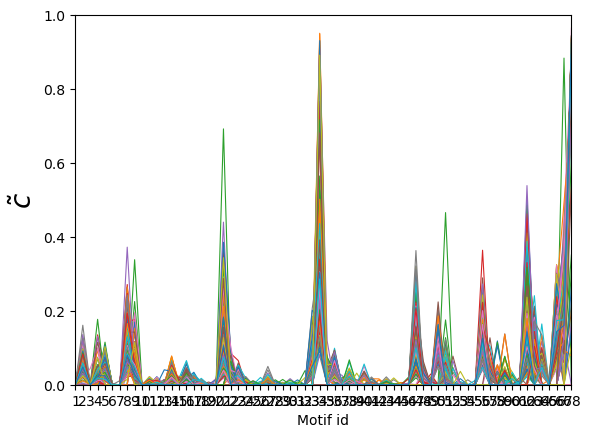

In [15]:
import pickle as cp
import pickle as pk
from copy import copy
folder='human_brains'
queriesA=get_queries_S(folder,'AU6lad')
queriesH=get_queries_S(folder,'HU6lad')
MM=[]
ct=0
SNO={}
Mfile='Umotifs6'
th=open(Mfile,'rb')
D5=pk.load(th,encoding='bytes')
th.close()
for m in D5:
        orbtype=m.new_vertex_property('int')
        m.vp.orbtype=orbtype
        orbtc=m.new_gp("vector<int>",val=[0,0,0])
        m.gp.orbtc=orbtc
        for v in m.vertices():
            if v.out_degree() and v.in_degree():
                m.gp.orbtc[2]+=1
                m.vp.orbtype[v]=2
            elif v.out_degree():
                m.vp.orbtype[v]=0
                m.gp.orbtc[0]+=1
            elif v.in_degree():
                m.vp.orbtype[v]=1
                m.gp.orbtc[1]+=1
queries=[]
for i in range(len(queriesA)):
    th=open(queriesA[i],'rb')
    CA=pk.load(th)
    th.close()
    th=open(queriesH[i],'rb')
    CH=pk.load(th)
    th.close()
    if SIGMAvmA(CA,D5)<SIGMAvmA(CH,D5): 
        queries.append(queriesA[i])
    else: 
        queries.append(queriesH[i])
for q in queries:
    th=open(q,'rb')
    ct+=1
    C=pk.load(th)
    th.close()
    vm=C[0]
    m=C[1]
    g=vmtoG(vm,m)
    oivp = g.new_vertex_property("int",vals=g.vertex_index.copy())
    g.vp.OI=oivp
    cove=g.new_edge_property("bool",val=True)
    g.ep.covered=cove
    g.set_edge_filter(g.ep.covered)
    vorder = g.new_vertex_property("int")
    g.vp.vorder=vorder
    ed=g.new_graph_property("int",val=g.num_edges())
    g.gp.E=ed
    S0=SIGMAvmA(C,D5)
    print(q,S0)
    SNO[q]=S0
    for mm in m:
        if not sum([isomorphism(mm,t) for t in MM]):
            MM.append(mm)
            print(len(MM),ct)
print('DONE')
MM.sort(key=lambda d: d.num_edges())
D={q:[0]*len(MM) for q in queries}
S={q:[0]*(len(MM)-1) for q in queries}
for q in queries:
    th=open(q,'rb')
    C=cp.load(th)
    th.close()
    s=sigproA(C,D5)
    for i in range(len(MM)):
        for m in C[1]:
            if isomorphism(m,MM[i]):
                D[q][i]=1
        for l in range(len(s)):
            if isomorphism(s[l][0],MM[i]):
                S[q][i-1]=s[l][1]
        
from graph_tool.draw import graph_draw
print(len(MM))
mfolder=folder+'-AHU6'
os.mkdir(mfolder)
i=0
for m in MM:
    colors=['r','b','c','g','m','y','k','w']
    vh=m.new_vp('int',m.gp.orbmem)
    m.vp.vh=vh
    vc=m.new_vp('string')
    m.vp.vc=vc
    t=0
    for v in m.vertices():
        m.vp.vc[v]=colors[m.gp.orbmem[t]]
        t+=1  
    graph_draw(m,vertex_fill_color=m.vp.vc,inline=True,output=mfolder+'/M'+str(i)+'.pdf')
    i+=1
import matplotlib.pyplot as plt
plt.axes().set_aspect('equal')
plt.close()
plt.clf()
plt.axis([1,len(MM)-1,0,1])
plt.ylabel(r'$\tilde{c}$',fontsize=20)
plt.xlabel('Motif id')
locs, labels = plt.xticks()
plt.xticks( range(1,(len(MM))) )
for k in queries:
    plt.plot(range(1,(len(MM))),S[k]/np.sqrt(sum([i**2 for i in S[k]])),label=k.split('/')[-1][:2],linewidth=0.8)
#plt.legend()
plt.savefig(folder+'AHU6_A.pdf')
f=open(folder+'AHU6_Asig','wb')
pk.dump(S,f)
f.close()

#plt.legend(loc=6)
#plt.show()
print(SNO)

In [14]:
queriesA=get_queries_S(folder,'AU6lad')
queriesH=get_queries_S(folder,'HU6lad')
len(queriesA),len(queriesH)
for i in range(len(queriesA)):
    if queriesA[i][:-6]!=queriesH[i][:-6]:
        print(queriesA[i])

human_brains/BNU1_0025864_1_DTI_DS00446AU8lad 14635.388090605818
1 1
2 1
3 1
4 1
5 1
6 1
7 1
8 1
9 1
10 1
11 1
12 1
13 1
14 1
15 1
16 1
17 1
18 1
19 1
20 1
21 1
22 1
23 1
24 1
25 1
26 1
human_brains/BNU1_0025864_2_DTI_DS00446AU8lad 13506.835410484073
27 2
28 2
29 2
30 2
31 2
32 2
33 2
34 2
35 2
36 2
37 2
38 2
39 2
40 2
41 2
42 2
43 2
44 2
45 2
46 2
human_brains/BNU1_0025865_1_DTI_DS00446AU8lad 13524.45972861159
47 3
48 3
49 3
50 3
51 3
52 3
53 3
54 3
55 3
56 3
57 3
58 3
59 3
60 3
61 3
62 3
63 3
64 3
65 3
66 3
67 3
68 3
human_brains/BNU1_0025865_2_DTI_DS00446AU8lad 13012.300626545193
69 4
70 4
71 4
72 4
73 4
74 4
75 4
76 4
77 4
78 4
79 4
80 4
81 4
82 4
83 4
84 4
human_brains/BNU1_0025866_2_DTI_DS00446AU8lad 13190.535089304114
85 5
86 5
87 5
88 5
89 5
90 5
91 5
92 5
93 5
94 5
95 5
96 5
97 5
98 5
99 5
human_brains/BNU1_0025867_1_DTI_DS00446AU8lad 13690.201551415728
100 6
101 6
102 6
103 6
104 6
105 6
106 6
107 6
108 6
109 6
110 6
111 6
112 6
human_brains/BNU1_0025867_2_DTI_DS00446AU8lad 1

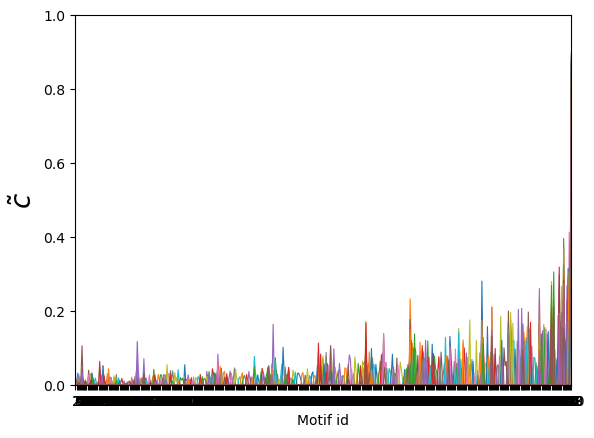

In [6]:
import pickle as cp
import pickle as pk
from copy import copy
folder='human_brains'
queries=get_queries_S(folder,'AU8lad')+get_queries_S(folder,'A8lad')
MM=[]
ct=0
SNO={}
Mfile='Umotifs8'
th=open(Mfile,'rb')
D5=pk.load(th,encoding='bytes')
th.close()
for m in D5:
        orbtype=m.new_vertex_property('int')
        m.vp.orbtype=orbtype
        orbtc=m.new_gp("vector<int>",val=[0,0,0])
        m.gp.orbtc=orbtc
        for v in m.vertices():
            if v.out_degree() and v.in_degree():
                m.gp.orbtc[2]+=1
                m.vp.orbtype[v]=2
            elif v.out_degree():
                m.vp.orbtype[v]=0
                m.gp.orbtc[0]+=1
            elif v.in_degree():
                m.vp.orbtype[v]=1
                m.gp.orbtc[1]+=1
for q in queries:
    th=open(q,'rb')
    ct+=1
    C=pk.load(th)
    th.close()
    vm=C[0]
    m=C[1]
    g=vmtoG(vm,m)
    oivp = g.new_vertex_property("int",vals=g.vertex_index.copy())
    g.vp.OI=oivp
    cove=g.new_edge_property("bool",val=True)
    g.ep.covered=cove
    g.set_edge_filter(g.ep.covered)
    vorder = g.new_vertex_property("int")
    g.vp.vorder=vorder
    ed=g.new_graph_property("int",val=g.num_edges())
    g.gp.E=ed
    S0=SIGMAvmA(C,D5)
    print(q,S0)
    SNO[q]=S0
    for mm in m:
        if not sum([isomorphism(mm,t) for t in MM]):
            MM.append(mm)
            print(len(MM),ct)
print('DONE')
MM.sort(key=lambda d: d.num_edges())
D={q:[0]*len(MM) for q in queries}
S={q:[0]*(len(MM)-1) for q in queries}
for q in queries:
    th=open(q,'rb')
    C=cp.load(th)
    th.close()
    s=sigproA(C,D5)
    for i in range(len(MM)):
        for m in C[1]:
            if isomorphism(m,MM[i]):
                D[q][i]=1
        for l in range(len(s)):
            if isomorphism(s[l][0],MM[i]):
                S[q][i-1]=s[l][1]
        
from graph_tool.draw import graph_draw
print(len(MM))
mfolder=folder+'-AU8'
os.mkdir(mfolder)
i=0
for m in MM:
    colors=['r','b','c','g','m','y','k','w']
    vh=m.new_vp('int',m.gp.orbmem)
    m.vp.vh=vh
    vc=m.new_vp('string')
    m.vp.vc=vc
    t=0
    for v in m.vertices():
        m.vp.vc[v]=colors[m.gp.orbmem[t]]
        t+=1  
    graph_draw(m,vertex_fill_color=m.vp.vc,inline=True,output=mfolder+'/M'+str(i)+'.pdf')
    i+=1
import matplotlib.pyplot as plt
plt.axes().set_aspect('equal')
plt.close()
plt.clf()
plt.axis([1,len(MM)-1,0,1])
plt.ylabel(r'$\tilde{c}$',fontsize=20)
plt.xlabel('Motif id')
locs, labels = plt.xticks()
plt.xticks( range(1,(len(MM))) )
for k in queries:
    plt.plot(range(1,(len(MM))),S[k]/np.sqrt(sum([i**2 for i in S[k]])),label=k.split('/')[-1][:2],linewidth=0.8)
#plt.legend()
plt.savefig(folder+'AU8lad_A.pdf')
f=open(folder+'AU8lad_Asig','wb')
pk.dump(S,f)
f.close()

#plt.legend(loc=6)
#plt.show()
print(SNO)

In [8]:
nS=[np.array(S[k]/np.sqrt(sum([i**2 for i in S[k]]))) for k in queries]
sim=np.zeros((len(queries),len(queries)))
for i in range(len(queries)):
    for j in range(len(queries)):
        sim[i,j]=np.dot(nS[i],nS[j])

        

AttributeError: 'numpy.ndarray' object has no attribute 'where'

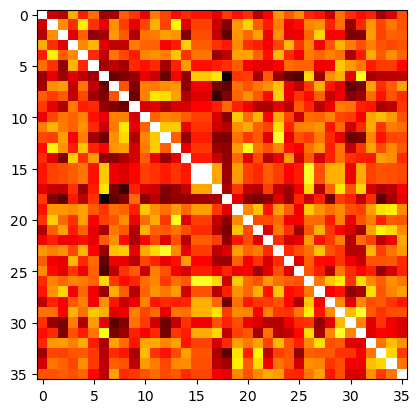

In [11]:
import matplotlib.pyplot as plt
plt.imshow(sim, cmap='hot', interpolation='nearest')
plt.show()

/var/folders/3g/9f2frgld04zbc51p0bh3bbj40000gn/T/ipykernel_33406/4167802733.py:3: RuntimeWarning: invalid value encountered in divide
  plt.plot(range(1,(len(MM))),S[k]/np.sqrt(sum([i**2 for i in S[k]])),label=k.split('/')[-1][:2],linewidth=0.8)


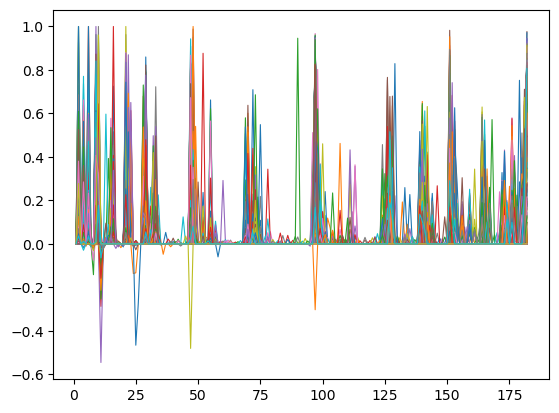

: 

In [11]:
plt.clf()
for k in queries:
    plt.plot(range(1,(len(MM))),S[k]/np.sqrt(sum([i**2 for i in S[k]])),label=k.split('/')[-1][:2],linewidth=0.8)

DiBrain/100307_.gml 20459.501443939032
1 1
2 1
3 1
4 1
5 1
6 1
7 1
8 1
9 1
10 1
11 1
12 1
13 1
14 1
DiBrain/100408_.gml 21581.78362091679
15 2
16 2
17 2
18 2
19 2
20 2
21 2
22 2
23 2
24 2
25 2
26 2
27 2
DiBrain/101006_.gml 21934.0737553965
28 3
29 3
30 3
31 3
32 3
33 3
34 3
35 3
36 3
37 3
DiBrain/101107_.gml 20493.068942402566
38 4
39 4
40 4
41 4
42 4
DiBrain/101309_.gml 23102.711848988074
43 5
44 5
45 5
46 5
47 5
48 5
DiBrain/101410_.gml 21424.19685006835
49 6
50 6
DiBrain/101915_.gml 21907.1261958643
51 7
52 7
DiBrain/102008_.gml 20767.449657157304
53 8
54 8
55 8
56 8
DiBrain/102311_.gml 19858.80184075702
57 9
58 9
59 9
DiBrain/102816_.gml 22274.788918185404
60 10
DiBrain/103111_.gml 21224.58013809532
DiBrain/103414_.gml 20684.31422345807
61 12
62 12
DiBrain/103515_.gml 23432.396955349126
63 13
64 13
DiBrain/103818_.gml 24317.11849087864
65 14
66 14
67 14
68 14
DiBrain/104820_.gml 20615.24468174272
69 15
DiBrain/105014_.gml 23797.45003810447
70 16
DiBrain/105115_.gml 18938.7729112672

<IPython.core.display.Javascript object>


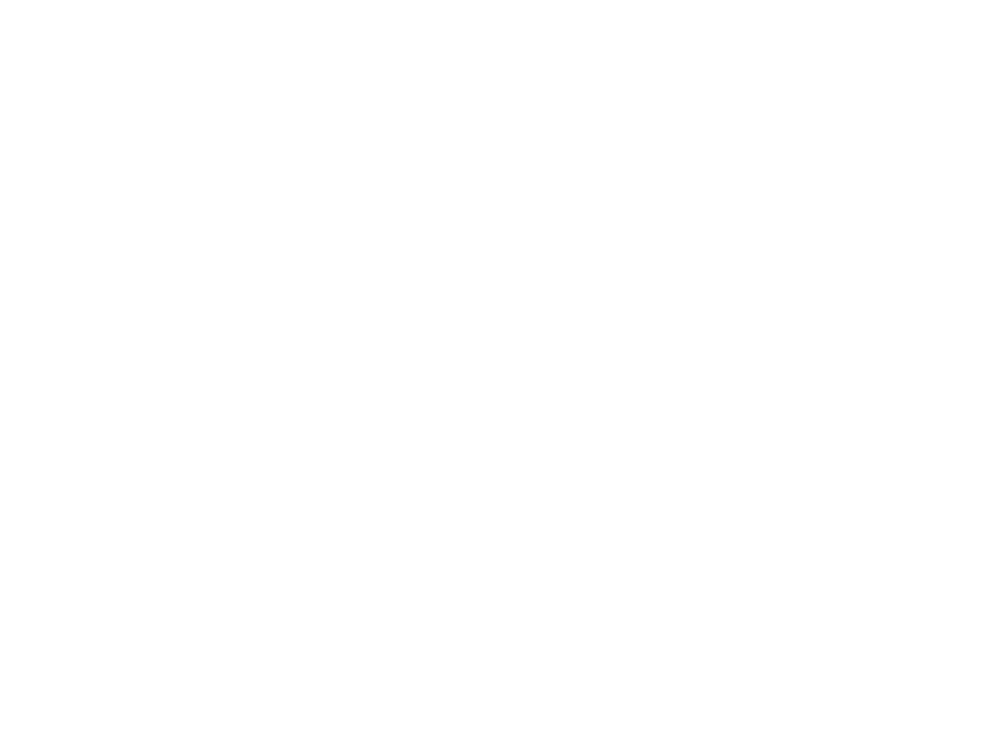

<IPython.core.display.Javascript object>


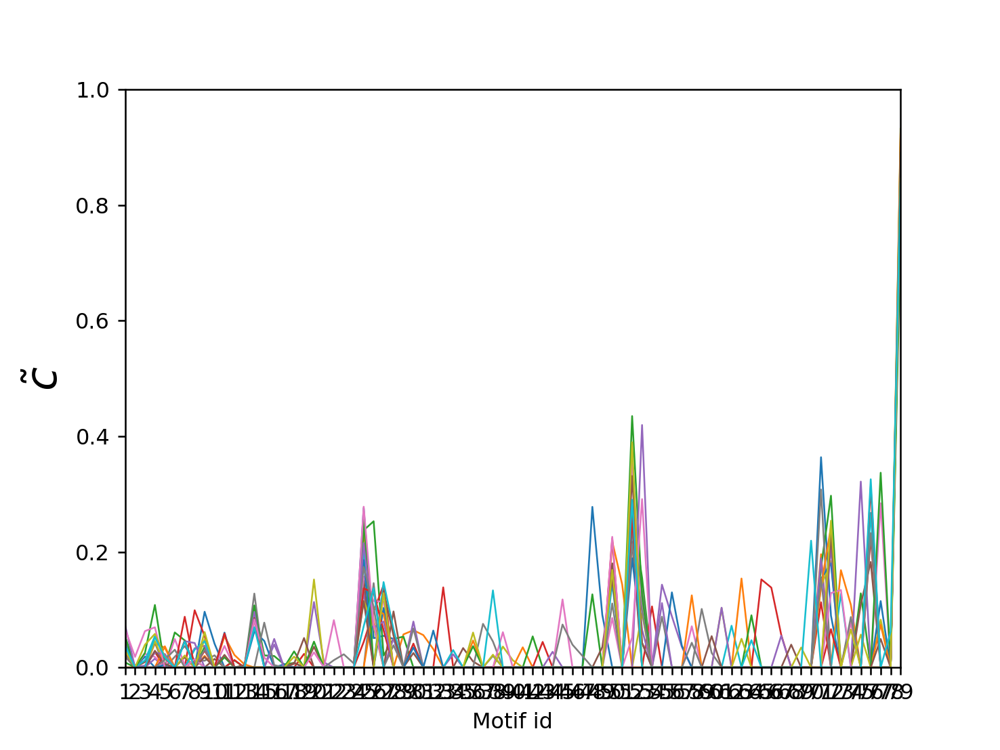

{'DiBrain/100307_.gml': 20459.501443939032, 'DiBrain/100408_.gml': 21581.78362091679, 'DiBrain/101006_.gml': 21934.0737553965, 'DiBrain/101107_.gml': 20493.068942402566, 'DiBrain/101309_.gml': 23102.711848988074, 'DiBrain/101410_.gml': 21424.19685006835, 'DiBrain/101915_.gml': 21907.1261958643, 'DiBrain/102008_.gml': 20767.449657157304, 'DiBrain/102311_.gml': 19858.80184075702, 'DiBrain/102816_.gml': 22274.788918185404, 'DiBrain/103111_.gml': 21224.58013809532, 'DiBrain/103414_.gml': 20684.31422345807, 'DiBrain/103515_.gml': 23432.396955349126, 'DiBrain/103818_.gml': 24317.11849087864, 'DiBrain/104820_.gml': 20615.24468174272, 'DiBrain/105014_.gml': 23797.45003810447, 'DiBrain/105115_.gml': 18938.772911267286, 'DiBrain/105216_.gml': 23088.775124469954, 'DiBrain/106016_.gml': 21397.886973997054, 'DiBrain/106319_.gml': 19854.725166726374}


In [47]:
from copy import copy
folder='DiBrain'
queries=get_queries(folder)[:20]
MM=[]
ct=0
SNO={}
Mfile='BDmotifs5'
th=open(Mfile,'rb')
D5=pk.load(th,encoding='bytes')
th.close()
for m in D5:
        orbtype=m.new_vertex_property('int')
        m.vp.orbtype=orbtype
        orbtc=m.new_gp("vector<int>",val=[0,0,0])
        m.gp.orbtc=orbtc
        for v in m.vertices():
            if v.out_degree() and v.in_degree():
                m.gp.orbtc[2]+=1
                m.vp.orbtype[v]=2
            elif v.out_degree():
                m.vp.orbtype[v]=0
                m.gp.orbtc[0]+=1
            elif v.in_degree():
                m.vp.orbtype[v]=1
                m.gp.orbtc[1]+=1
for q in queries:
    th=open(q+'DC_BDmotifs5ig','rb')
    ct+=1
    C=pk.load(th)
    th.close()
    vm=C[0]
    m=C[1]
    g=vmtoG(vm,m)
    oivp = g.new_vertex_property("int",vals=g.vertex_index.copy())
    g.vp.OI=oivp
    cove=g.new_edge_property("bool",val=True)
    g.ep.covered=cove
    g.set_edge_filter(g.ep.covered)
    vorder = g.new_vertex_property("int")
    g.vp.vorder=vorder
    ed=g.new_graph_property("int",val=g.num_edges())
    g.gp.E=ed
    S0=SIGMAvmO(C,D5)
    print(q,S0)
    SNO[q]=S0
    for mm in m:
        if not sum([isomorphism(mm,t) for t in MM]):
            MM.append(mm)
            print(len(MM),ct)
print('DONE')
MM.sort(key=lambda d: d.num_edges())
D={q:[0]*len(MM) for q in queries}
S={q:[0]*(len(MM)-1) for q in queries}
for q in queries:
    th=open(q+'DC_BDmotifs5ig','rb')
    C=cp.load(th)
    th.close()
    s=sigproDC(C,D5)
    for i in range(len(MM)):
        for m in C[1]:
            if isomorphism(m,MM[i]):
                D[q][i]=1
        for l in range(len(s)):
            if isomorphism(s[l][0],MM[i]):
                S[q][i-1]=s[l][1]
        
from graph_tool.draw import graph_draw
print(len(MM))
mfolder=folder+'-BD5O'
#os.mkdir(mfolder)
i=0
for m in MM:
    colors=['r','b','c','g','m','y','k']
    vh=m.new_vp('int',m.gp.orbmem)
    m.vp.vh=vh
    vc=m.new_vp('string')
    m.vp.vc=vc
    t=0
    for v in m.vertices():
        m.vp.vc[v]=colors[m.gp.orbmem[t]]
        t+=1  
    graph_draw(m,vertex_fill_color=m.vp.vc,inline=True,output=mfolder+'/M'+str(i)+'.pdf')
    i+=1
import matplotlib.pyplot as plt
plt.axes().set_aspect('equal')
plt.close()
plt.clf()
plt.axis([1,len(MM)-1,0,1])
plt.ylabel(r'$\tilde{c}$',fontsize=20)
plt.xlabel('Motif id')
locs, labels = plt.xticks()
plt.xticks( range(1,(len(MM))) )
for k in queries:
    plt.plot(range(1,(len(MM))),S[k]/np.sqrt(sum([i**2 for i in S[k]])),label=k.split('/')[-1][:2],linewidth=0.8)
#plt.legend()
plt.savefig(folder+'BD5O.pdf')

#plt.legend(loc=6)
#plt.show()
print(SNO)

/home/anatol/.local/lib/python3.6/site-packages/ipykernel_launcher.py:1: MatplotlibDeprecationWarning: Adding an axes using the same arguments as a previous axes currently reuses the earlier instance.  In a future version, a new instance will always be created and returned.  Meanwhile, this warning can be suppressed, and the future behavior ensured, by passing a unique label to each axes instance.
  """Entry point for launching an IPython kernel.


<IPython.core.display.Javascript object>


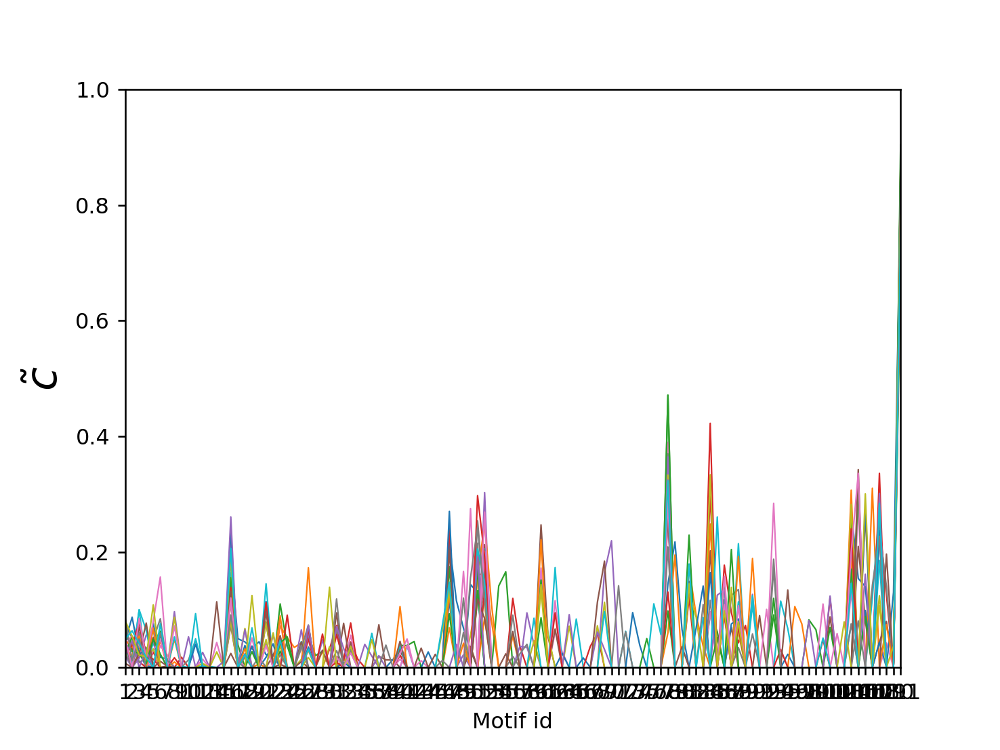

In [13]:
plt.axes().set_aspect('equal')
plt.close()
plt.clf()
plt.axis([1,len(MM)-1,0,1])
plt.ylabel(r'$\tilde{c}$',fontsize=20)
plt.xlabel('Motif id')
locs, labels = plt.xticks()
plt.xticks( range(1,(len(MM))) )
for k in queries:
    plt.plot(range(1,(len(MM))),S[k]/np.sqrt(sum([i**2 for i in S[k]])),label=k.split('/')[-1][:2],linewidth=0.7)
plt.savefig(folder+'D5DAS.pdf')

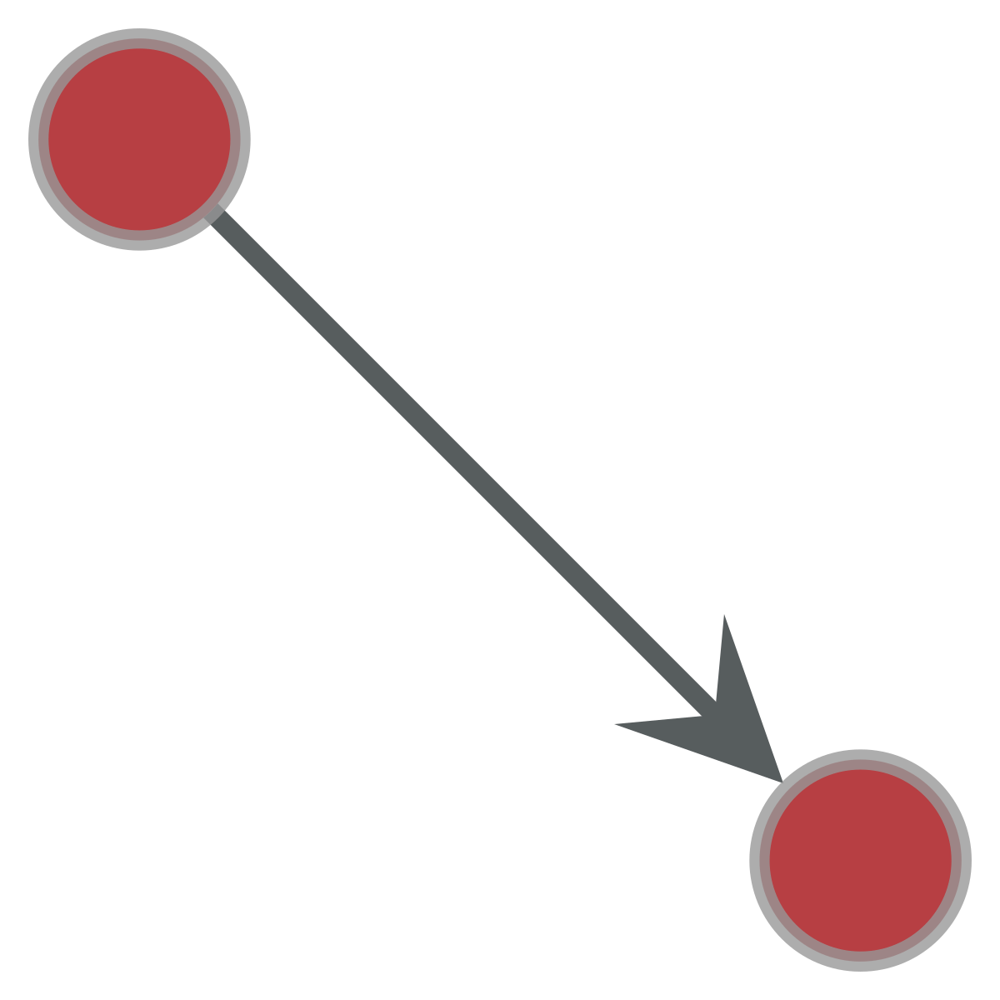

0


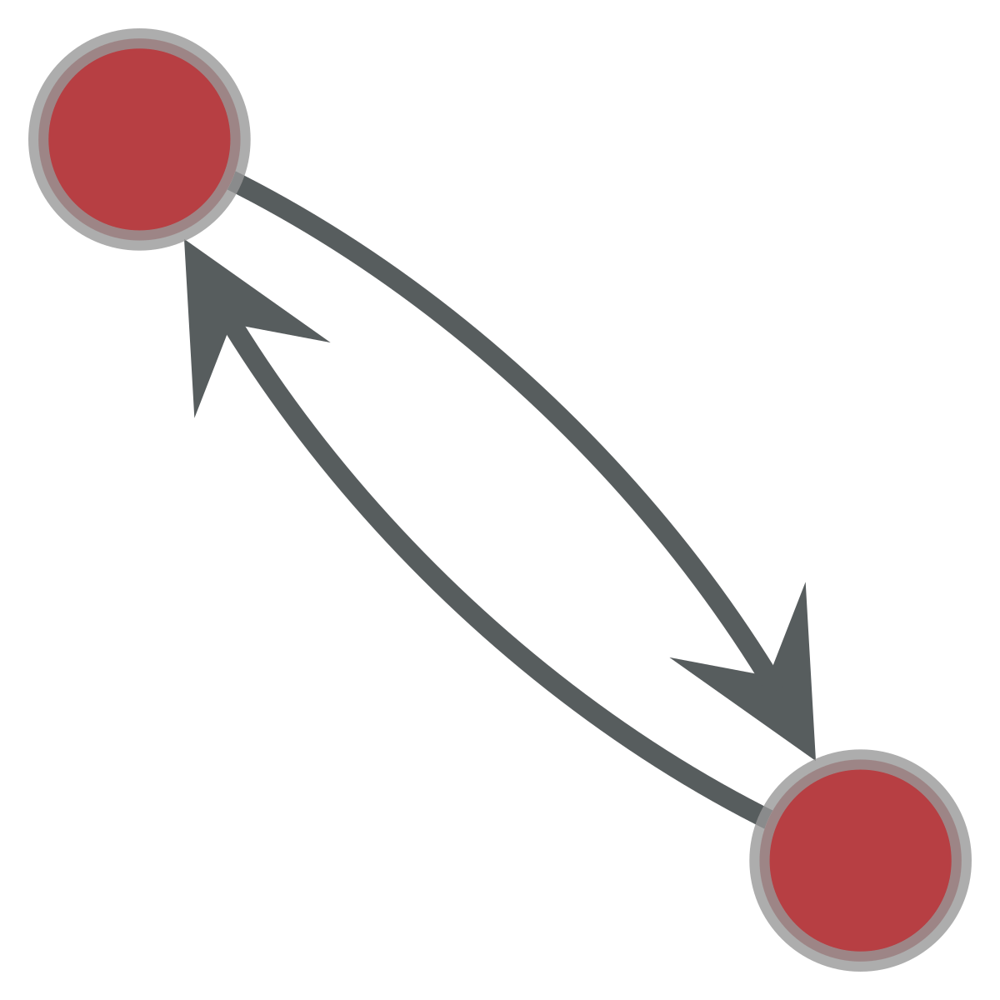

1


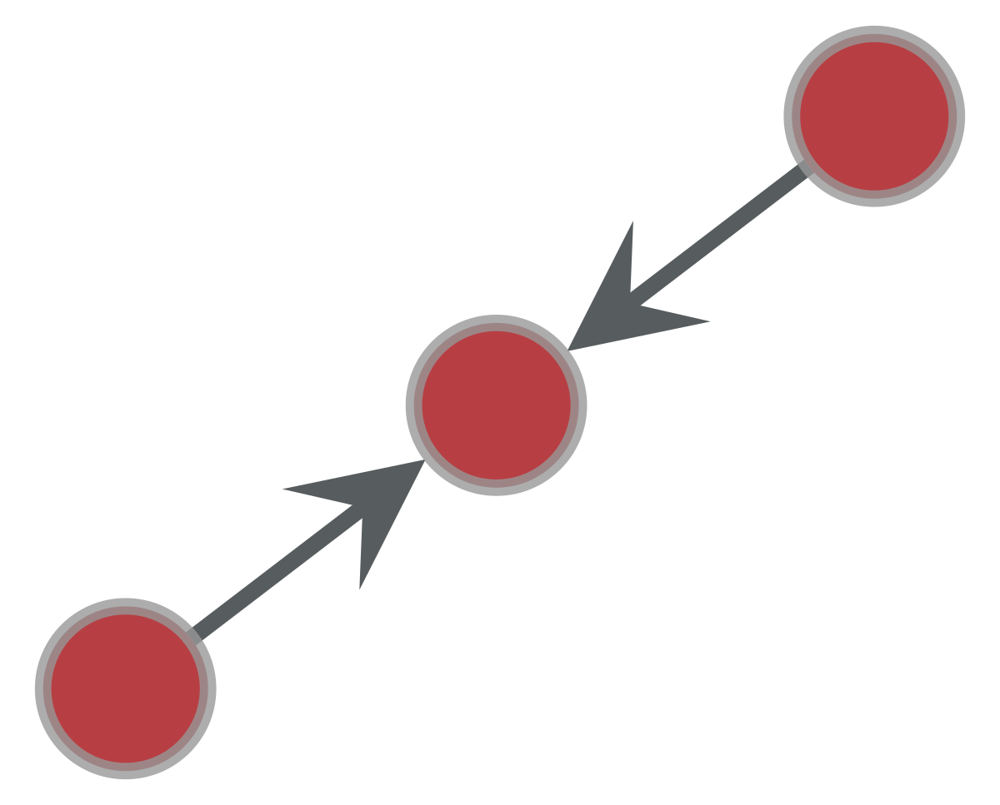

4


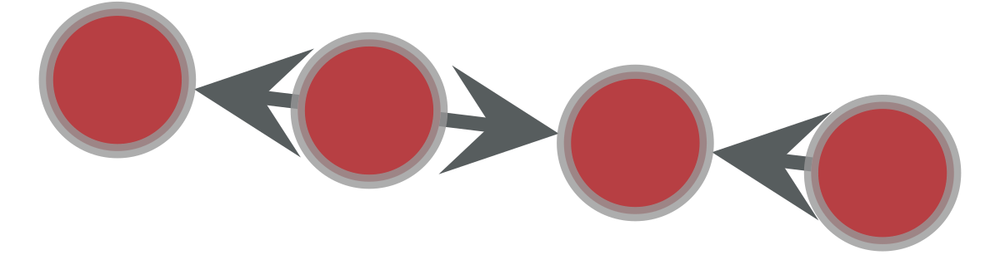

6


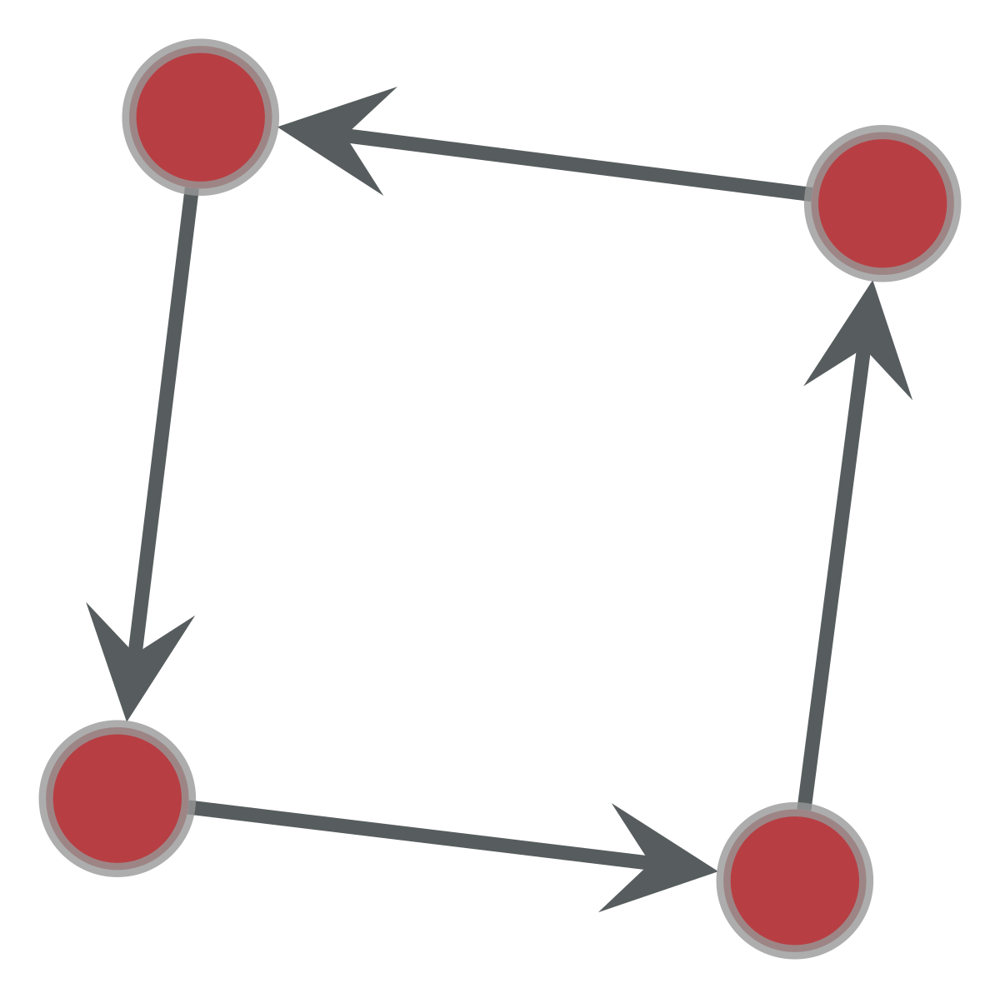

7


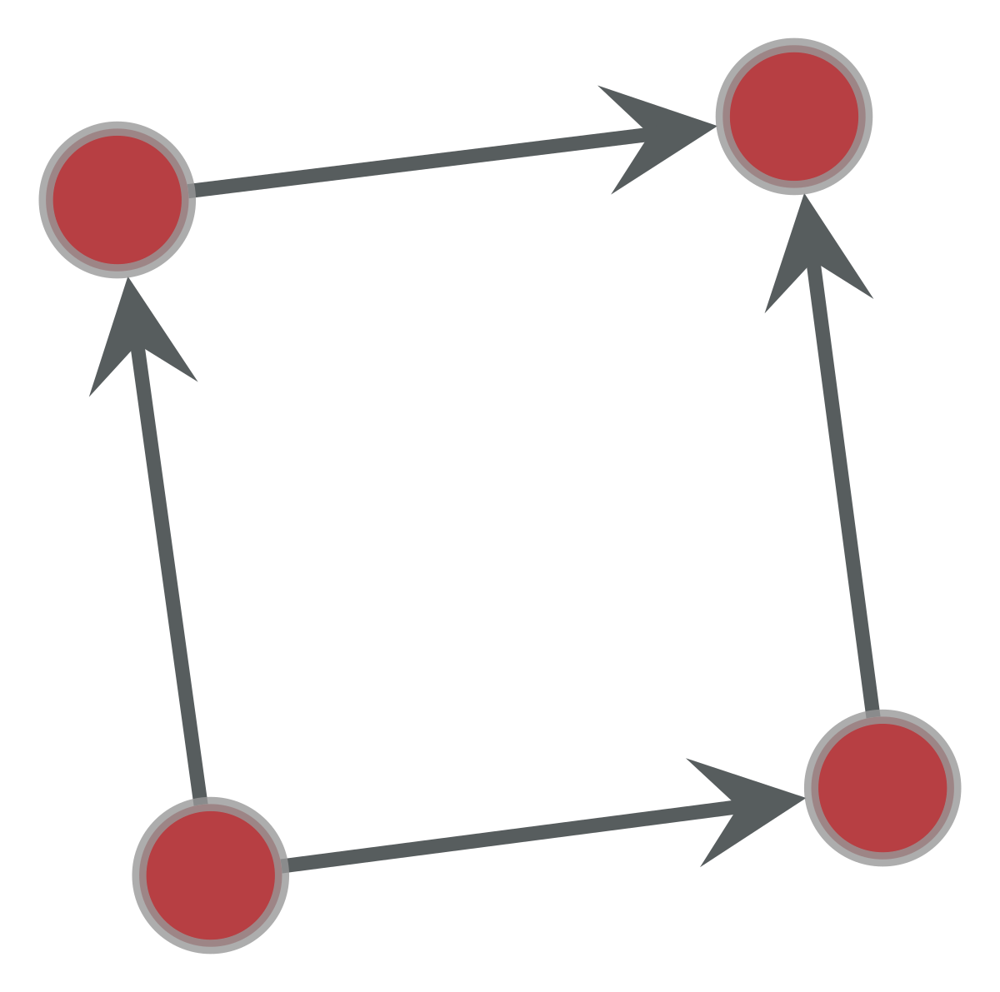

8


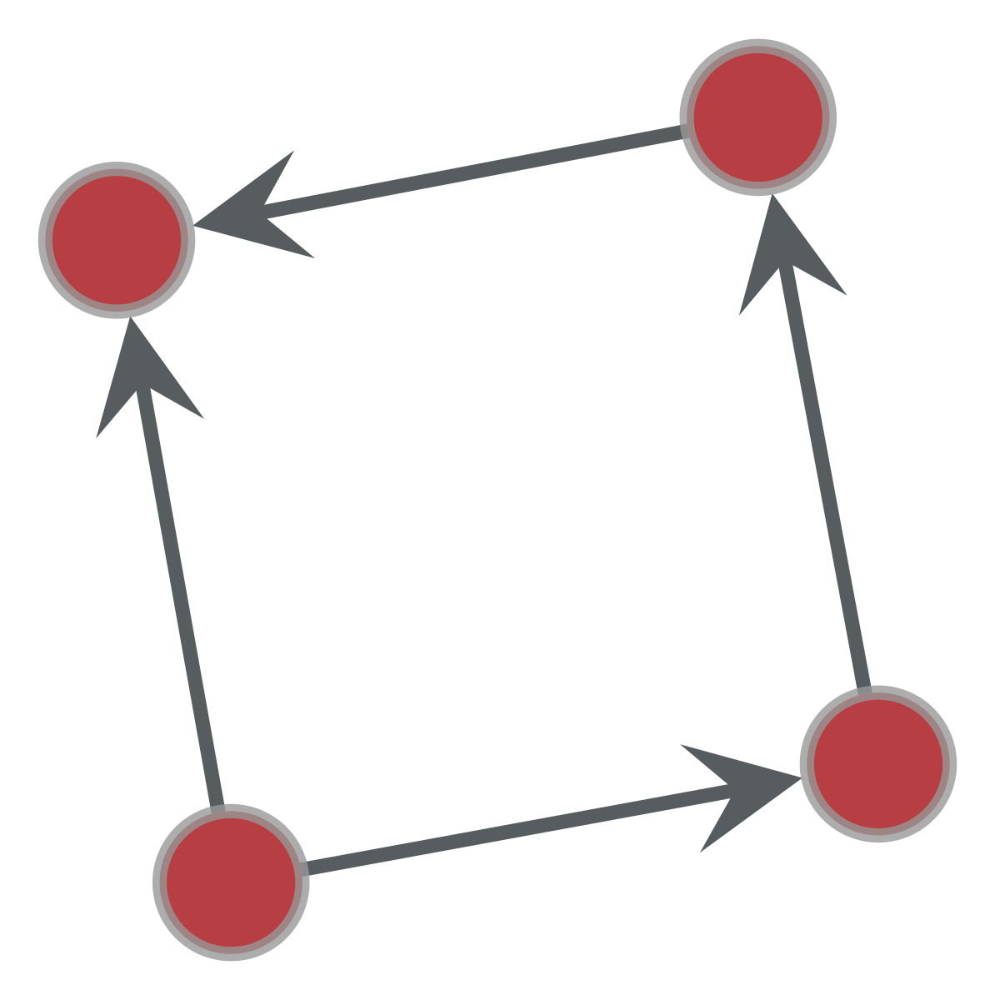

9


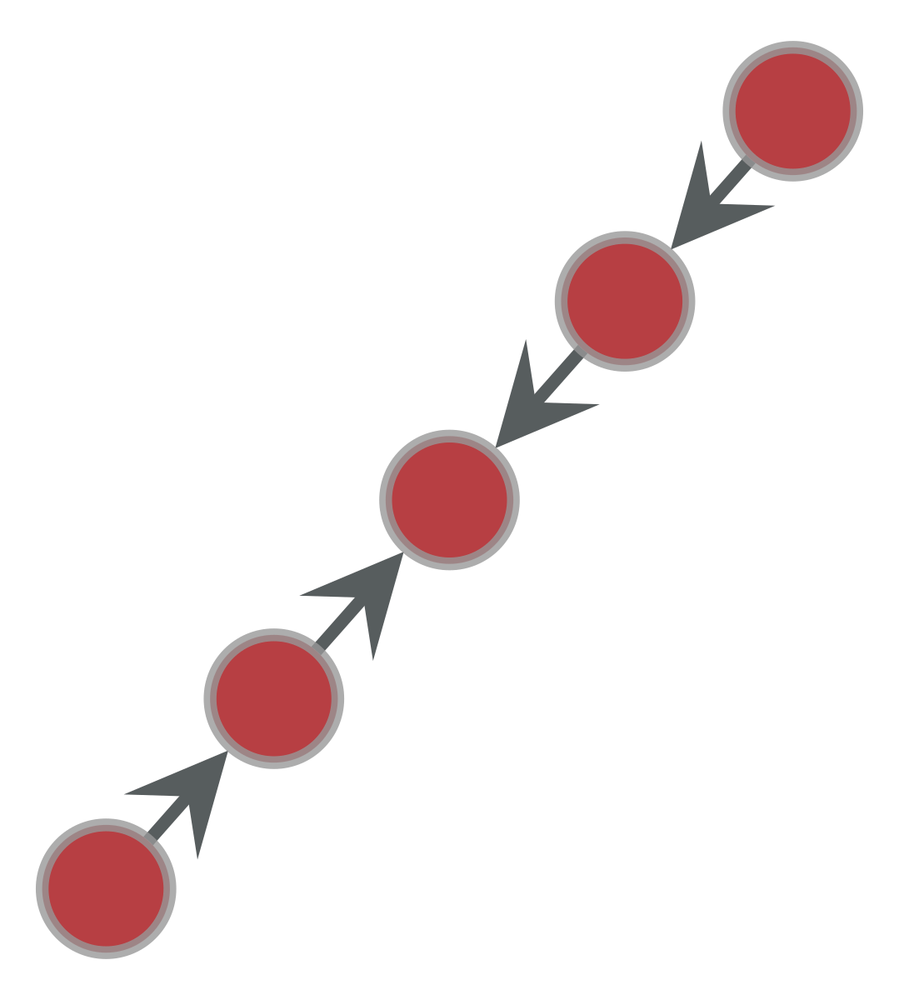

10


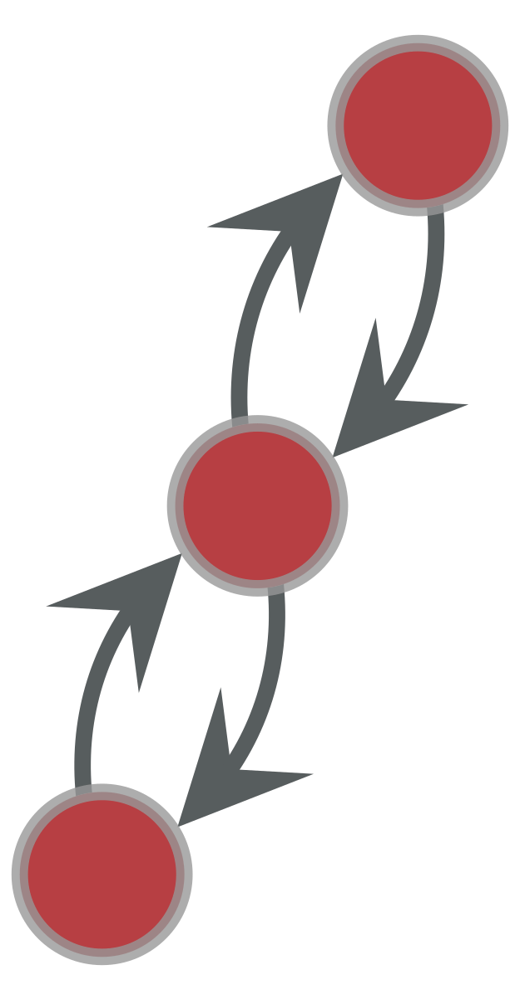

11


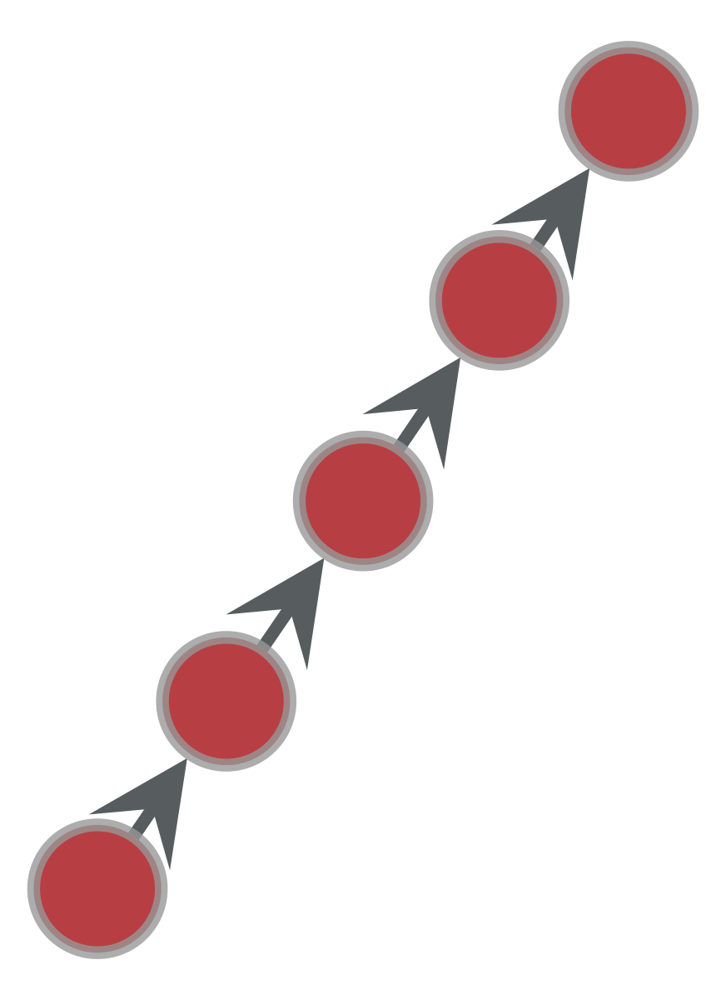

12


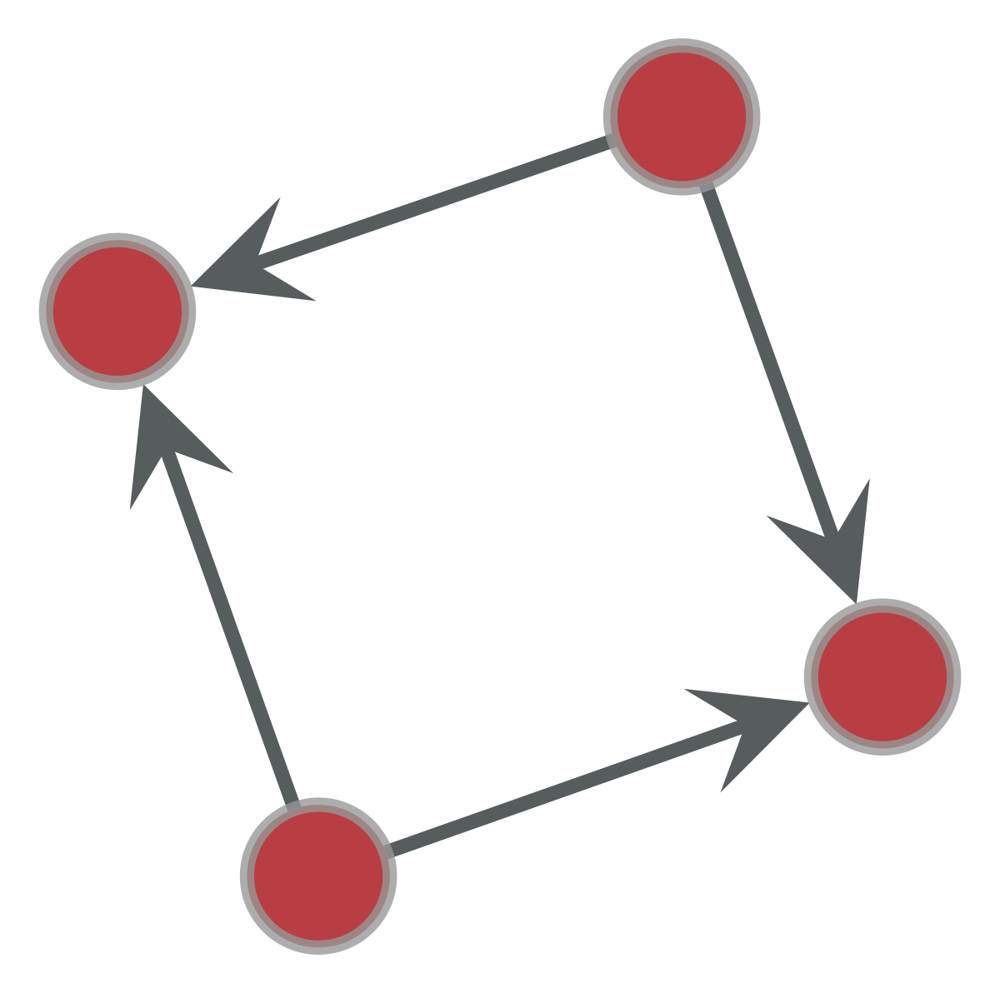

13


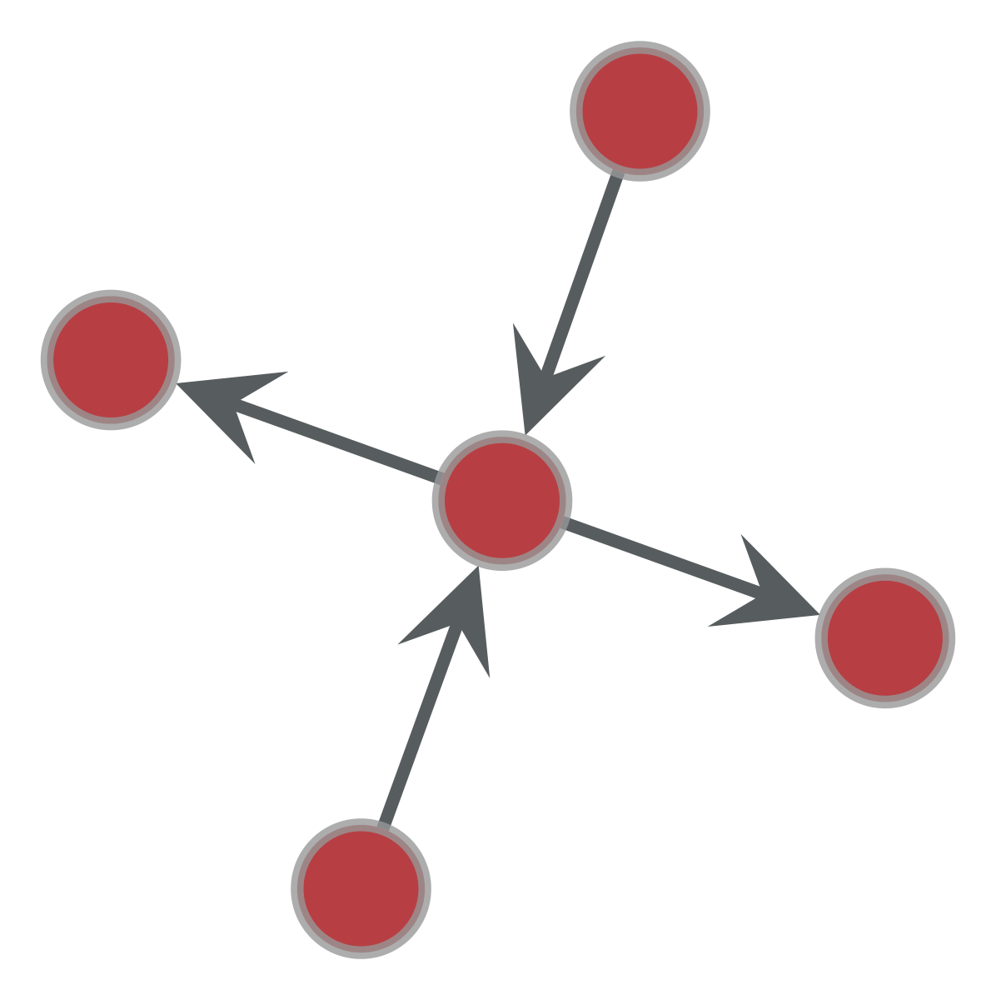

14


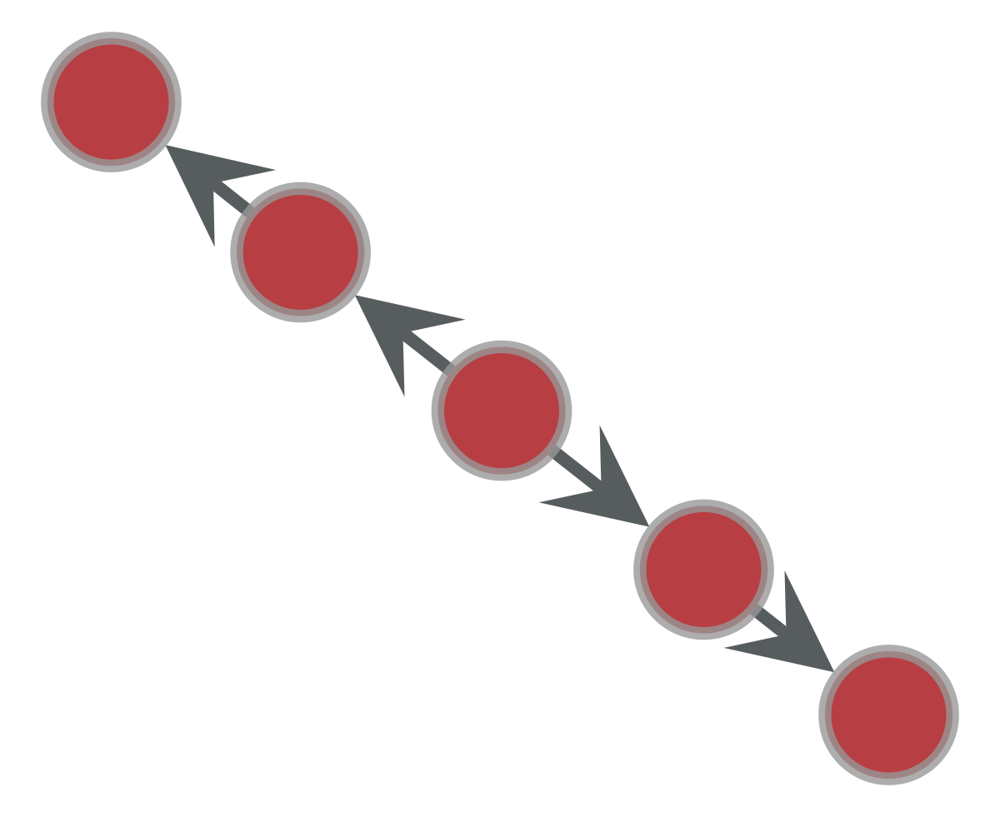

15


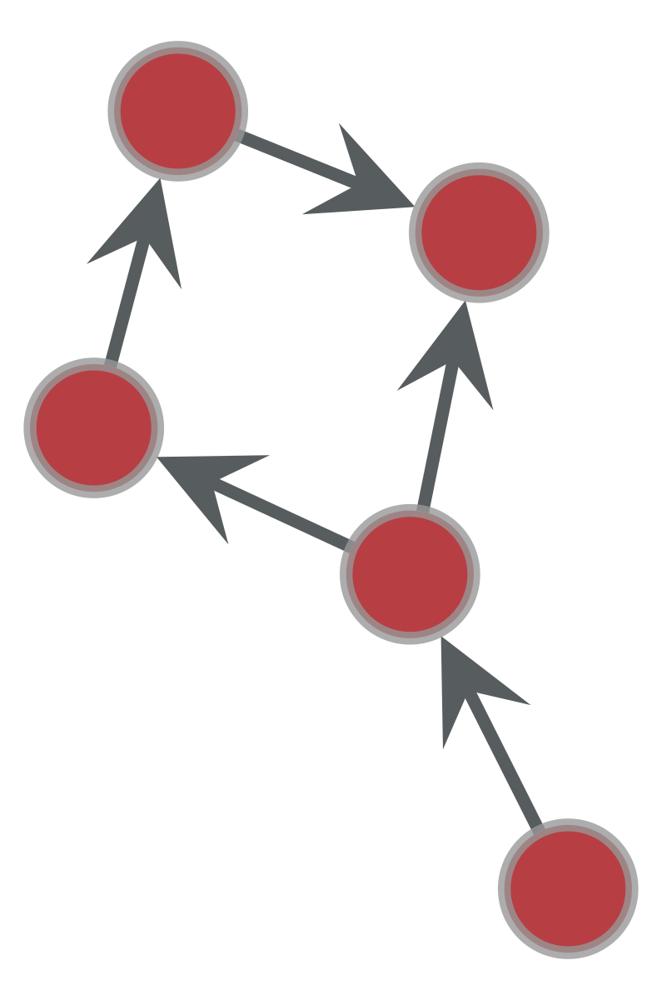

16


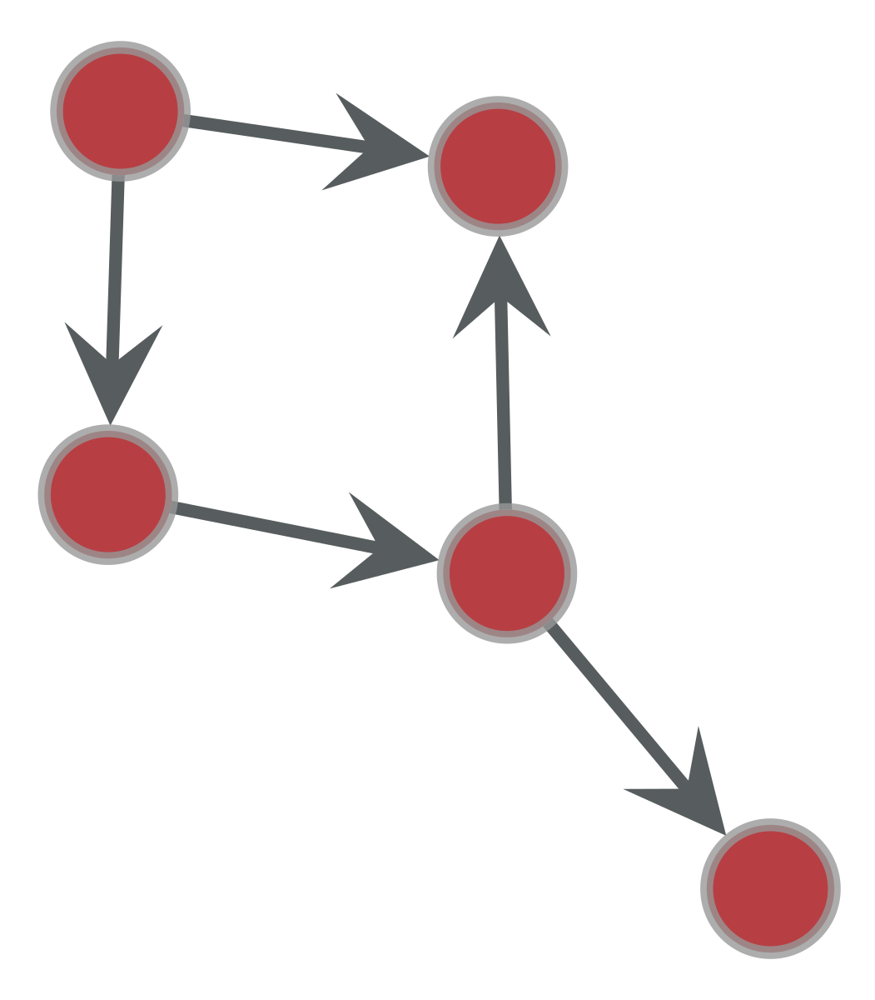

17


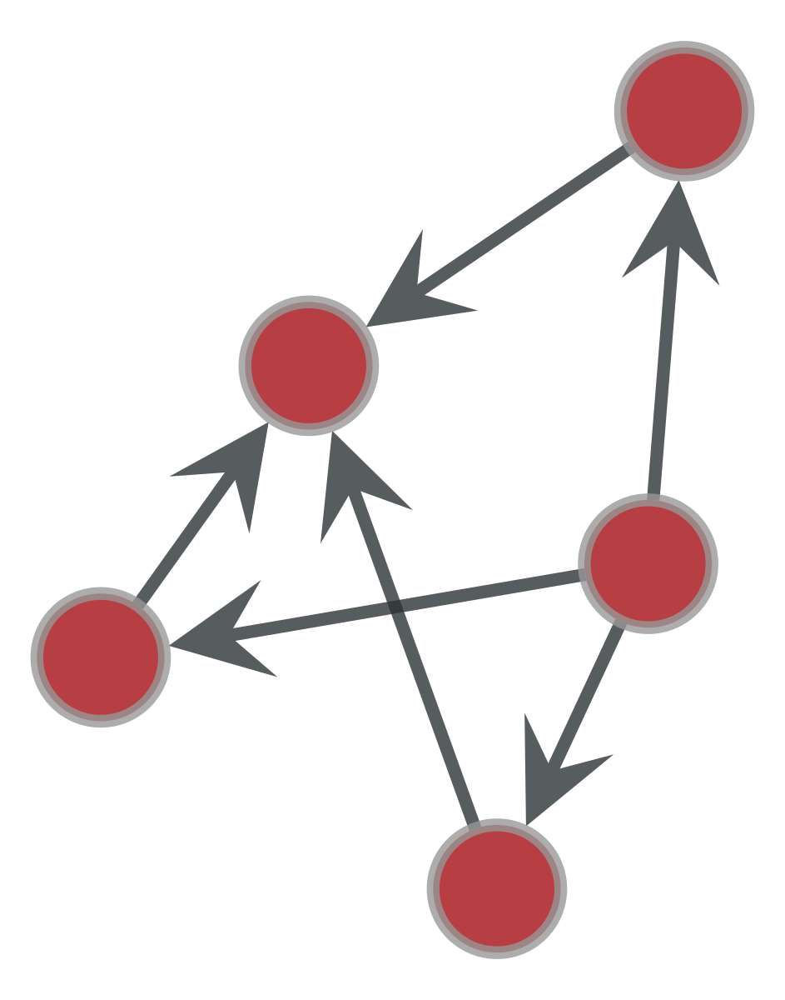

18


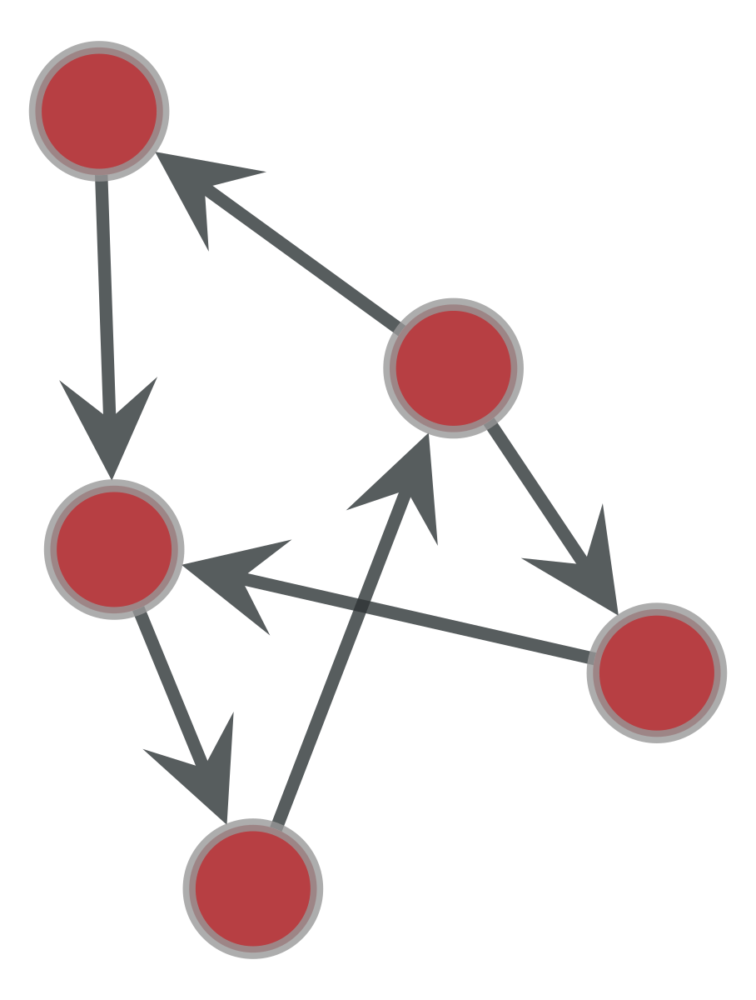

19


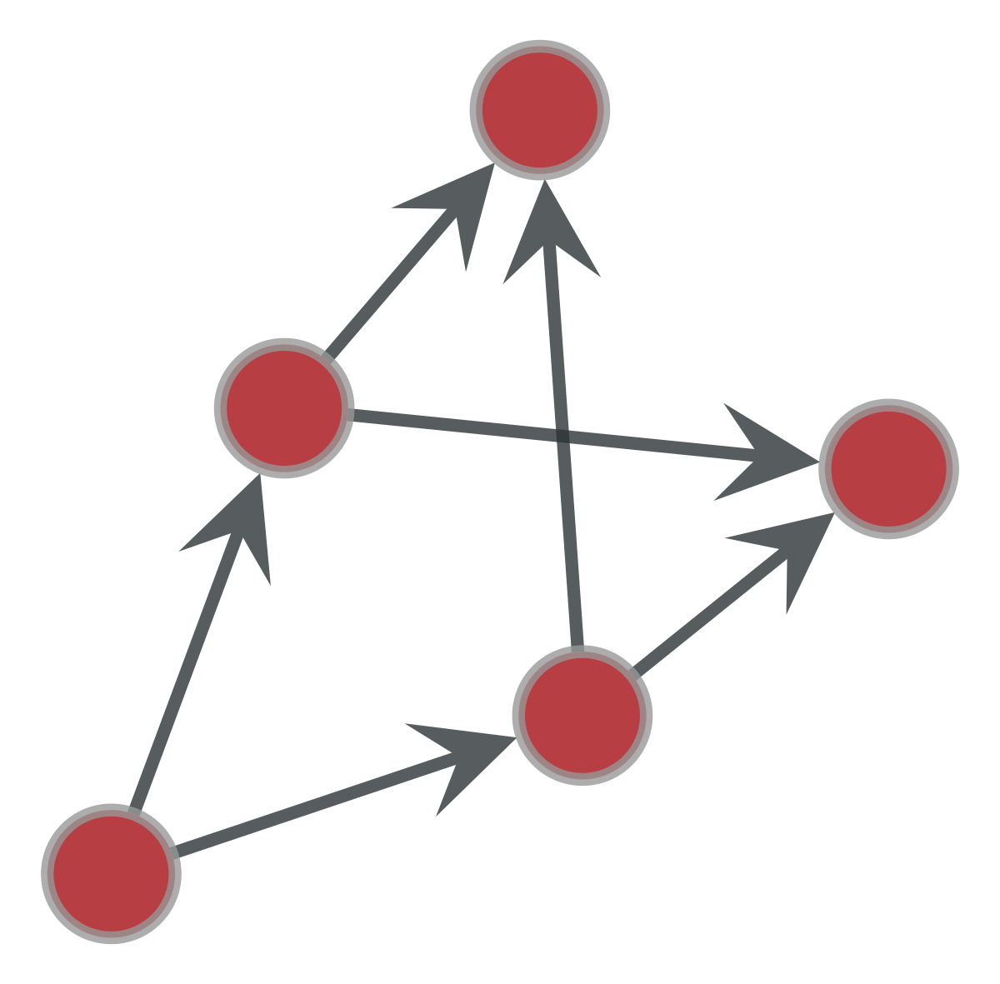

20


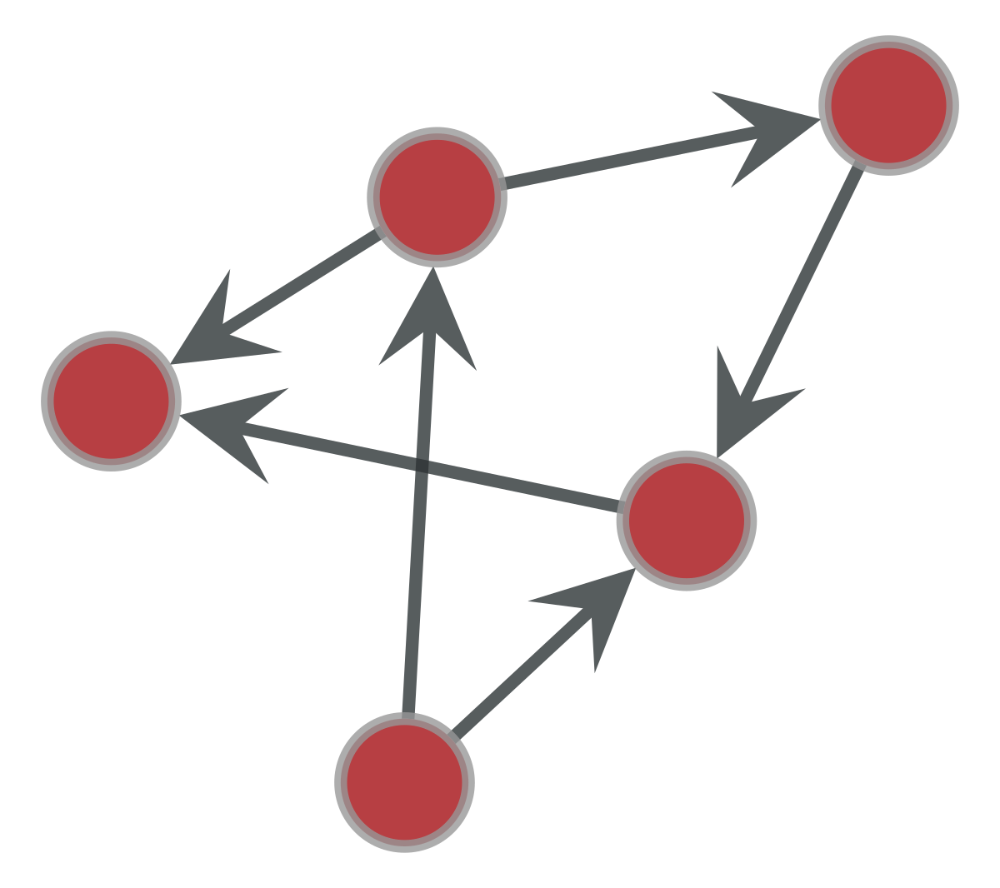

21


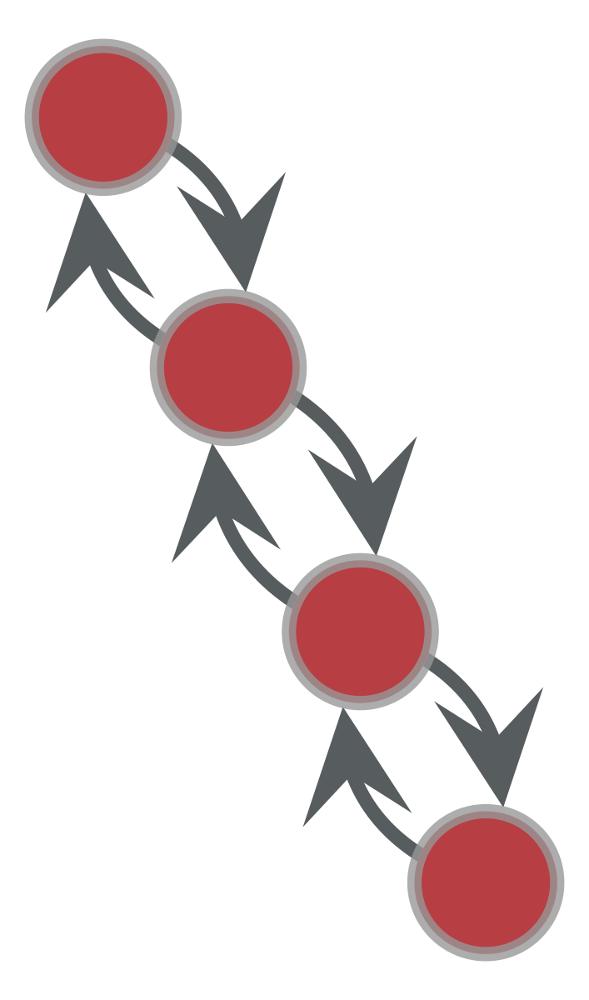

22


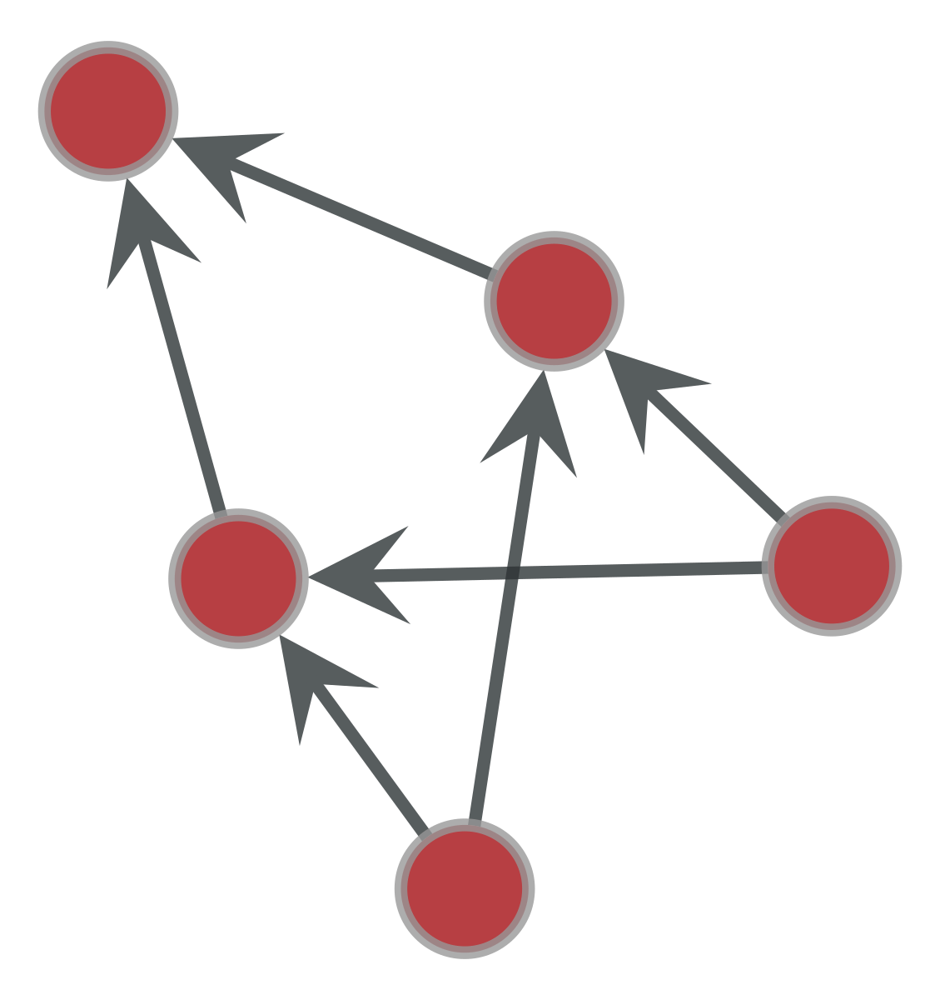

23


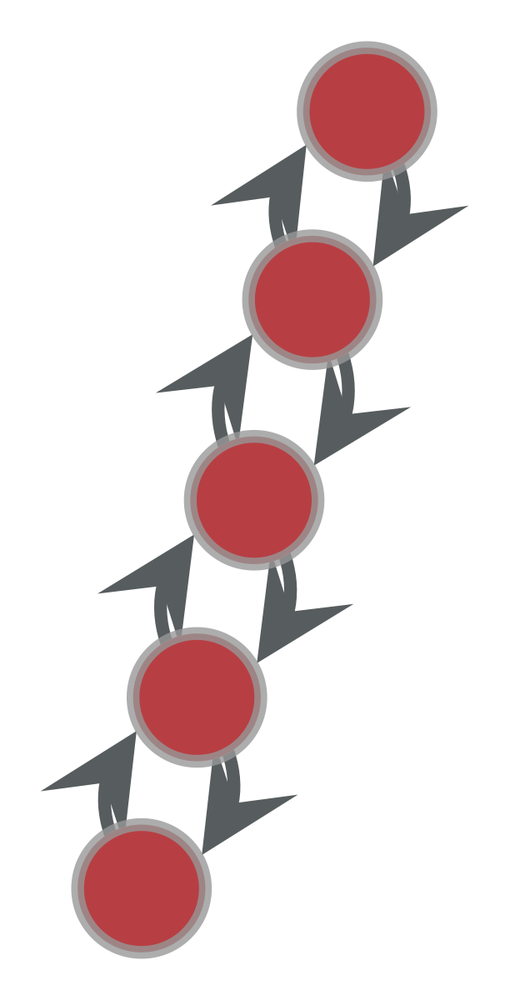

24


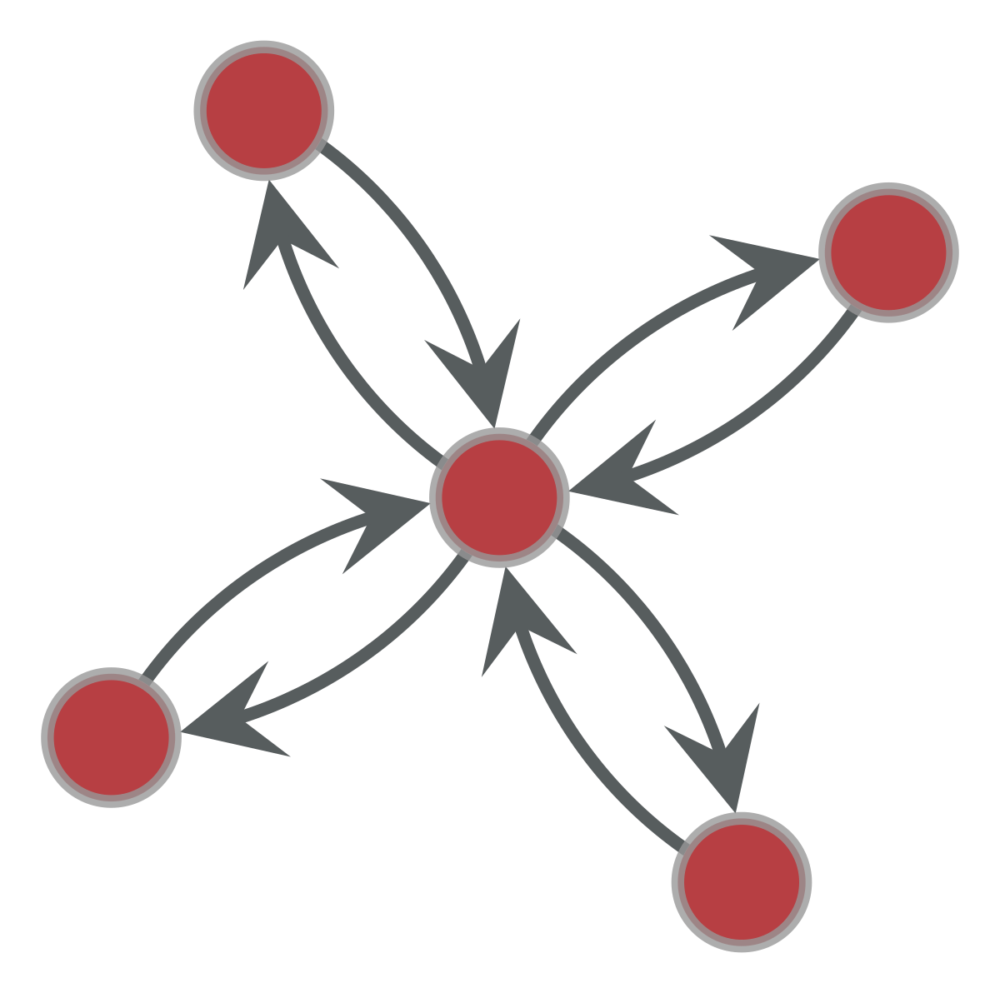

25


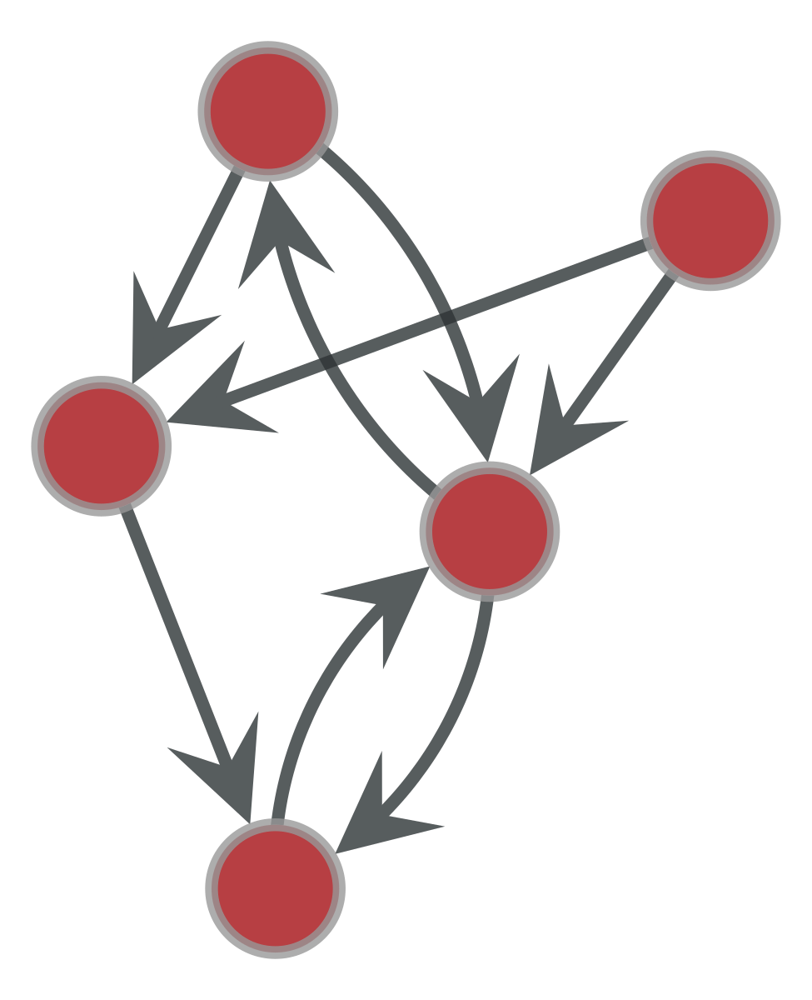

26


In [9]:
for i in ind:#range(len(MM)):
    gt.graph_draw(MM[i])
    print(i)

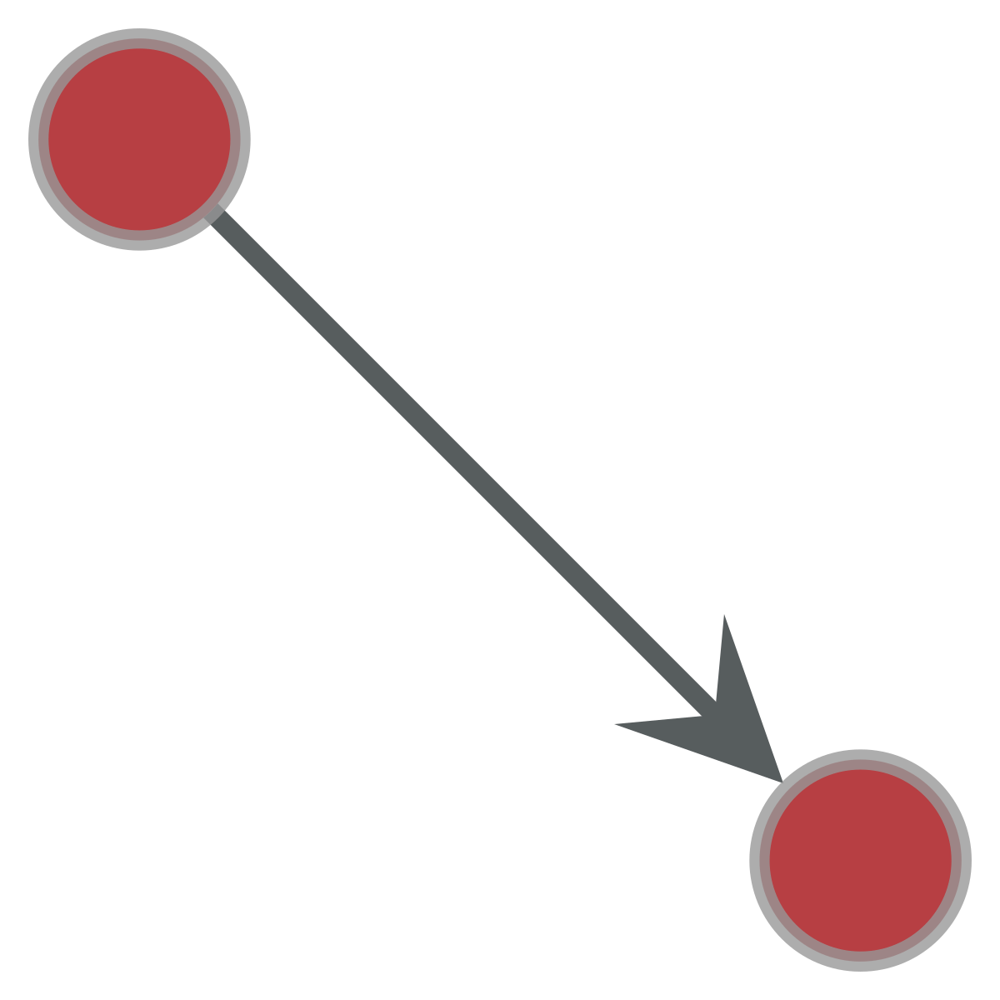

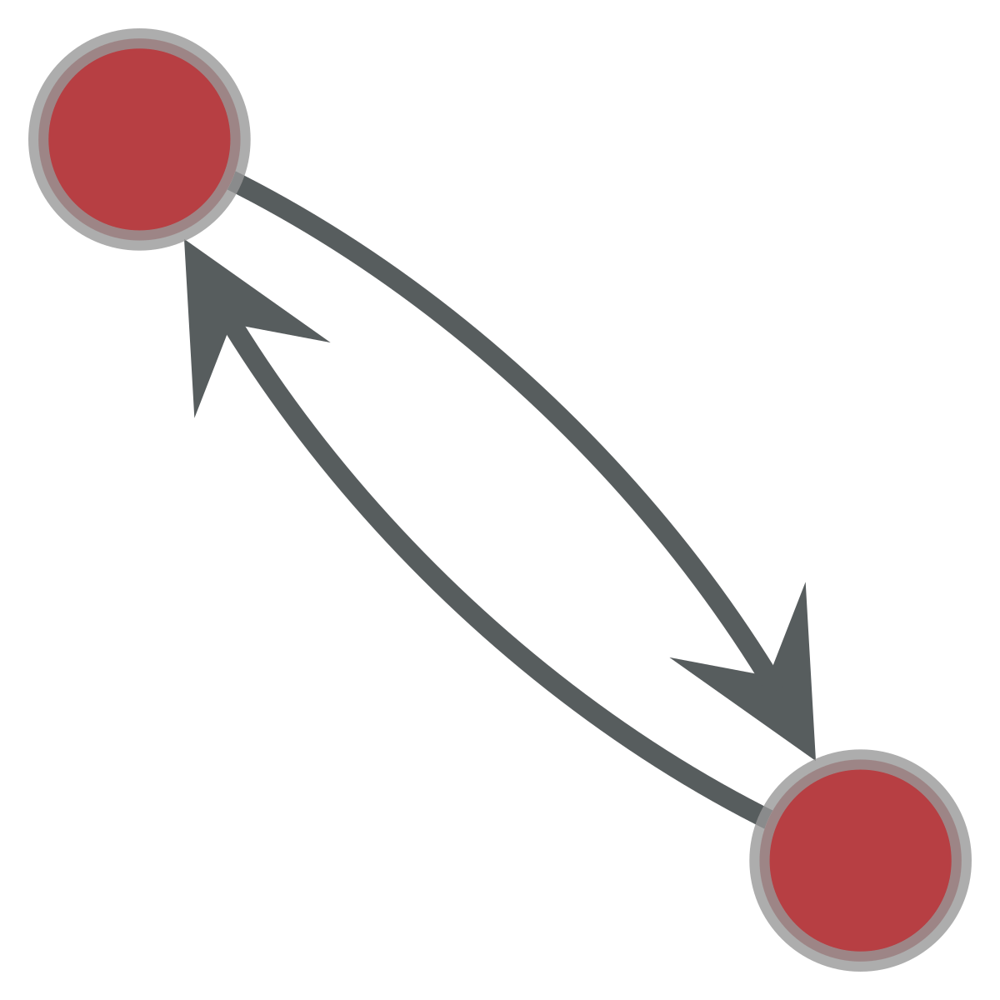

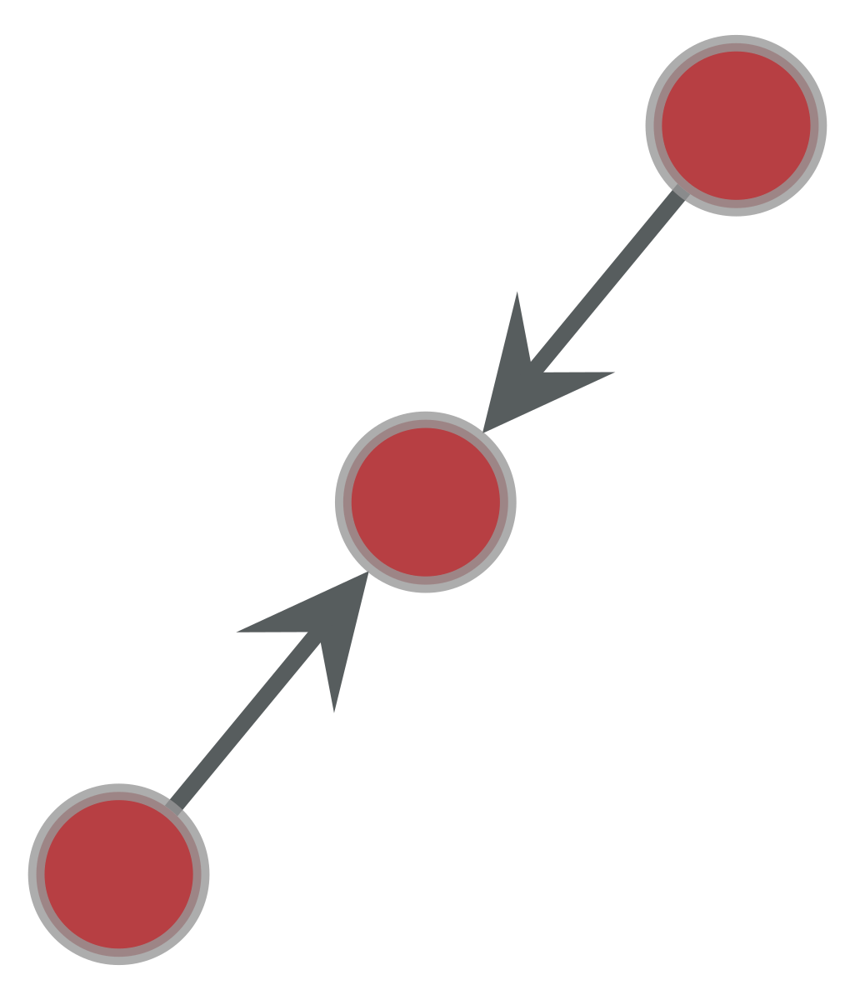

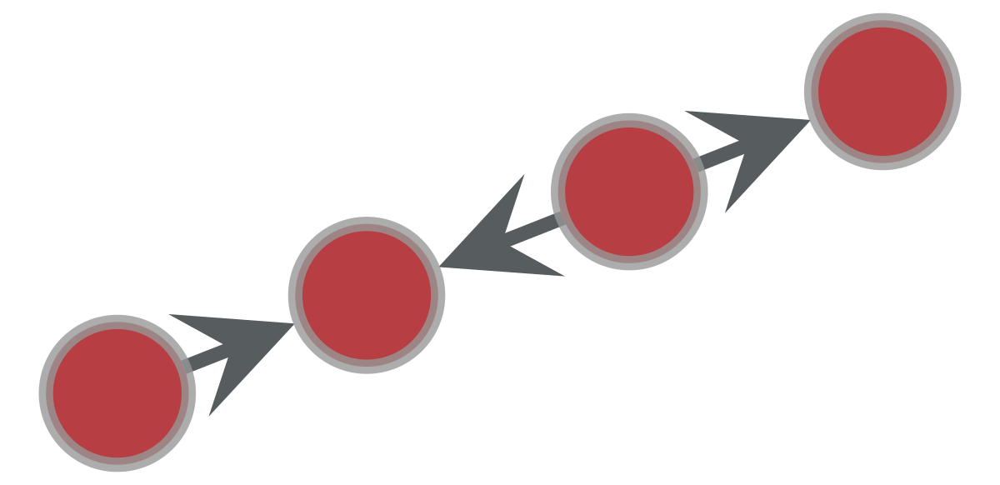

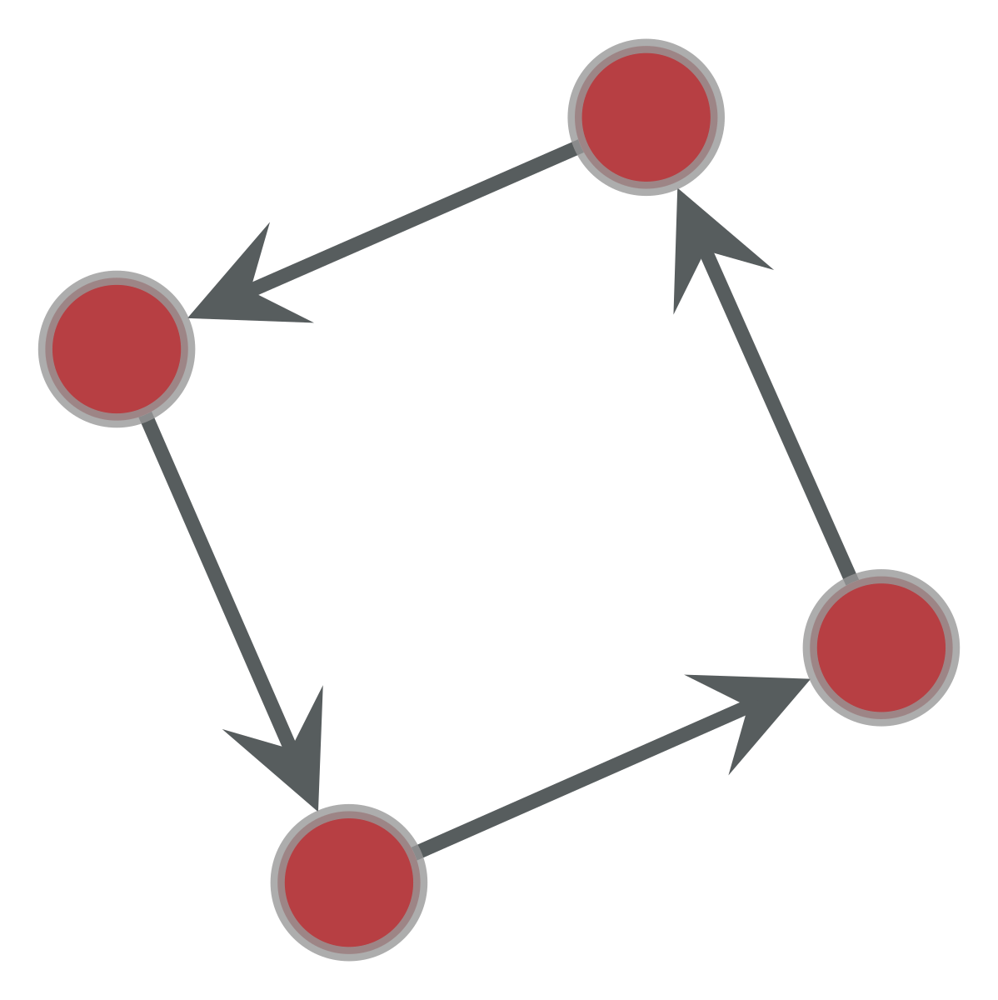

...

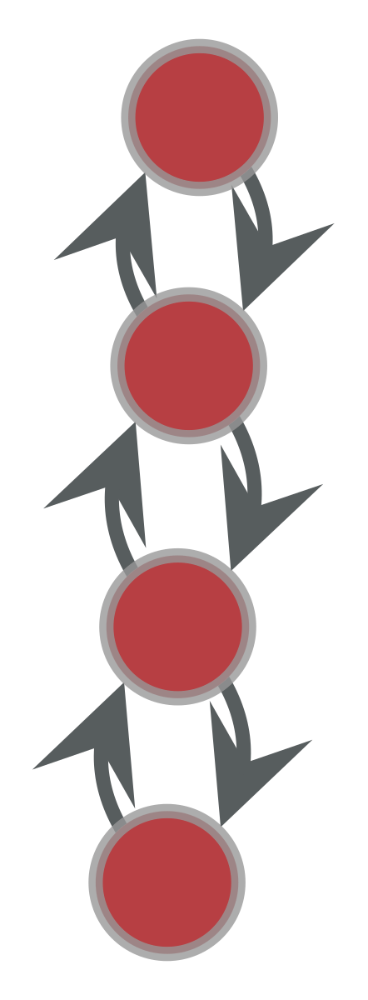

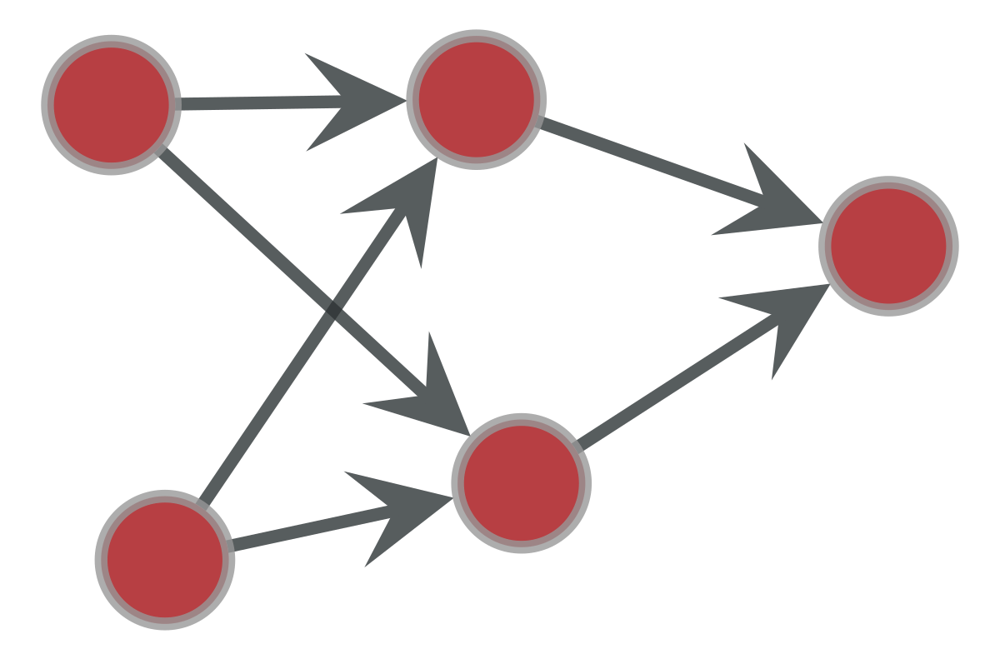

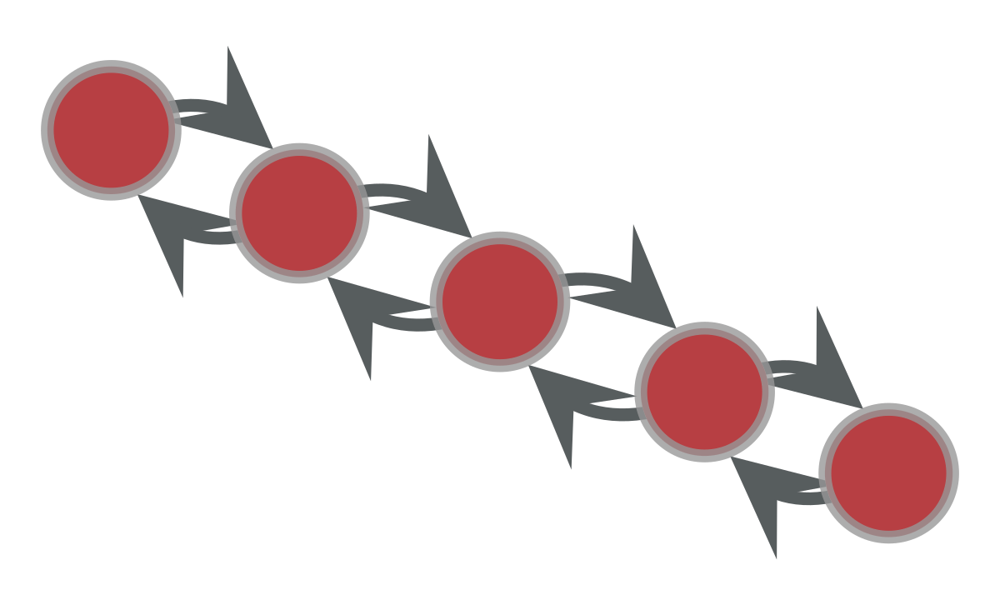

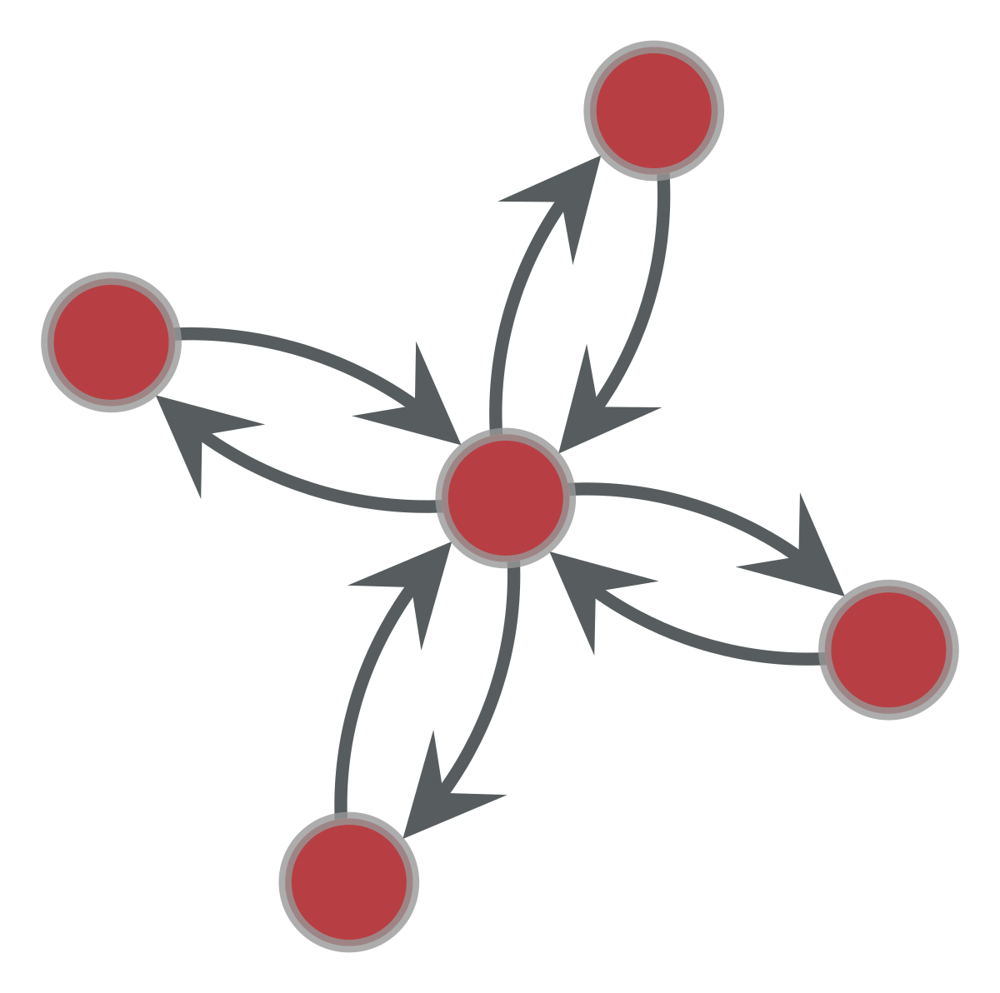

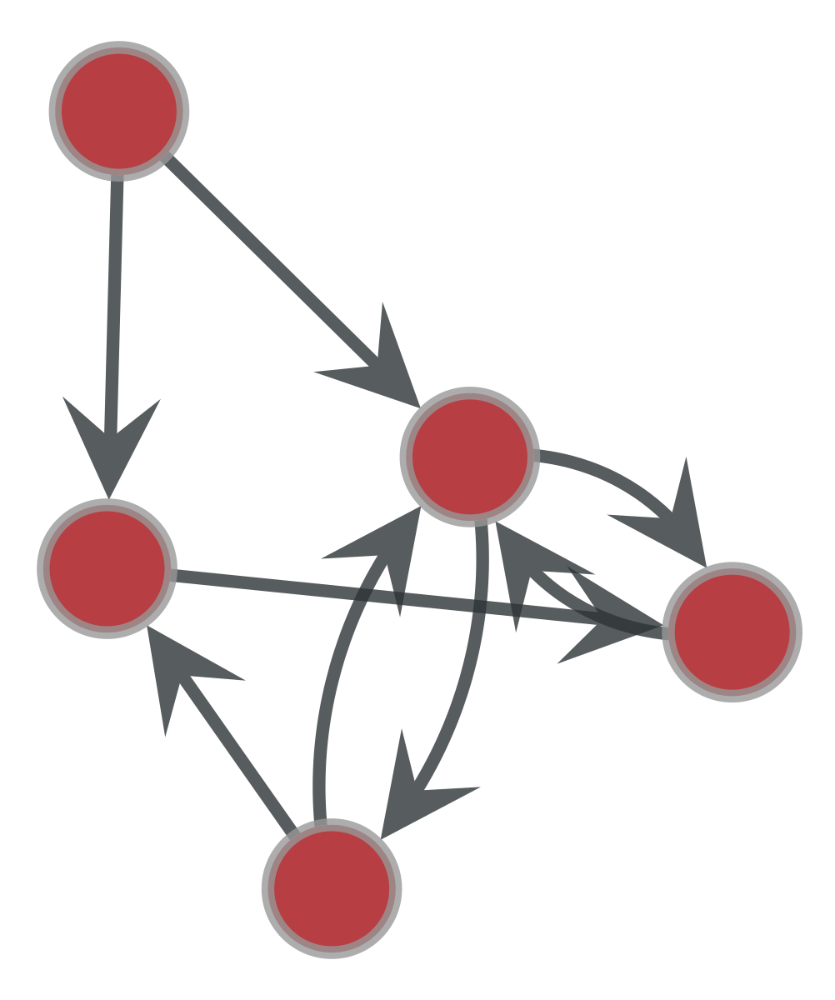

In [7]:
sn={}
ind=set()
snn={}
for k in queries:
    sn[k]=S[k]/np.sqrt(sum([i**2 for i in S[k]]))
    for i in range(len(sn[k])):
        if sn[k][i]>0.01:
            ind.add(i)
ind=list(ind)
ind.sort()
for k in queries:
    snn[k]=[sn[k][i] for i in ind]
    
for i in ind:
    gt.graph_draw(MM[i])

/home/anatol/.local/lib/python3.6/site-packages/ipykernel_launcher.py:1: MatplotlibDeprecationWarning: Adding an axes using the same arguments as a previous axes currently reuses the earlier instance.  In a future version, a new instance will always be created and returned.  Meanwhile, this warning can be suppressed, and the future behavior ensured, by passing a unique label to each axes instance.
  """Entry point for launching an IPython kernel.


<IPython.core.display.Javascript object>


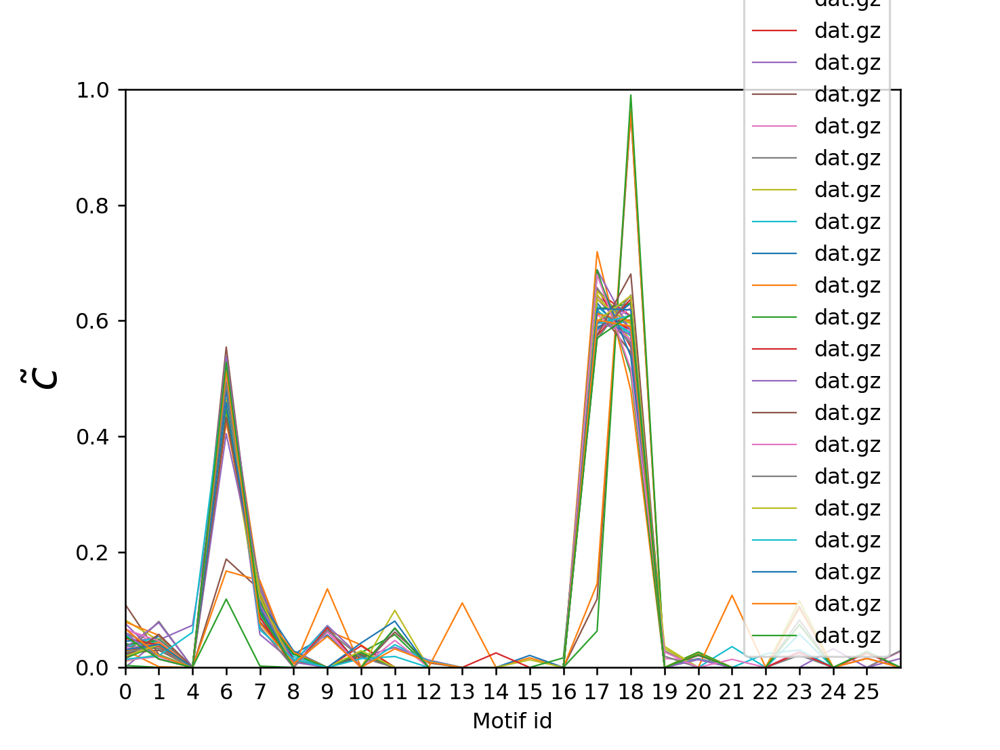

In [8]:
plt.axes().set_aspect('equal')
plt.close()
plt.clf()
plt.axis([1,len(ind)-1,0,1])
plt.ylabel(r'$\tilde{c}$',fontsize=20)
plt.xlabel('Motif id')
locs, labels = plt.xticks()
plt.xticks(range(len(ind)-1),list(ind))
for k in queries:
    plt.plot(range(len(ind)),snn[k],label=k.split('/')[-1][3:-4],linewidth=0.7)
plt.legend()
plt.savefig(folder+'D5DASNZ.pdf')

In [22]:
import pickle as cp
from copy import copy
folder='DiBrain'
queries=get_queries(folder)[:10]
#queries=['MSFW/messal_shale.gml']
MM=[]
ct=0
SNO={}
Mfile='BDmotifs5'
th=open(Mfile,'rb')
D5=pk.load(th,encoding='bytes')
th.close()
for m in D5:
        orbtype=m.new_vertex_property('int')
        m.vp.orbtype=orbtype
        orbtc=m.new_gp("vector<int>",val=[0,0,0])
        m.gp.orbtc=orbtc
        for v in m.vertices():
            if v.out_degree() and v.in_degree():
                m.gp.orbtc[2]+=1
                m.vp.orbtype[v]=2
            elif v.out_degree():
                m.vp.orbtype[v]=0
                m.gp.orbtc[0]+=1
            elif v.in_degree():
                m.vp.orbtype[v]=1
                m.gp.orbtc[1]+=1
for q in queries:
    th=open(q+'DAS_Dmotifs5ig','rb')
    C=cp.load(th)
    th.close()
    das=SIGMAvmO(C,D5)
    
    th=open(q+'A_Dmotifs5ig','rb')
    C=cp.load(th)
    th.close()
    CA=C
    a=SIGMAvmA(C,D5)
    g=vmtoG(C[0],C[1])
    print(g,len(C[0][-1]),len(C[0][-1])/g.num_edges())
    s=sigproA(C,D5)
    print(s)
    th=open(q+'NO_Dmotifs5ig','rb')
    C=cp.load(th)
    th.close()
    no=SIGMAvmNO(C,D5)
    th=open(q+'DC_Dmotifs5ig','rb')
    C=cp.load(th)
    th.close()
    dc=SIGMAvmO(C,D5)
    th=open(q+'H_Dmotifs5ig','rb')
    C=cp.load(th)
    th.close()
    h=SIGMAvmH(C,D5)
    for m in CA[1]:
        orbtype=m.new_vertex_property('int')
        m.vp.orbtype=orbtype
        orbtc=m.new_gp("vector<int>",val=[0,0,0])
        m.gp.orbtc=orbtc
        for v in m.vertices():
            if v.out_degree() and v.in_degree():
                m.gp.orbtc[2]+=1
                m.vp.orbtype[v]=2
            elif v.out_degree():
                m.vp.orbtype[v]=0
                m.gp.orbtc[0]+=1
            elif v.in_degree():
                m.vp.orbtype[v]=1
                m.gp.orbtc[1]+=1
    hdas=SIGMAvmDAS(CA,D5)
    z=SIGMAvmZ(C,D5)
    ss=[dc,a,no,das,h,hdas,z]
    print(q,ss,ss.index(min(ss)))

<Graph object, directed, with 700 vertices and 6414 edges, at 0x7f1958ba3208> 1404 0.21889616463985032
[[<Graph object, directed, with 5 vertices and 9 edges, 7 internal graph properties, at 0x7f1958ba3240>, 531.7071592143257], [<Graph object, directed, with 5 vertices and 8 edges, 7 internal graph properties, at 0x7f1958ba3048>, 729.7924880023602], [<Graph object, directed, with 5 vertices and 8 edges, 7 internal graph properties, at 0x7f194e4dd978>, 192.98570037843456], [<Graph object, directed, with 5 vertices and 6 edges, 7 internal graph properties, at 0x7f194e4dd7b8>, 2222.7673021371156], [<Graph object, directed, with 5 vertices and 6 edges, 7 internal graph properties, at 0x7f194e4dde48>, 115.91219965249911], [<Graph object, directed, with 4 vertices and 4 edges, 7 internal graph properties, at 0x7f19593c5278>, 75.64172202406553]]
MSFW/messal_shale.gml [27604.690634268536, 29220.687874941636, 29354.931139540404, 27589.336200612925, 30386.25813365815, 27865.441558674105, 27604.6

RandomDG/DBA4.graphml <Graph object, directed, with 1000 vertices and 3990 edges, at 0x7f74425b9a20>
[1.1073348173494717, 17914.74492688353, 16169.4460802079, 16211.379829542324, 16178.254892918885, 23118.064293206393, 0.9022026971142821]


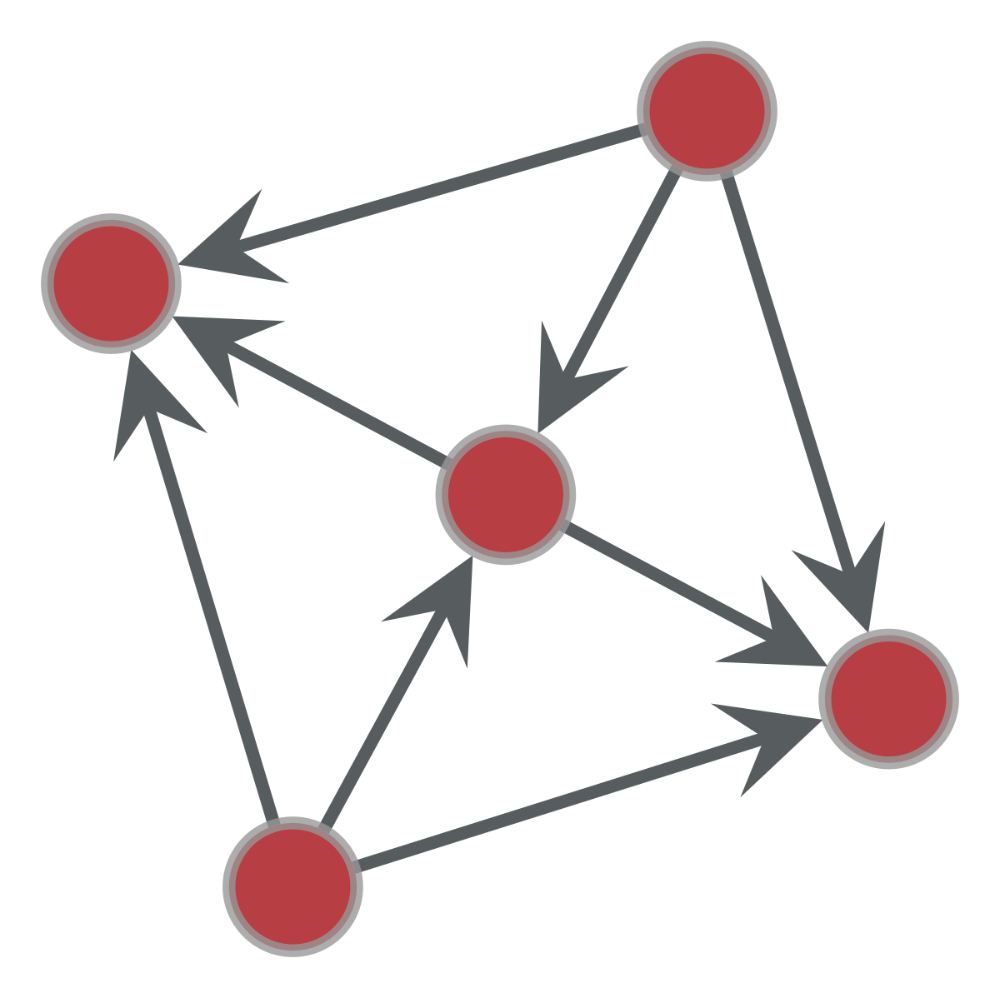

23


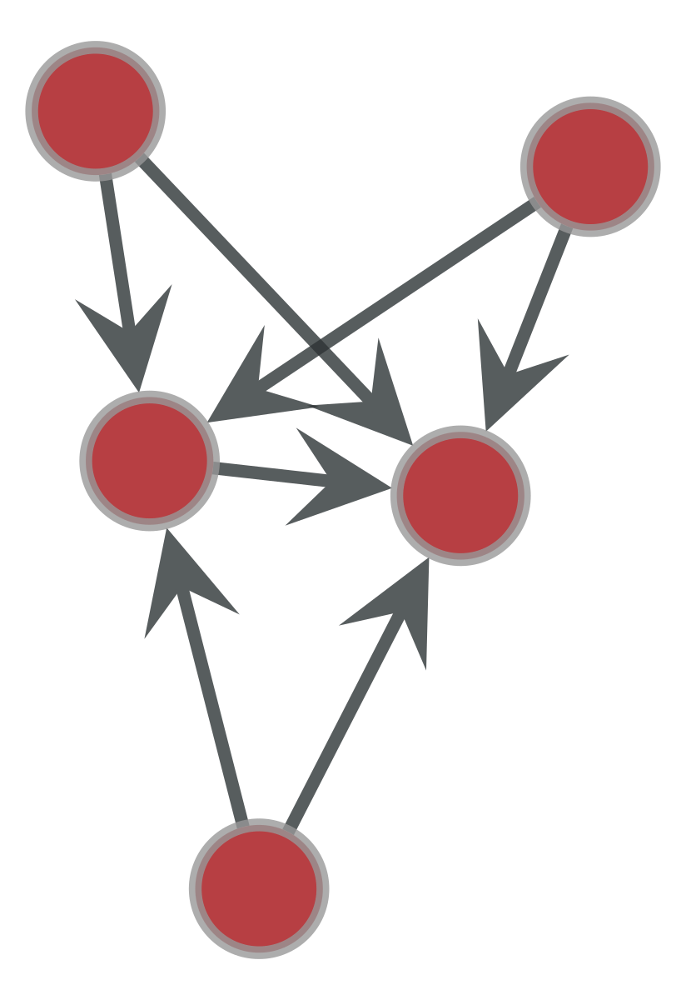

44


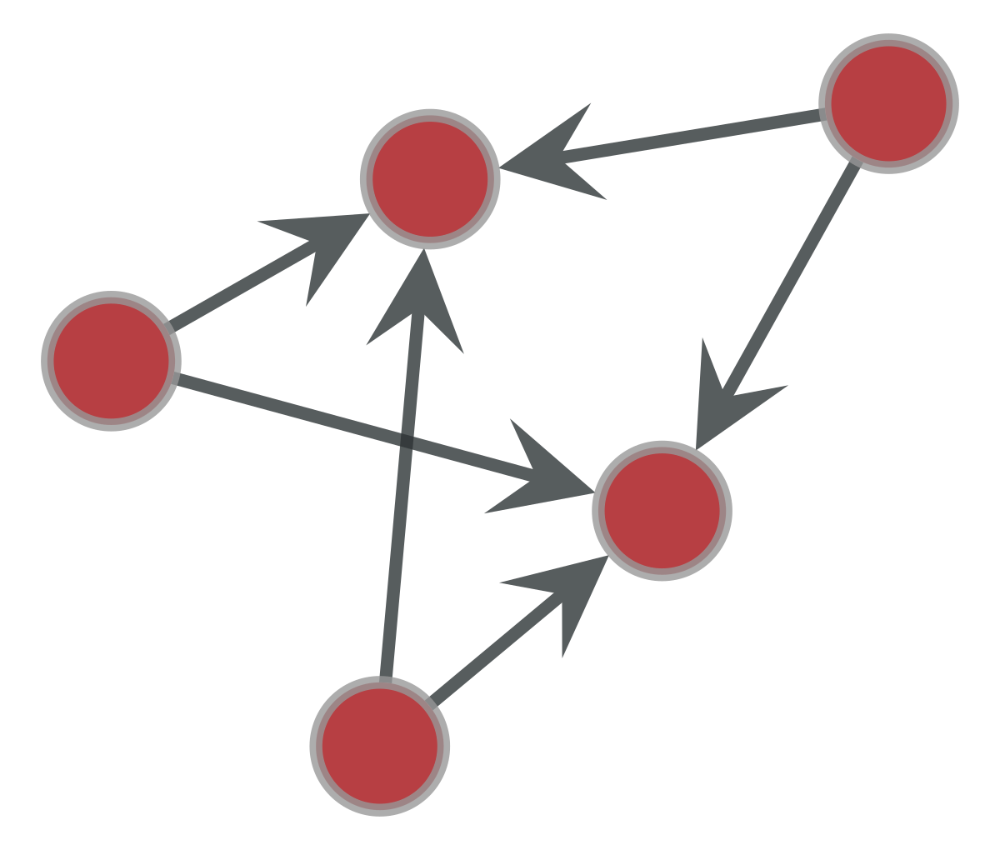

246


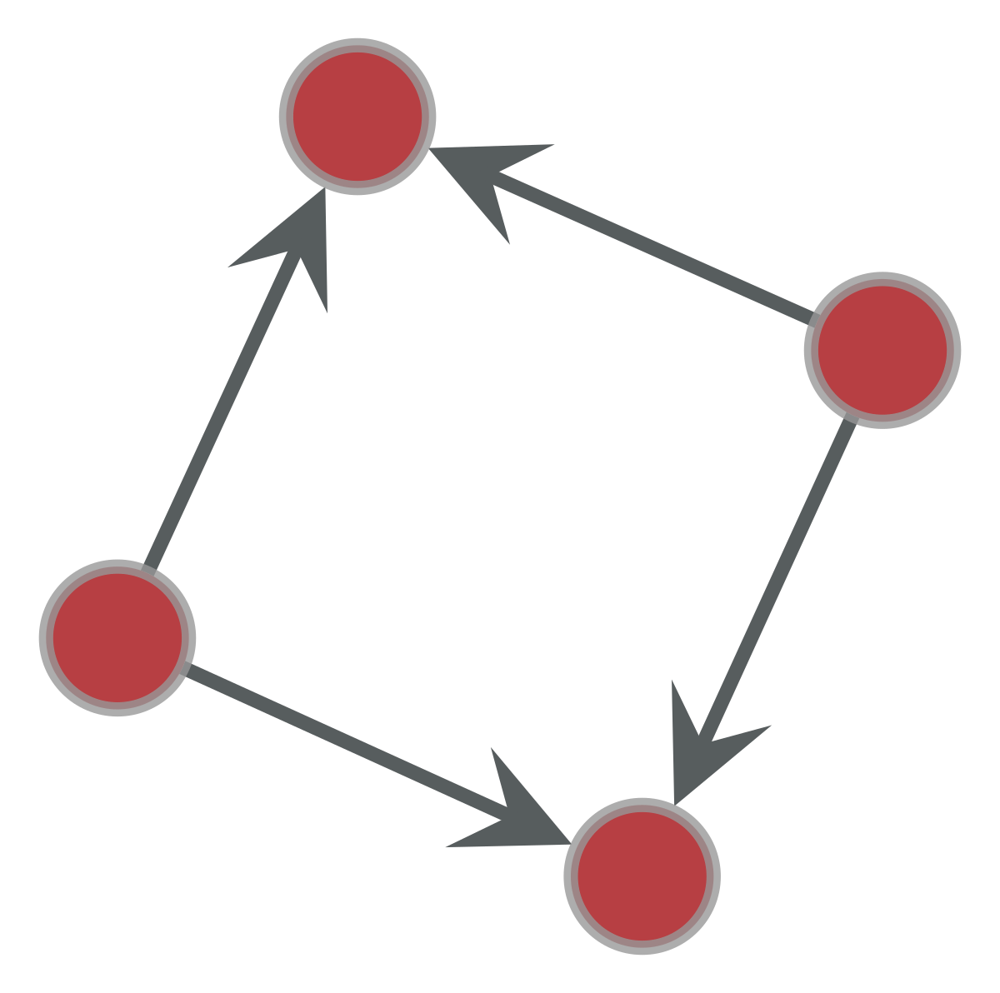

71


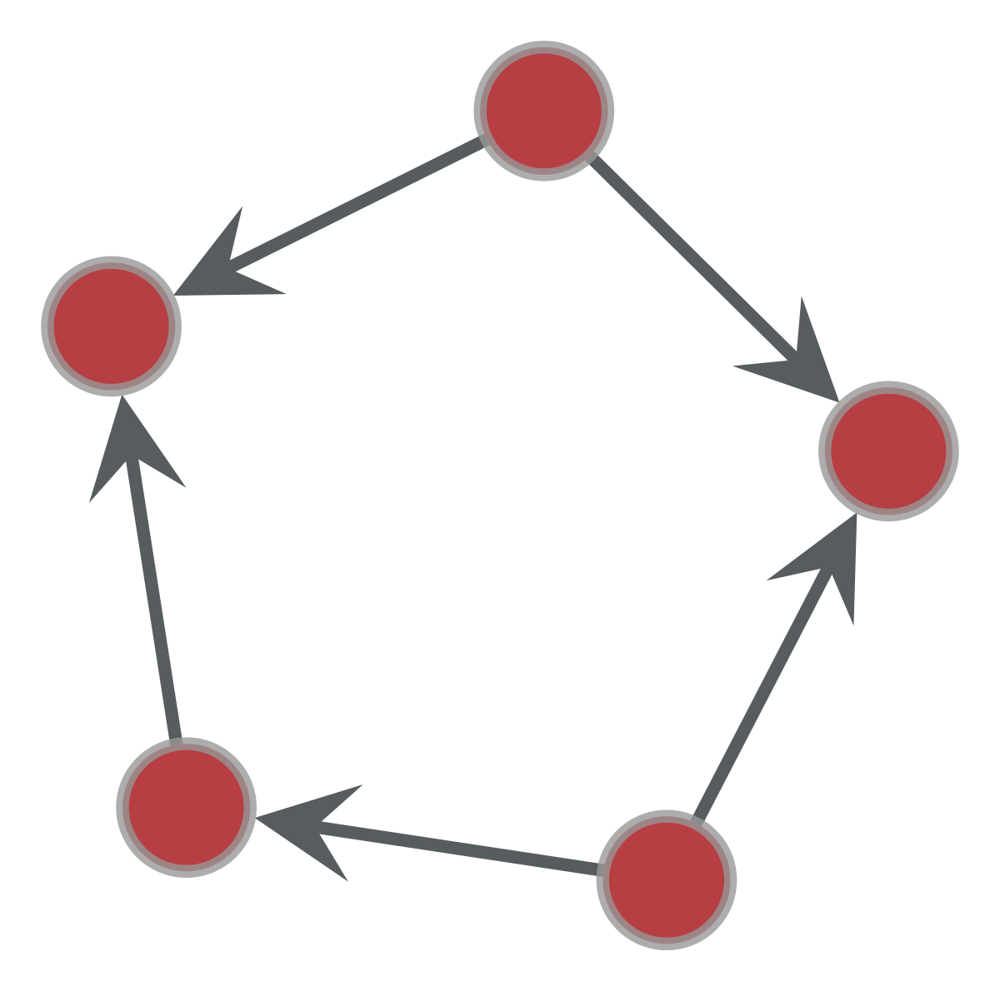

77


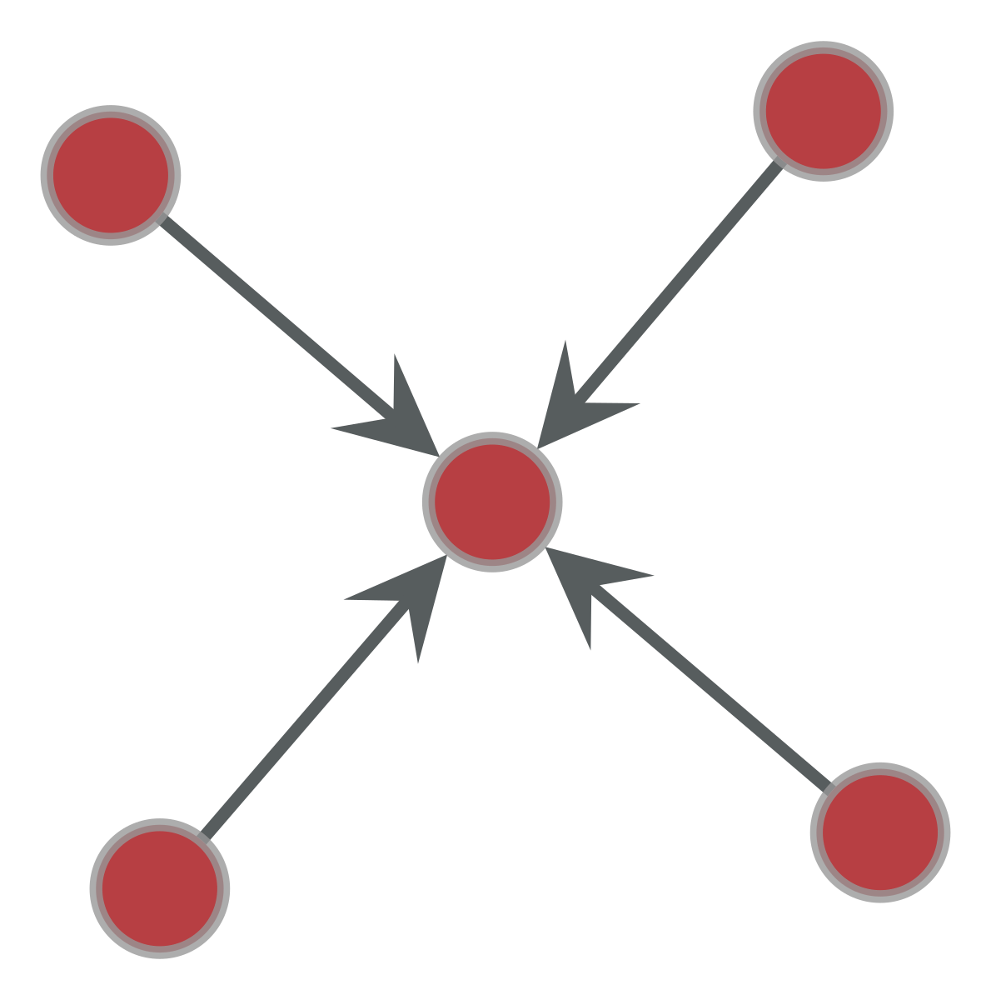

175


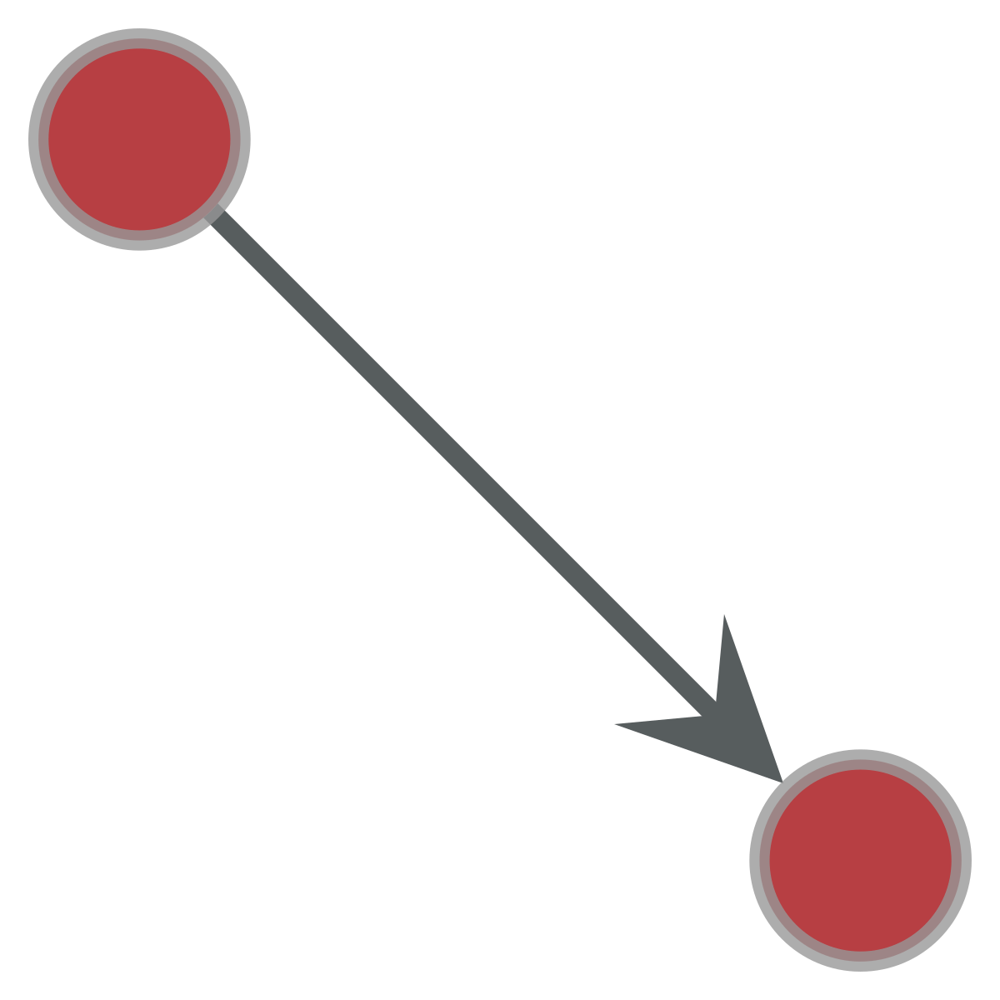

653


In [69]:
import pickle as cp
Mfile='Dmotifs5'
th=open(Mfile,'rb')
D5=pk.load(th,encoding='bytes')
th.close()
queries=['RandomDG/DBA4.graphml']#get_queries('RandomDG')
for q in queries:
    th=open(q+'A_Dmotifs5ig','rb')
    CA=cp.load(th)
    th.close()
    th=open(q+'DC_Dmotifs5ig','rb')
    DC=cp.load(th)
    th.close()
    th=open(q+'H_Dmotifs5ig','rb')
    CH=cp.load(th)
    th.close()
    th=open(q+'DAS_Dmotifs5ig','rb')
    CDAS=cp.load(th)
    th.close()
    g=CtoG(DC)
    print(q,g)
    ge=g.new_graph_property('int')
    g.gp.E=ge
    g.gp.E=g.num_edges()
    print([SIGMAvmA(CA,D5)/SIGMAvmO(DC,D5),SIGMAvmA(CA,D5),SIGMAvmDAS(CDAS,D5),SIGMAvmZ(DC,D5),SIGMAvmO(DC,D5),SIGMAvmH(CH,D5),SIGMAvmA(CA,D5)/SIGMAvmNO(CNO,D5)])
    mfolder='BAD4HM'
    #os.mkdir(mfolder)
    MM=CH[1]
    for i in range(len(CH[1])):
        gt.graph_draw(CH[1][i])
        print(len(CH[0][i]))
    i=0
    for m in MM:
        colors=['r','b','c','g','m','y','k']
        vh=m.new_vp('int',m.gp.orbmem)
        m.vp.vh=vh
        vc=m.new_vp('string')
        m.vp.vc=vc
        t=0
        for v in m.vertices():
            m.vp.vc[v]=colors[m.gp.orbmem[t]]
            t+=1  
        graph_draw(m,vertex_fill_color=m.vp.vc,inline=True,output=mfolder+'/M'+str(i)+'.pdf',output_size=(200,200))
        i+=1
    

RandomG/BA4random.graphml <Graph object, undirected, with 1000 vertices and 3990 edges, at 0x7f7443aaeb70>
[1.0, 21346.197971820045, 21346.197971820045, 21346.197971820045, 22875.34419647053, 1.075013764466794]


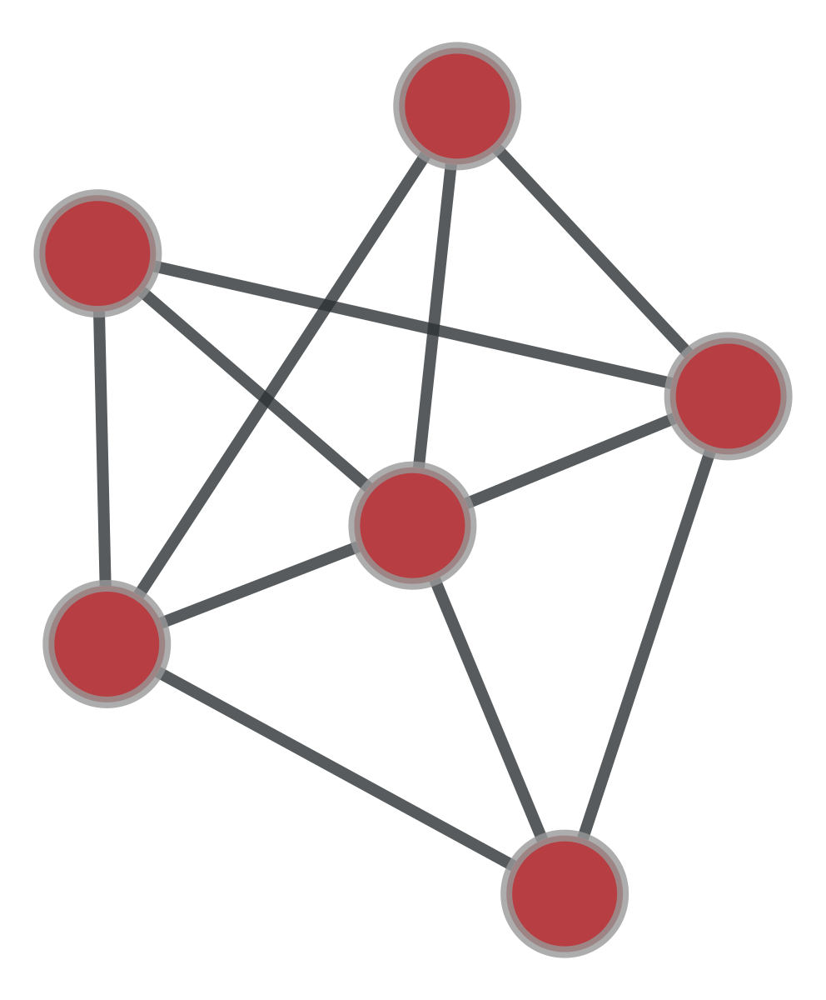

6


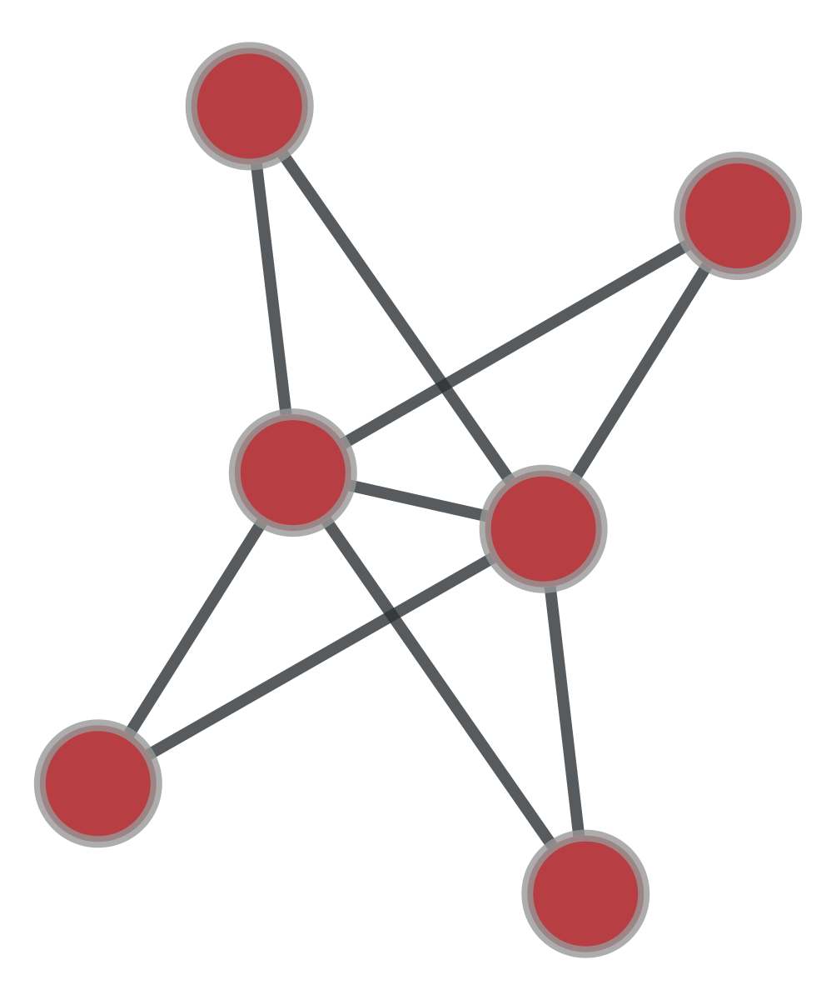

16


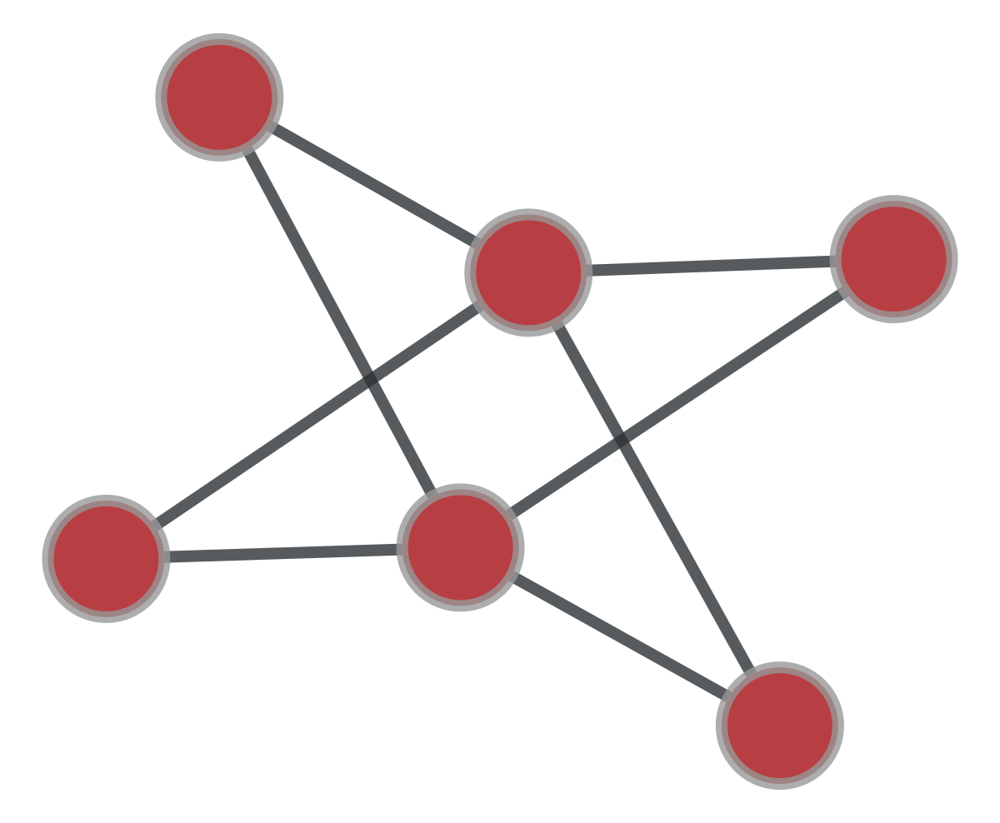

32


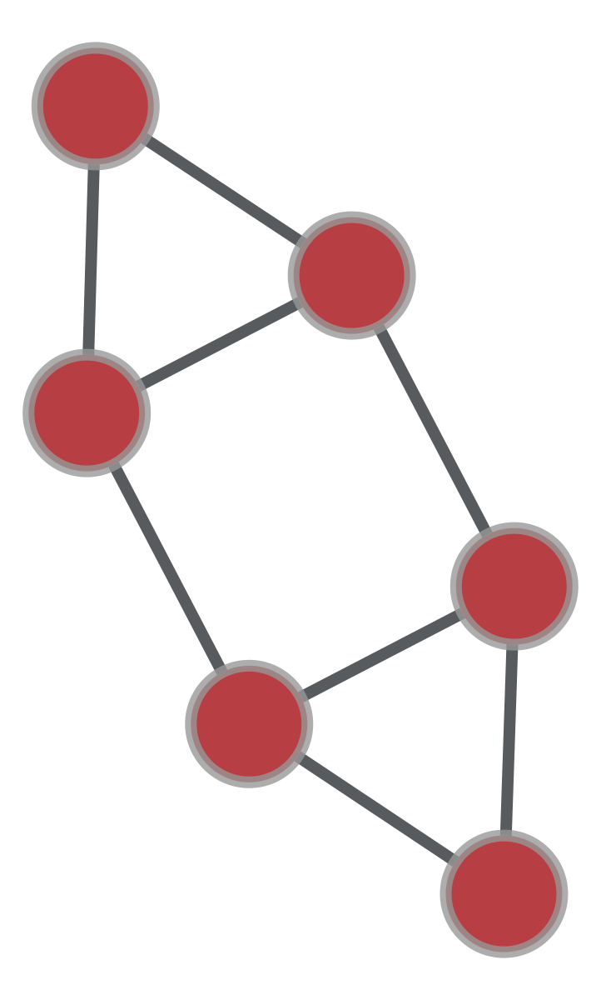

26


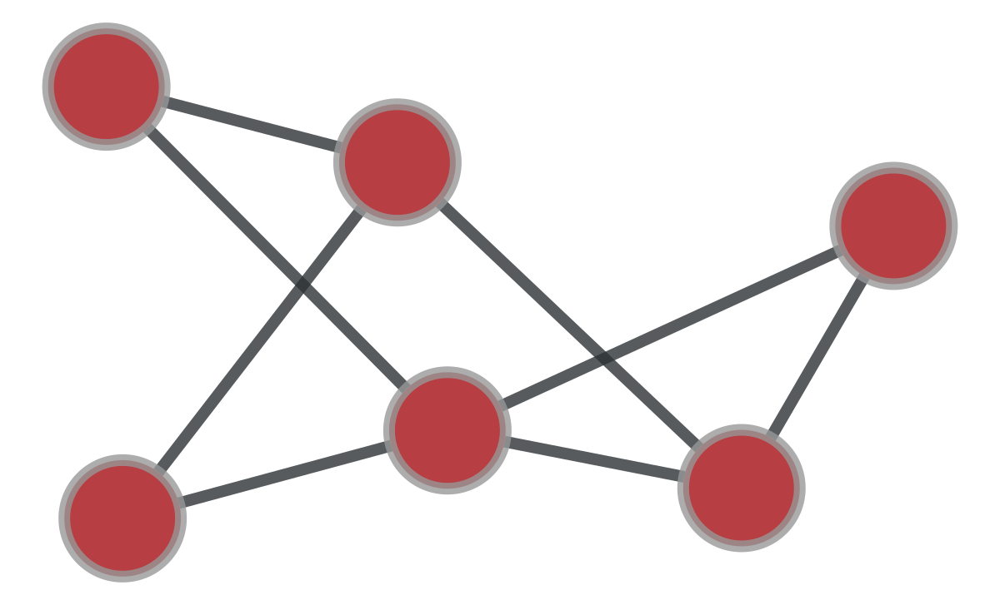

16


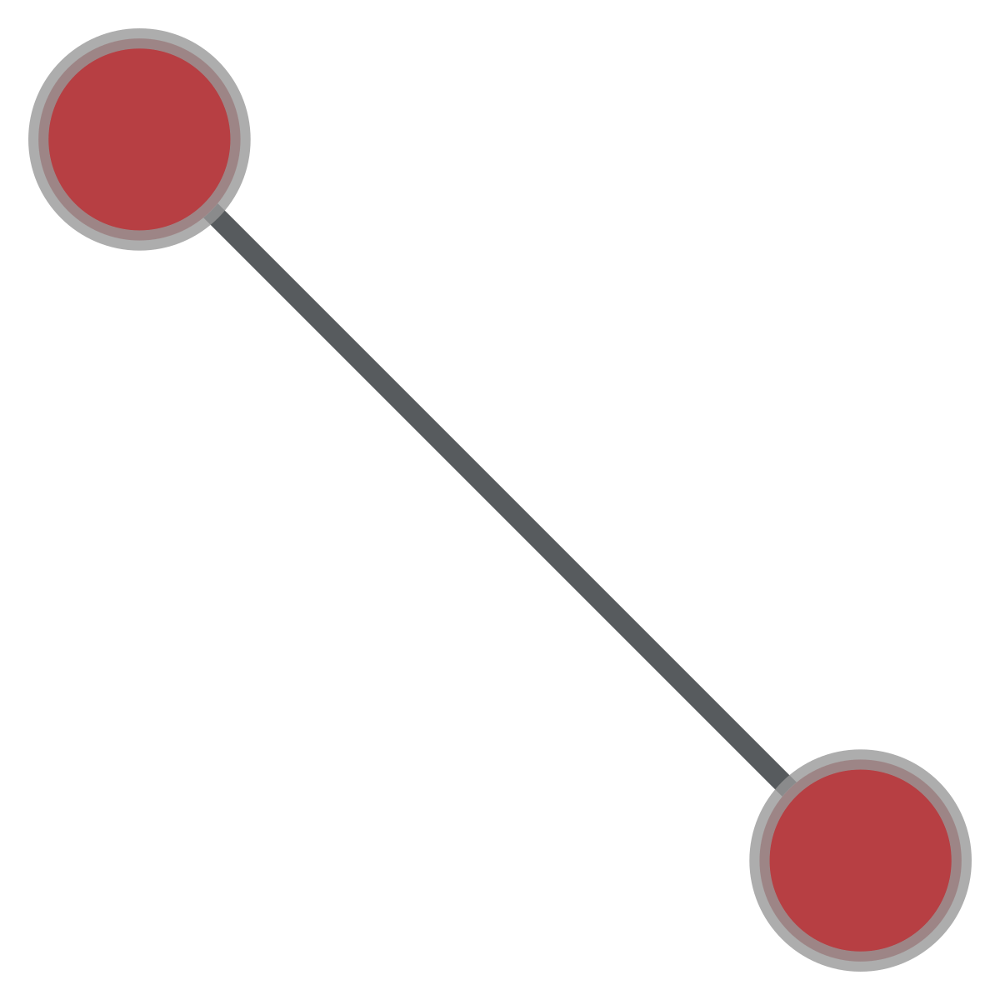

3188


In [67]:
import pickle as cp
Mfile='Umotifs6'
th=open(Mfile,'rb')
D5=pk.load(th,encoding='bytes')
th.close()
queries=['RandomG/BA4random.graphml']
for q in queries:
    th=open(q+'A_Umotifs6ig','rb')
    CA=cp.load(th)
    th.close()
    th=open(q+'DC_Umotifs6ig','rb')
    DC=cp.load(th)
    th.close()
    th=open(q+'H_Umotifs6ig','rb')
    CH=cp.load(th)
    th.close()
    g=CtoG(DC)
    print(q,g)
    ge=g.new_graph_property('int')
    g.gp.E=ge
    g.gp.E=g.num_edges()
    print([SIGMAvmA(CA,D5)/SIGMAvmO(DC,D5),SIGMAvmA(CA,D5),SIGMAvmZ(DC,D5),SIGMAvmO(DC,D5),SIGMAvmH(CH,D5),SIGMAvmA(CA,D5)/SIGMAvmNO(CNO,D5)])
    mfolder='BA4randomHM'
    #os.mkdir(mfolder)
    MM=CH[1]
    for i in range(len(CH[1])):
        gt.graph_draw(CH[1][i])
        print(len(CH[0][i]))
    i=0
    for m in MM:
        colors=['r','b','c','g','m','y','k']
        vh=m.new_vp('int',m.gp.orbmem)
        m.vp.vh=vh
        vc=m.new_vp('string')
        m.vp.vc=vc
        t=0
        for v in m.vertices():
            m.vp.vc[v]=colors[m.gp.orbmem[t]]
            t+=1  
        graph_draw(m,vertex_fill_color=m.vp.vc,inline=True,output=mfolder+'/M'+str(i)+'.pdf',output_size=(200,200))
        i+=1

In [21]:
def rf(M,D):
    return [(sum([1 for q in D.keys() if D[q][i]])/float(len(D))) for i in range(len(M))]

#print sorted(rf(MM,D))
def vmtoG(VM,M):
    elist=[]
    for i in range(len(VM)):
        for vmap in VM[i]:
            for e in M[i].edges():
                elist.append([vmap[M[i].vertex_index[e.source()]],vmap[M[i].vertex_index[e.target()]]])
    g=gt.Graph(directed=M[0].is_directed())
    g.add_edge_list(elist)
    return g
def CtoG(C2):
    return vmtoG([c[0] for c in C2],[c[1] for c in C2])

In [189]:
os.mkdir('DiBrainF')
for q in get_queries('DiBrain'):

    G=gt.load_graph(q)
    #print G
    #print [G.ep.numberoffibers[e] for e in G.edges()]
    cove=G.new_edge_property("bool",val=True)
    G.ep.co=cove
    for e in G.edges():
        G.ep.co[e]=bool(G.ep.numberoffibers[e]>1.0)
    G.set_edge_filter(G.ep.co)
    G.purge_edges()
    G.clear_filters()
    del G.ep['co']
    #print G
    G.save('DiBrainF/F'+q.split('/')[-1],fmt='gml')


In [3]:
f=open('Meta/AA.dat.gz.gmlA_Dmotifs5ig','rb')
C=pk.load(f)
f.close()

In [4]:
C[0]

[[[86, 104, 361, 415, 414],
  [94, 328, 105, 965, 966],
  [100, 361, 102, 846, 845],
  [165, 104, 389, 518, 517],
  [264, 364, 402, 923, 922],
  [318, 173, 105, 845, 846],
  [323, 361, 102, 699, 698],
  [401, 364, 157, 925, 924],
  [436, 759, 438, 62, 43],
  [506, 483, 488, 102, 105],
  [760, 435, 437, 43, 62],
  [941, 418, 441, 361, 157],
  [1011, 432, 997, 390, 112],
  [31, 166, 105, 954, 955],
  [33, 361, 102, 955, 954],
  [37, 361, 102, 697, 696],
  [37, 173, 105, 698, 699],
  [87, 328, 157, 826, 827],
  [116, 169, 113, 893, 920],
  [117, 106, 361, 920, 893],
  [164, 104, 389, 786, 585],
  [168, 166, 105, 585, 786],
  [181, 201, 157, 981, 982],
  [226, 361, 102, 966, 965],
  [227, 60, 361, 780, 779],
  [234, 203, 361, 784, 783],
  [254, 112, 202, 566, 565],
  [265, 144, 361, 862, 861],
  [349, 112, 157, 560, 559],
  [416, 963, 967, 88, 36],
  [416, 833, 839, 173, 157],
  [419, 426, 445, 202, 201],
  [420, 425, 446, 201, 202],
  [423, 434, 448, 203, 204],
  [424, 447, 451, 204, 203]

In [22]:
import cPickle as cp
th=open('Meta/AA.dat.gz.gmlA_Dmotifs5ig','rb')
C=cp.load(th)
th.close()
#print C[-1]
print sigproA(C)
th=open('Meta/AA.dat.gz.gmlDC_Dmotifs5ig','rb')
C=cp.load(th)
th.close()
print sigproDC(C)

13982.3964636
15878.425694
16024.8402795
14218.0719925
14093.8572523
14002.7499217
14022.2025423
14025.7037866
[[<Graph object, directed, with 5 vertices and 6 edges at 0x7fa411e06f90>, 2042.443815933726], [<Graph object, directed, with 4 vertices and 4 edges at 0x7fa411fef7d0>, 235.67552889513172], [<Graph object, directed, with 5 vertices and 6 edges at 0x7fa4125bfa10>, 111.46078867726465], [<Graph object, directed, with 5 vertices and 6 edges at 0x7fa4125bfe10>, 20.353458117719128], [<Graph object, directed, with 4 vertices and 4 edges at 0x7fa4125bf390>, 39.806078727689965], [<Graph object, directed, with 2 vertices and 2 edges at 0x7fa4121d1750>, 43.307323043147335]]
14055.3697031
(15746.430616713054, 12793.937629358878, 2952.4929873541782)
15570.2786693
15789.3879341
15390.7818867
14181.1037992
14257.364373
14115.2867001
[[<Graph object, directed, with 5 vertices and 6 edges at 0x7fa4127edcd0>, 1514.9089661301605], [<Graph object, directed, with 5 vertices and 6 edges at 0x7fa411

In [249]:
Ds={}
for q in queries:
    th=open(q+'DC_Umotifs7','rb')
    C=cp.load(th)
    th.close()
    VM=[c[0] for c in C]
    M=[c[1] for c in C]
    th=open('Umotifs4','rb')
    Ms=cp.load(th)
    th.close()
    m0=Ms[0]
    G=vmtoG(VM,M)
    ed=G.new_graph_property("int",val=G.num_edges())
    G.gp.E=ed
    Ds[q]=[dc.SIGMA0(G,m0),dc.SIGMAvmD(C,G),G]

In [250]:
Ds

{'Proteins/PROTEINs_107.gml': [2088.9271060873048,
  (2059.1358152542002, 1286.6676376129531, 772.46817764124728),
  <Graph object, undirected, with 244 vertices and 391 edges at 0x7fe4c8aafb90>],
 'Proteins/PROTEINs_161.gml': [1570.7575790577955,
  (1512.1708435278572, 987.09787394910495, 525.07296957875235),
  <Graph object, undirected, with 188 vertices and 310 edges at 0x7fe4c9178210>],
 'Proteins/PROTEINs_18.gml': [2347.8883774365277,
  (2278.6374248389861, 1389.9034228393875, 888.73400199959906),
  <Graph object, undirected, with 285 vertices and 424 edges at 0x7fe4c8e23b50>],
 'Proteins/PROTEINs_180.gml': [2418.6427657590239,
  (2352.1251133996761, 1426.5182832729452, 925.60683012673121),
  <Graph object, undirected, with 229 vertices and 483 edges at 0x7fe4c91784d0>],
 'Proteins/PROTEINs_191.gml': [1876.992487323658,
  (1522.6982682052469, 778.51377154677152, 744.18449665847527),
  <Graph object, undirected, with 189 vertices and 392 edges at 0x7fe4c8e23f10>],
 'Proteins/PROTEI

In [162]:
queries=get_queries('Meta')
queries.reverse()
print queries


['Meta/YP.dat.gz.gml', 'Meta/TY.dat.gz.gml', 'Meta/TP.dat.gz.gml', 'Meta/TM.dat.gz.gml', 'Meta/TH.dat.gz.gml', 'Meta/ST.dat.gz.gml', 'Meta/SC.dat.gz.gml', 'Meta/RP.dat.gz.gml', 'Meta/RC.dat.gz.gml', 'Meta/PN.dat.gz.gml', 'Meta/PH.dat.gz.gml', 'Meta/PG.dat.gz.gml', 'Meta/PF.dat.gz.gml', 'Meta/PA.dat.gz.gml', 'Meta/OS.dat.gz.gml', 'Meta/NM.dat.gz.gml', 'Meta/NG.dat.gz.gml', 'Meta/MT.dat.gz.gml', 'Meta/MP.dat.gz.gml', 'Meta/ML.dat.gz.gml', 'Meta/MJ.dat.gz.gml', 'Meta/MG.dat.gz.gml', 'Meta/MB.dat.gz.gml', 'Meta/HP.dat.gz.gml', 'Meta/HI.dat.gz.gml', 'Meta/EN.dat.gz.gml', 'Meta/EF.dat.gz.gml', 'Meta/EC.dat.gz.gml', 'Meta/DR.dat.gz.gml', 'Meta/CY.dat.gz.gml', 'Meta/CT.dat.gz.gml', 'Meta/CQ.dat.gz.gml', 'Meta/CL.dat.gz.gml', 'Meta/CJ.dat.gz.gml', 'Meta/CE.dat.gz.gml', 'Meta/CA.dat.gz.gml', 'Meta/BS.dat.gz.gml', 'Meta/BB.dat.gz.gml', 'Meta/AT.dat.gz.gml', 'Meta/AP.dat.gz.gml', 'Meta/AG.dat.gz.gml', 'Meta/AB.dat.gz.gml', 'Meta/AA.dat.gz.gml']


90
[set([0]), set([1])]


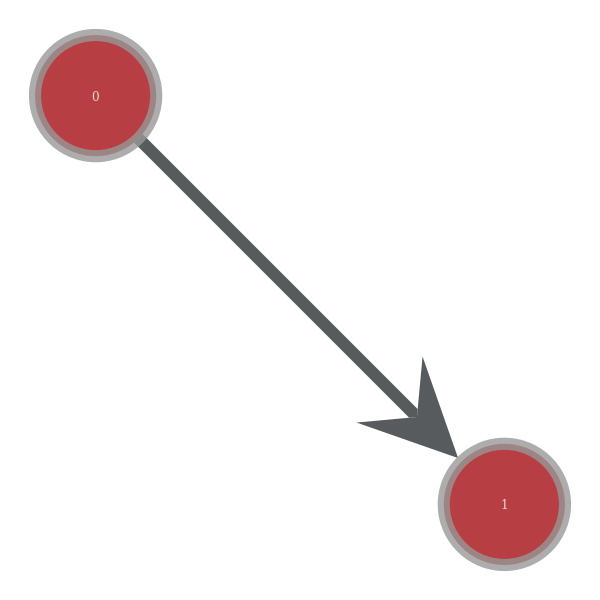

[set([0, 1, 2]), set([3, 4])]


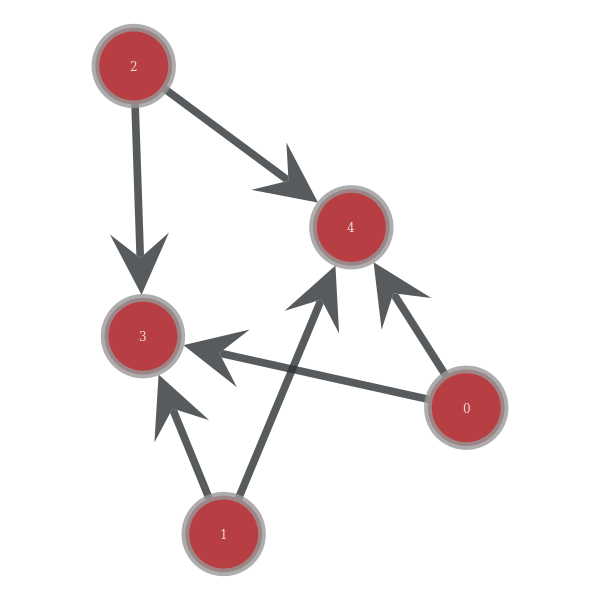

[set([0, 1]), set([2]), set([3]), set([4])]


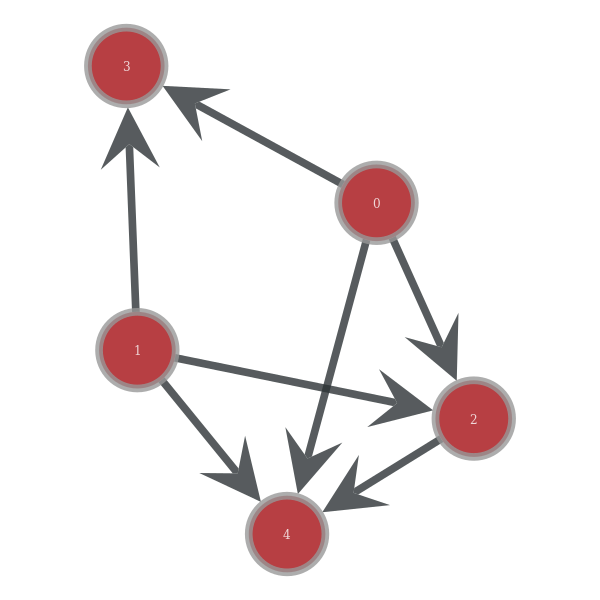

[set([0, 1, 2]), set([3]), set([4])]


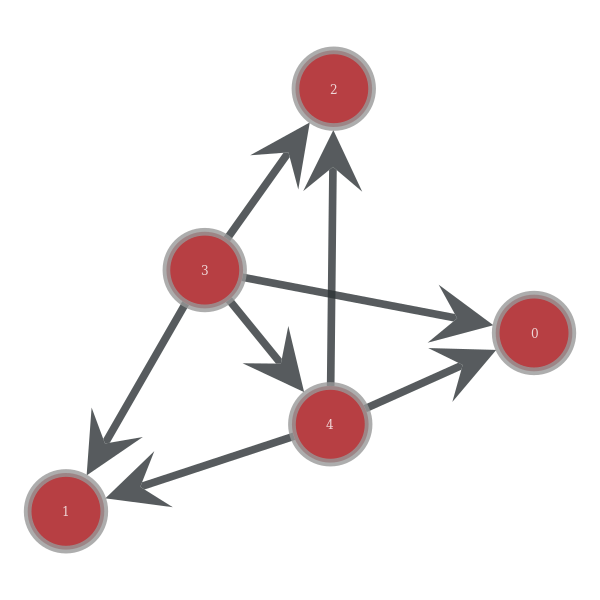

[set([0, 1, 2]), set([3]), set([4])]


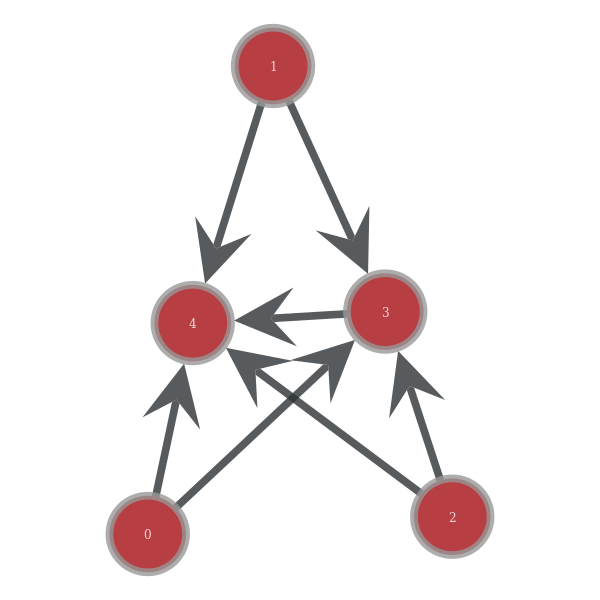

[set([0]), set([1]), set([2]), set([3]), set([4])]


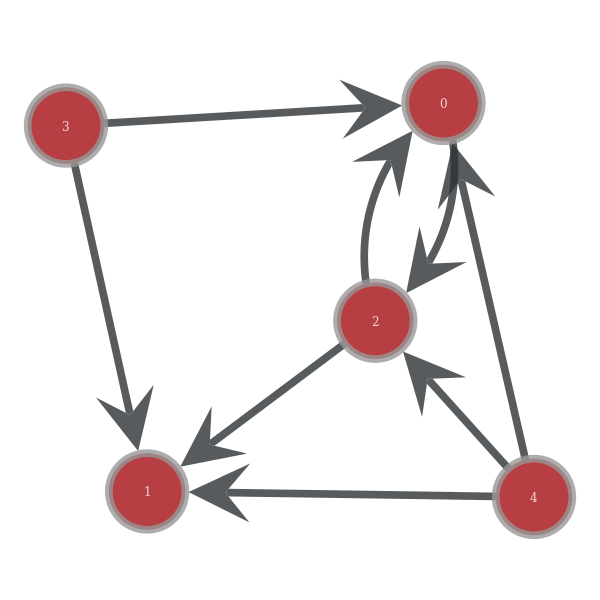

[set([0, 1]), set([2, 3]), set([4])]


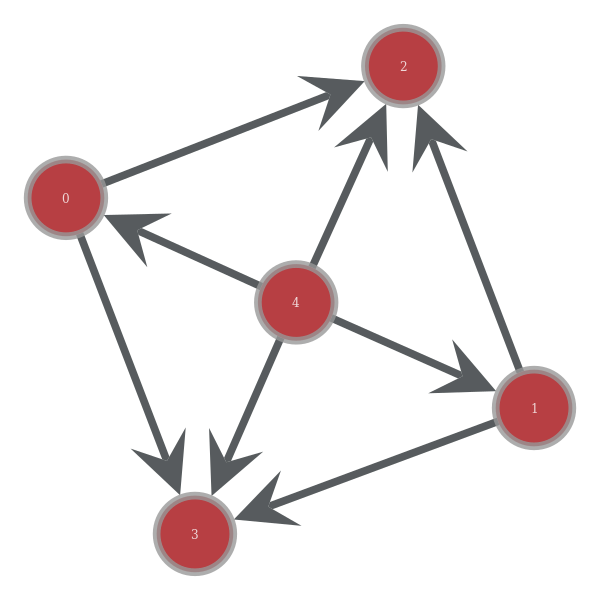

[set([0, 1]), set([2]), set([3]), set([4])]


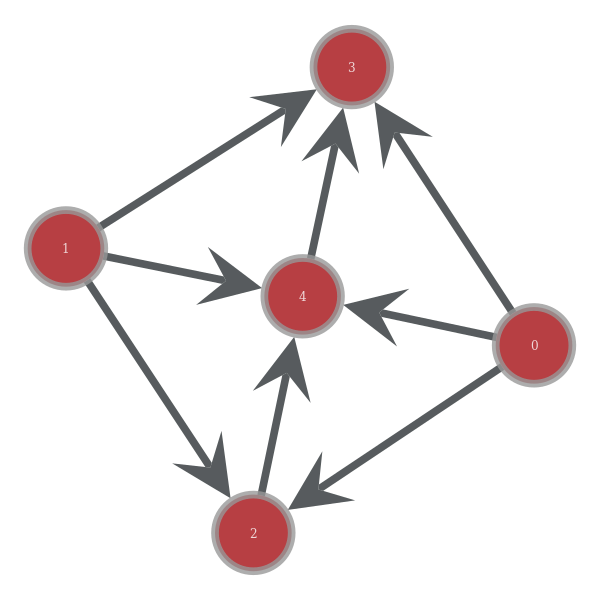

[set([0, 1]), set([2, 4]), set([3])]


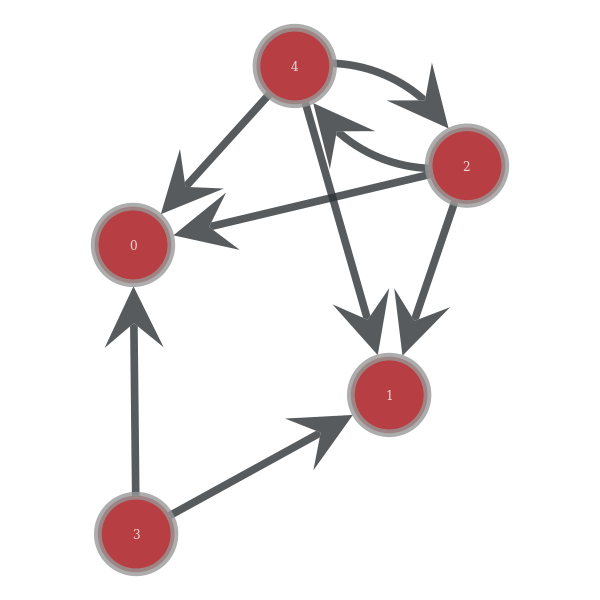

[set([0, 1]), set([2, 3]), set([4])]


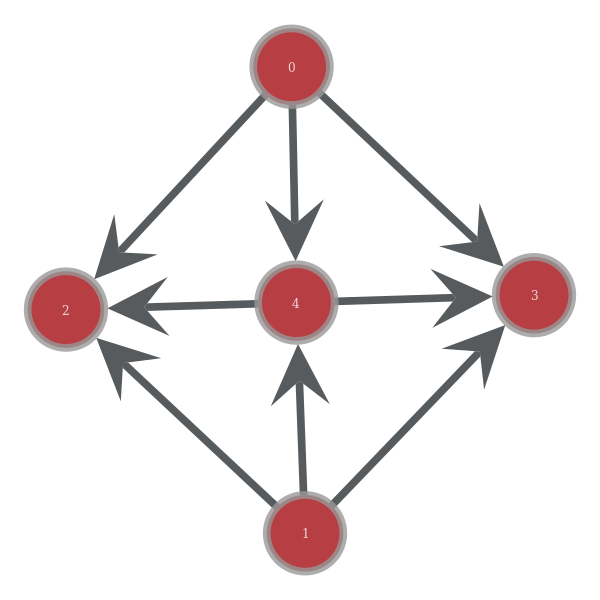

[set([0, 1]), set([2, 3]), set([4])]


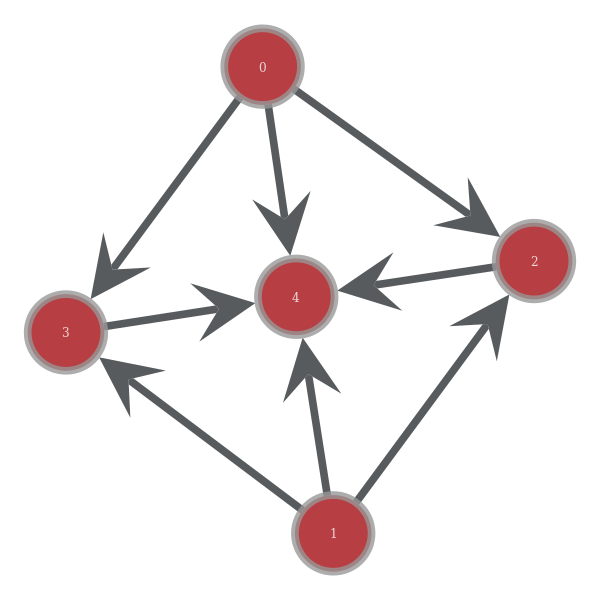

[set([0, 1]), set([2, 3])]


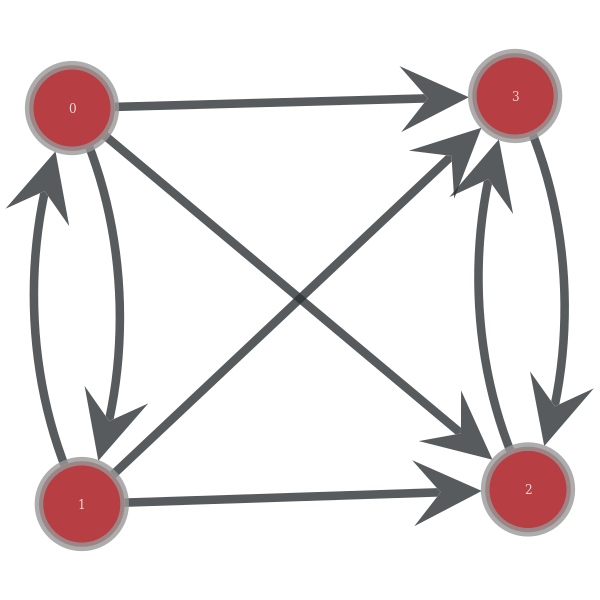

[set([0, 1]), set([2]), set([3]), set([4])]


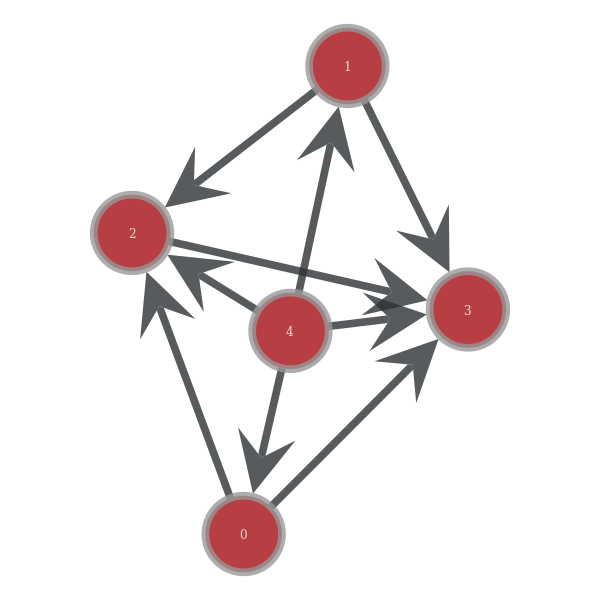

[set([0, 1]), set([2]), set([3]), set([4])]


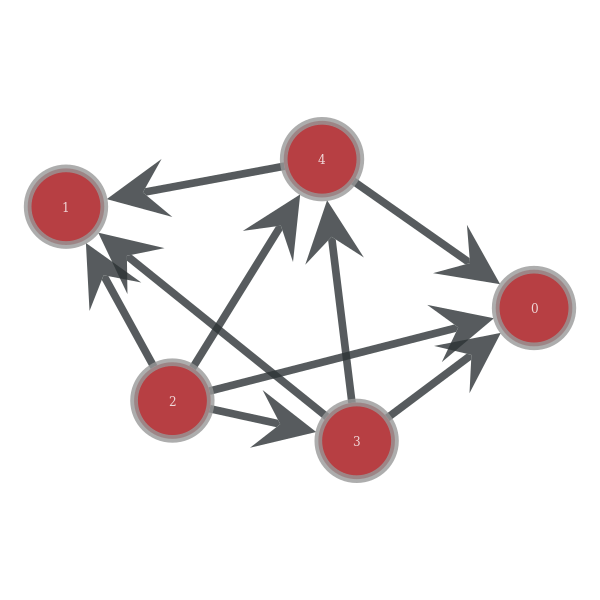

[set([0, 1]), set([2]), set([3]), set([4])]


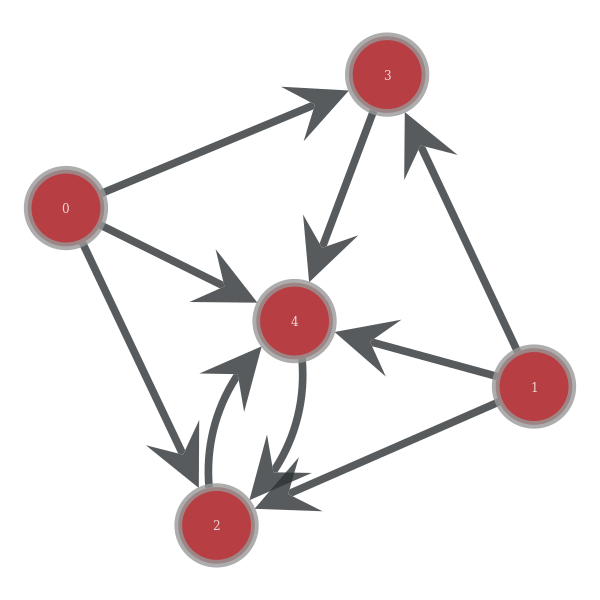

[set([0, 2]), set([1]), set([3]), set([4])]


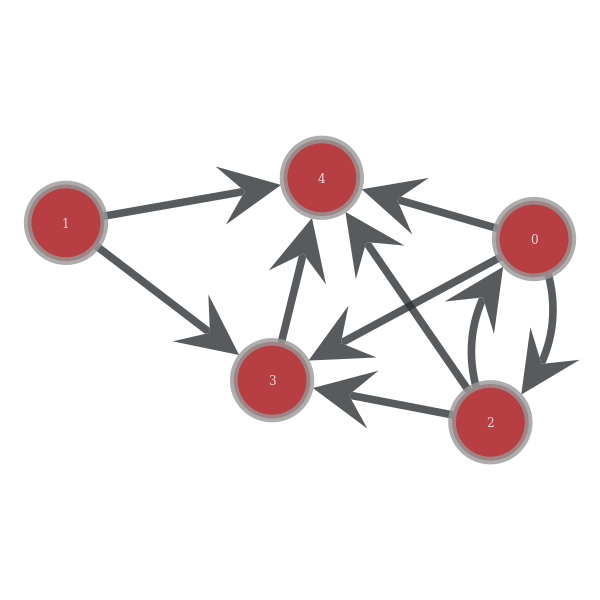

[set([0, 1]), set([2]), set([3]), set([4])]


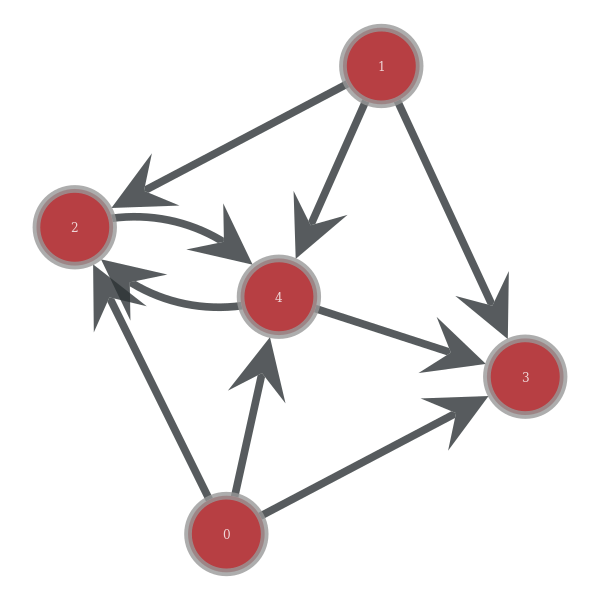

[set([0, 1]), set([2]), set([3]), set([4])]


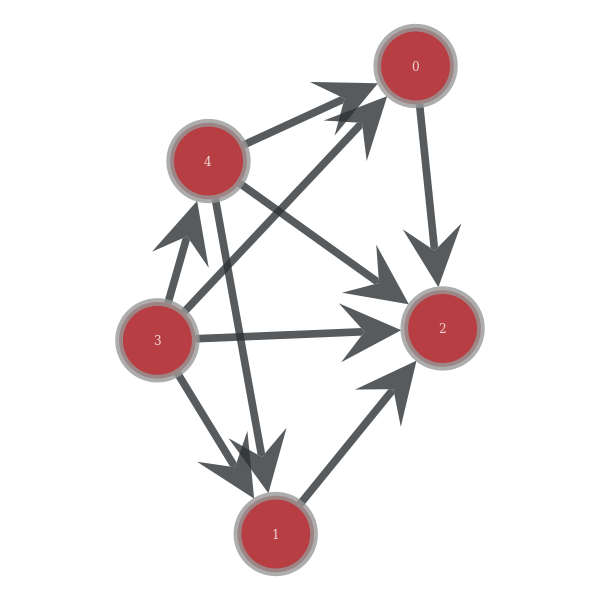

[set([0, 1, 2]), set([3])]


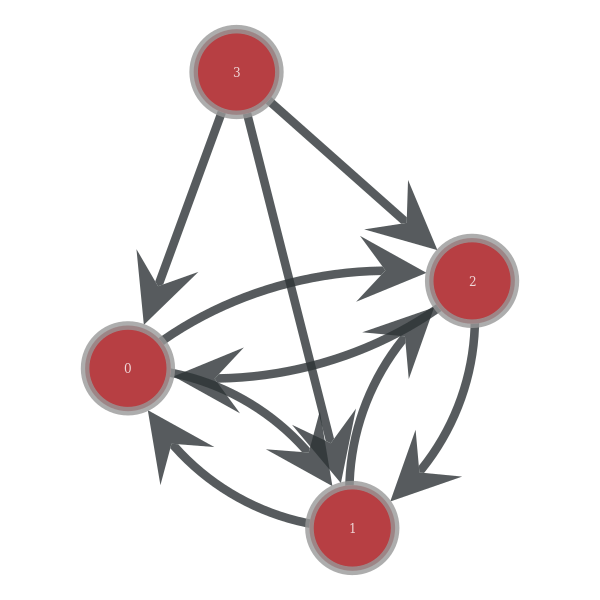

[set([0]), set([1]), set([2]), set([3]), set([4])]


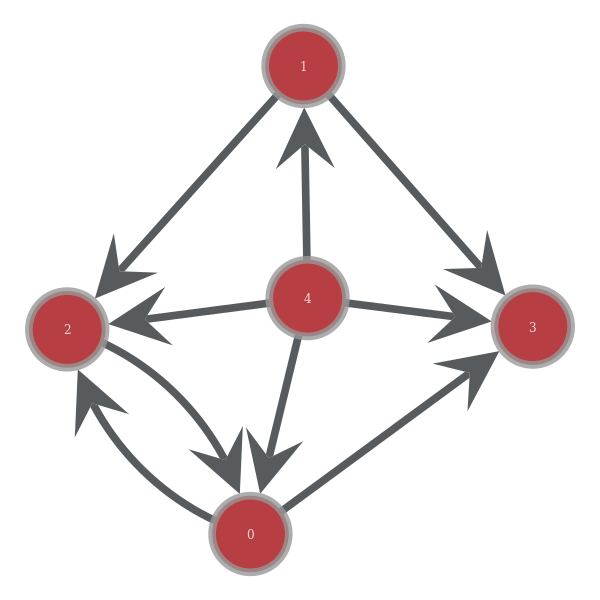

[set([0, 2]), set([1]), set([3]), set([4])]


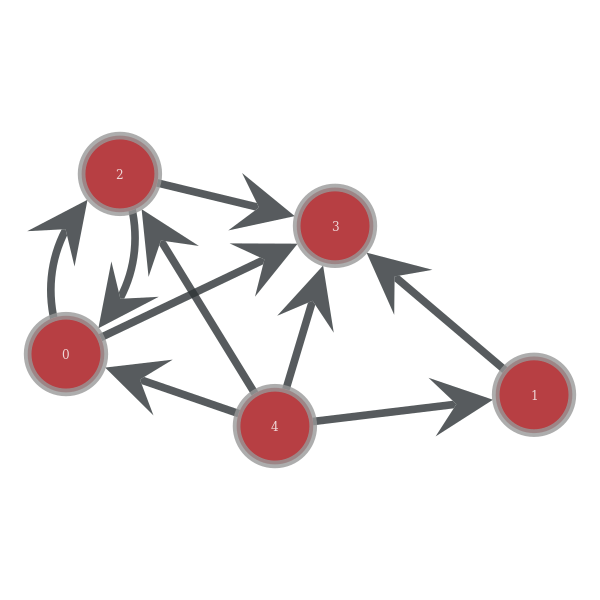

[set([0, 1]), set([2, 3]), set([4])]


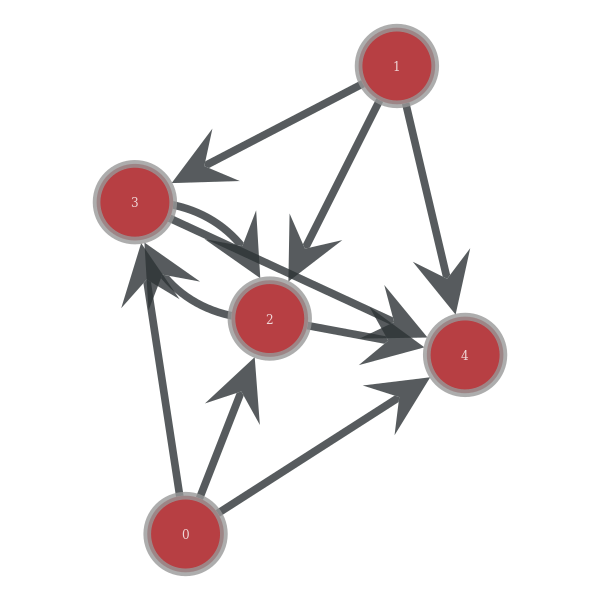

[set([0]), set([1]), set([2]), set([3]), set([4])]


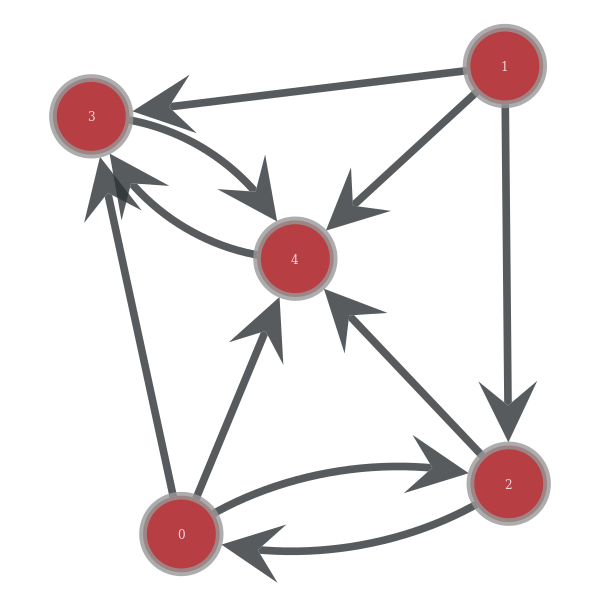

[set([0]), set([1]), set([2]), set([3]), set([4])]


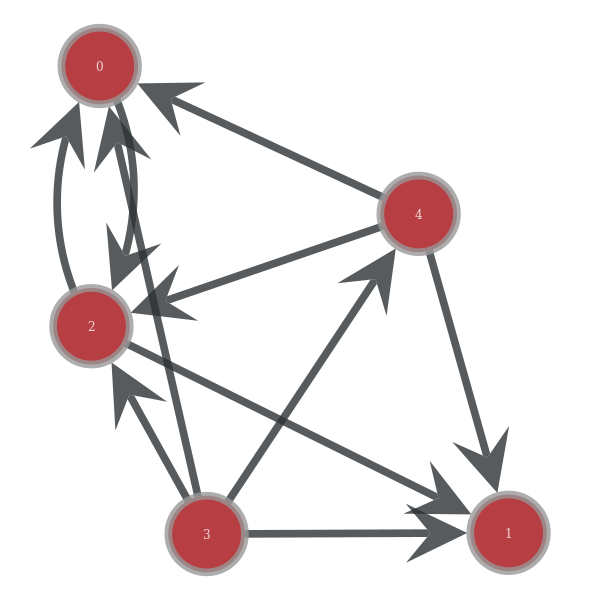

[set([0, 2]), set([1]), set([3, 4])]


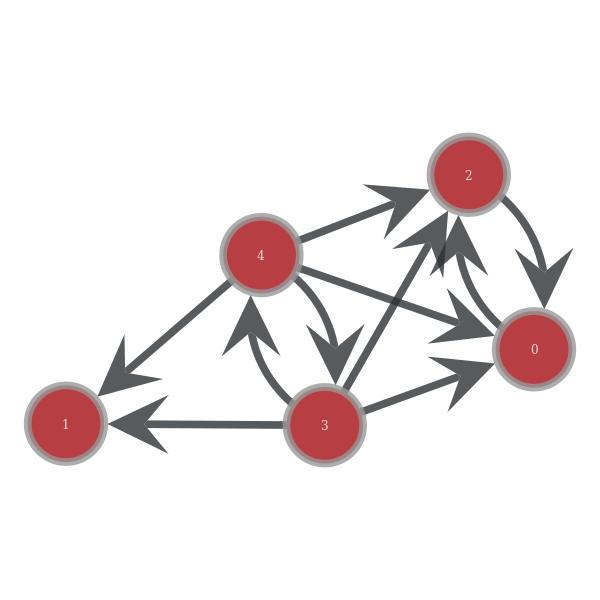

[set([0, 1]), set([2, 3]), set([4])]


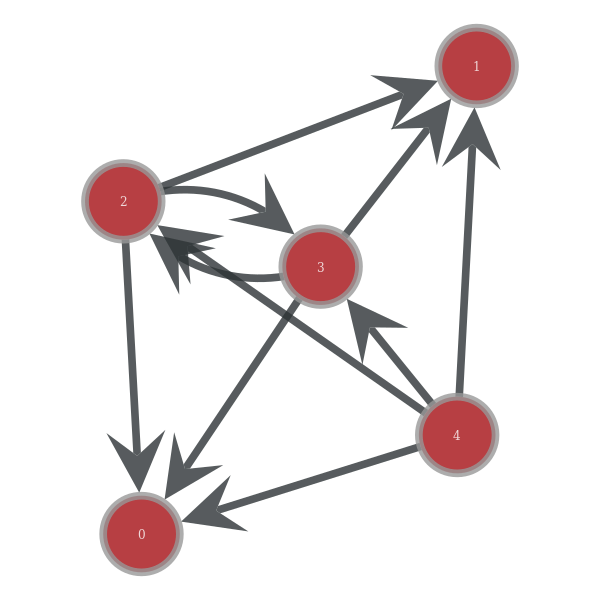

[set([0]), set([1]), set([2, 3]), set([4])]


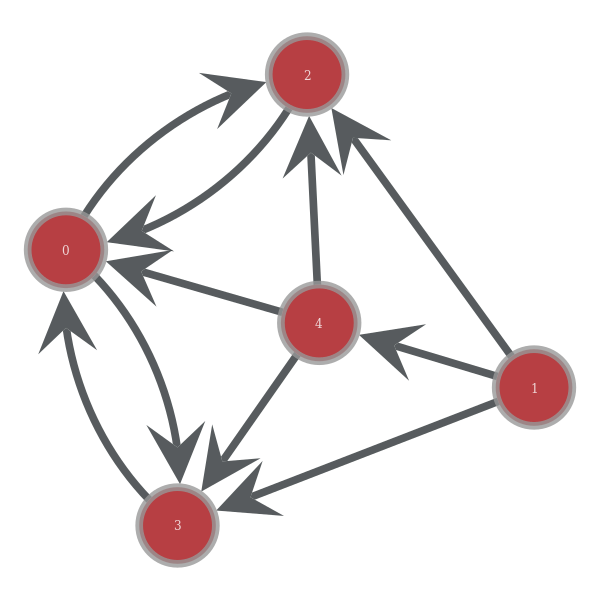

[set([0]), set([1]), set([2]), set([3]), set([4])]


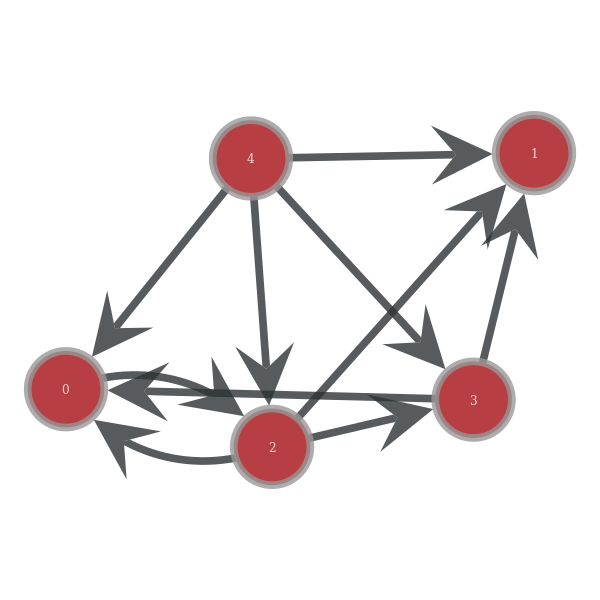

[set([0, 1]), set([2, 3]), set([4])]


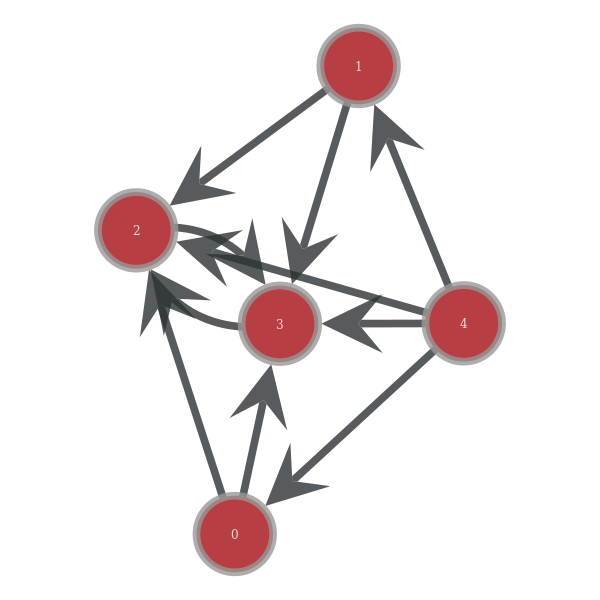

[set([0]), set([1]), set([2]), set([3]), set([4])]


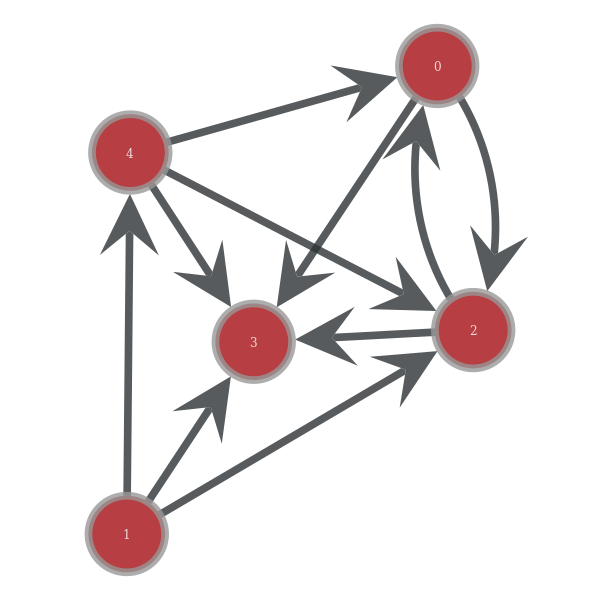

[set([0]), set([1]), set([2, 3]), set([4])]


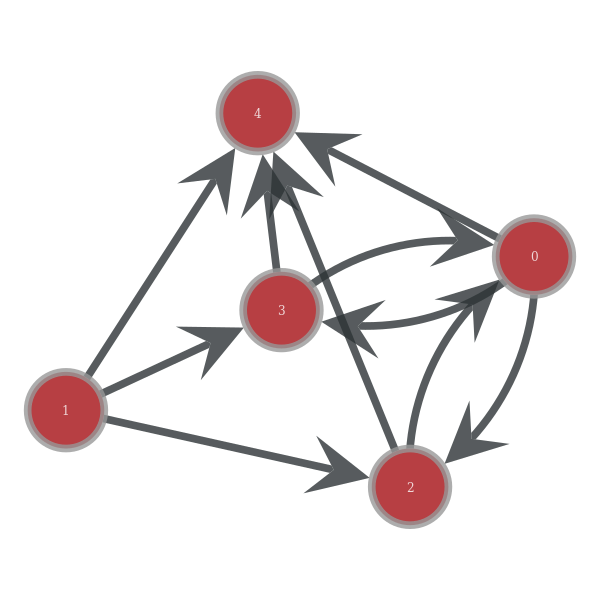

[set([0, 1]), set([2, 3]), set([4])]


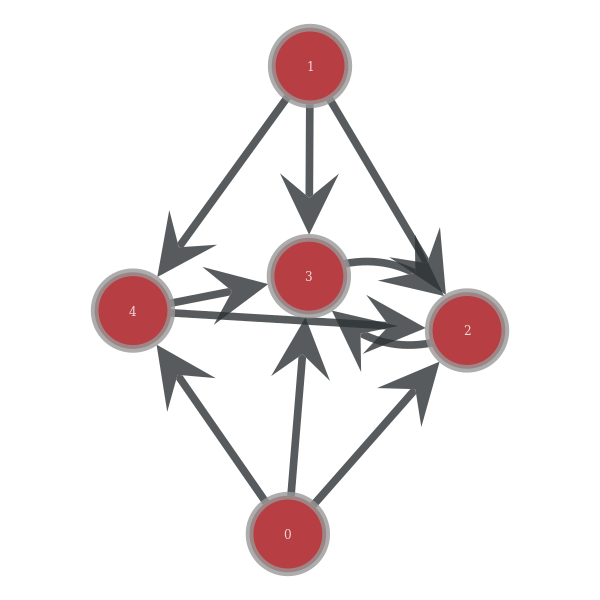

[set([0]), set([1]), set([2]), set([3]), set([4])]


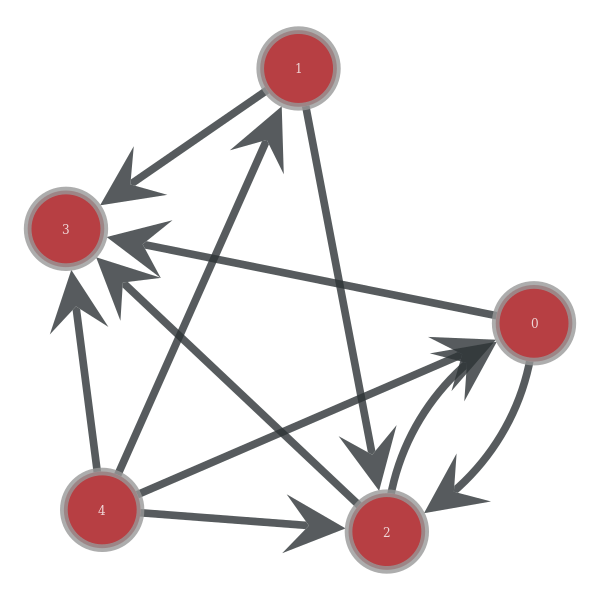

[set([0]), set([1]), set([2]), set([3]), set([4])]


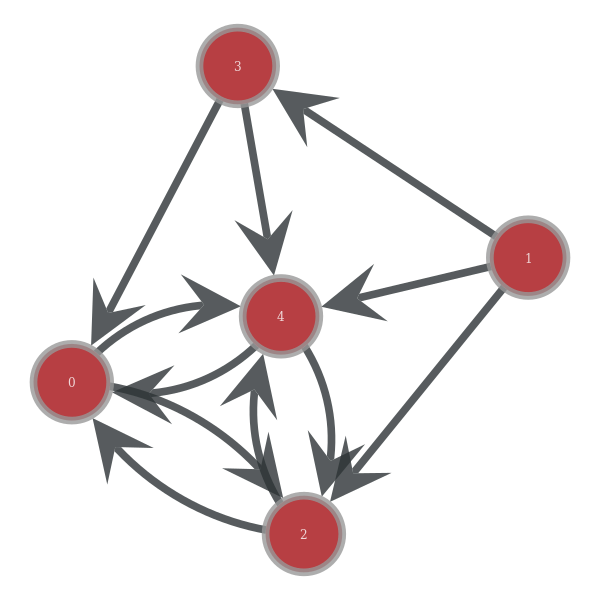

[set([0]), set([1]), set([2]), set([3]), set([4])]


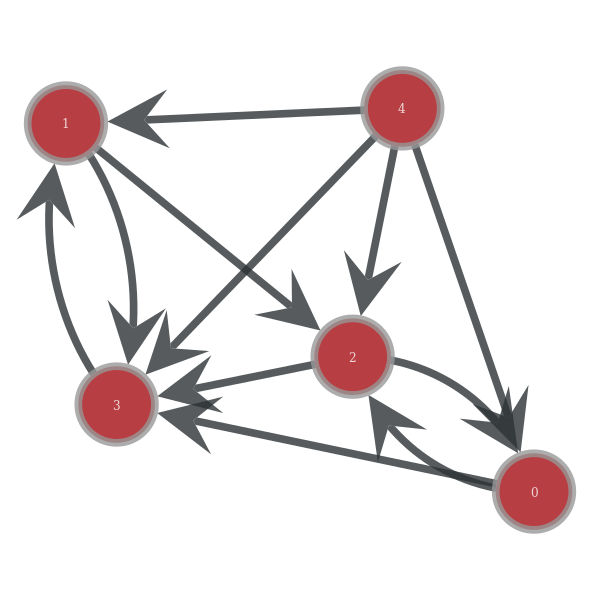

[set([0, 1]), set([2]), set([3]), set([4])]


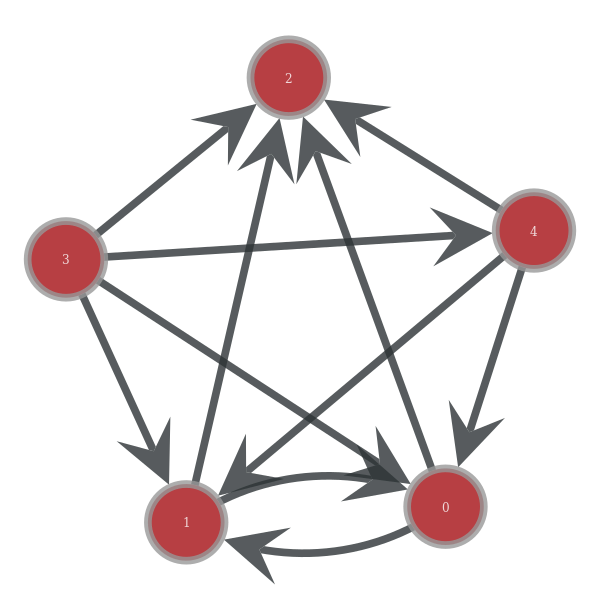

[set([0]), set([1]), set([2, 3]), set([4])]


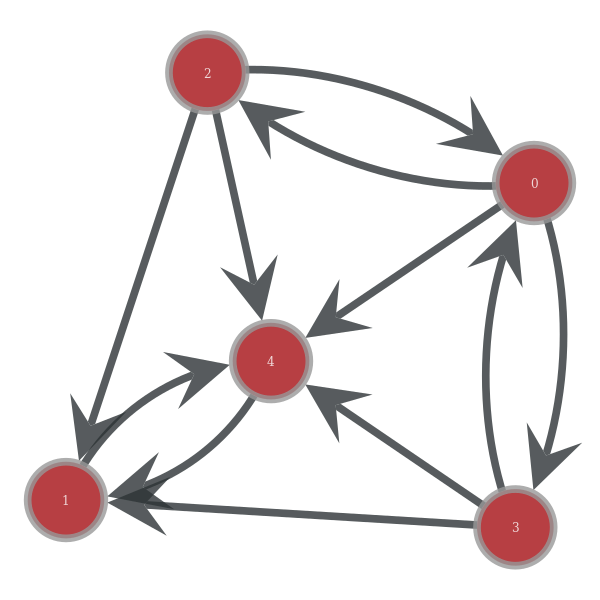

[set([0, 1]), set([2]), set([3]), set([4])]


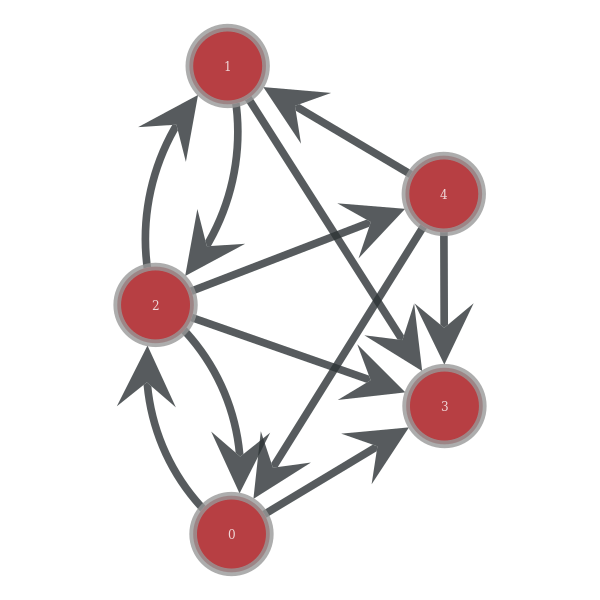

[set([0, 1]), set([2]), set([3]), set([4])]


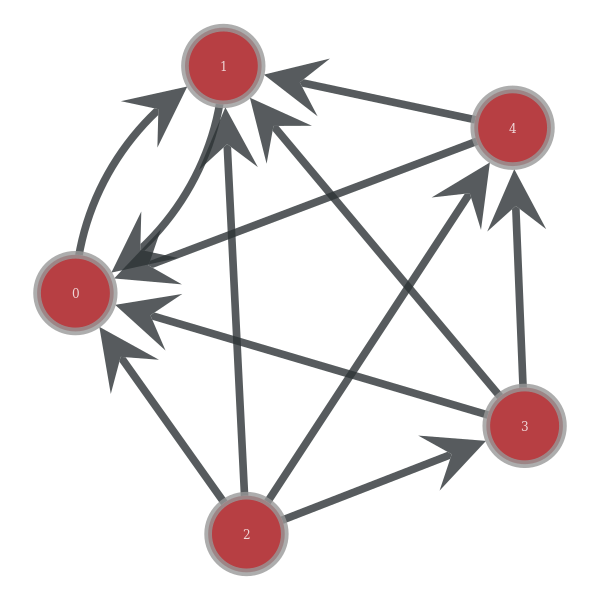

[set([0]), set([1]), set([2]), set([3]), set([4])]


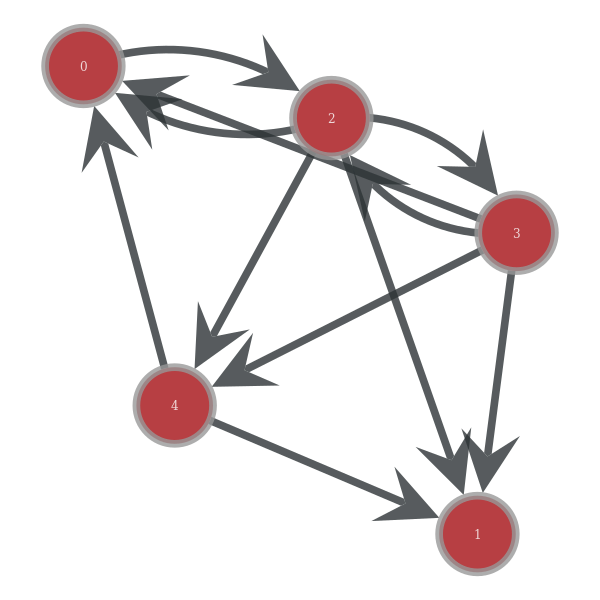

[set([0]), set([1]), set([2]), set([3]), set([4])]


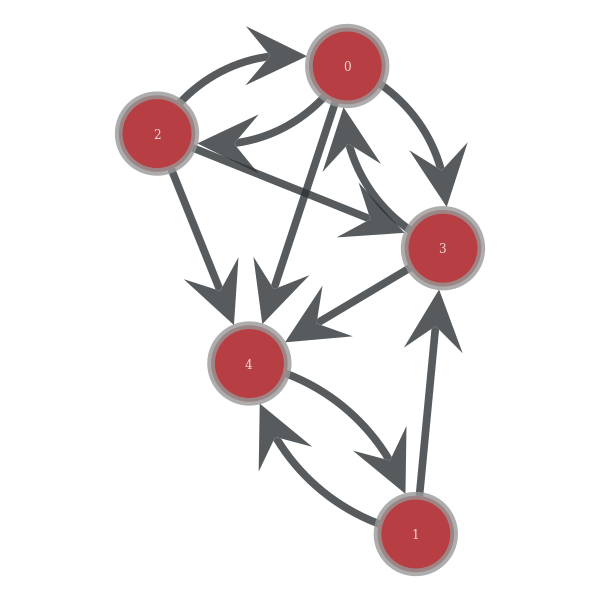

[set([0]), set([1]), set([2]), set([3, 4])]


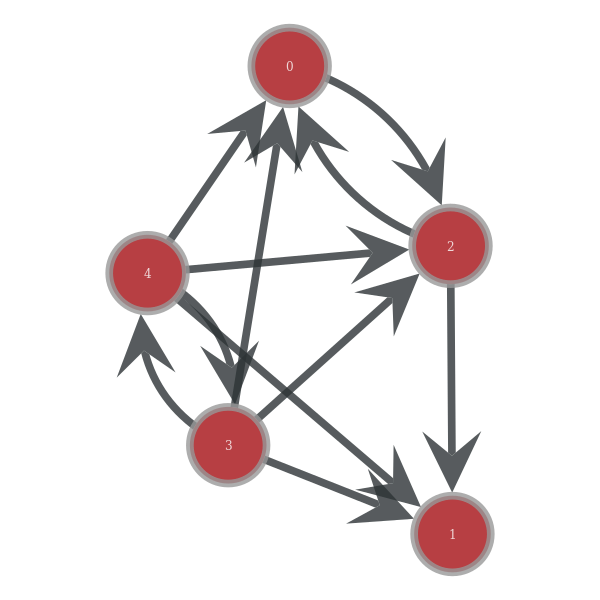

[set([0]), set([1]), set([2]), set([3]), set([4])]


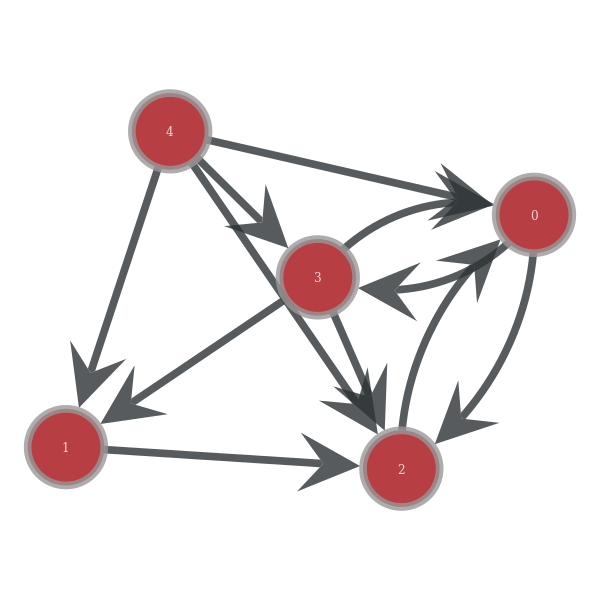

[set([0]), set([1]), set([2, 3]), set([4])]


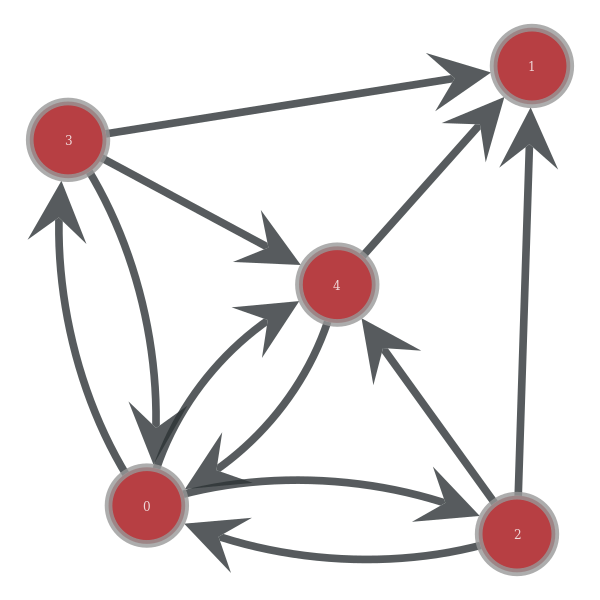

[set([0]), set([1]), set([2]), set([3]), set([4])]


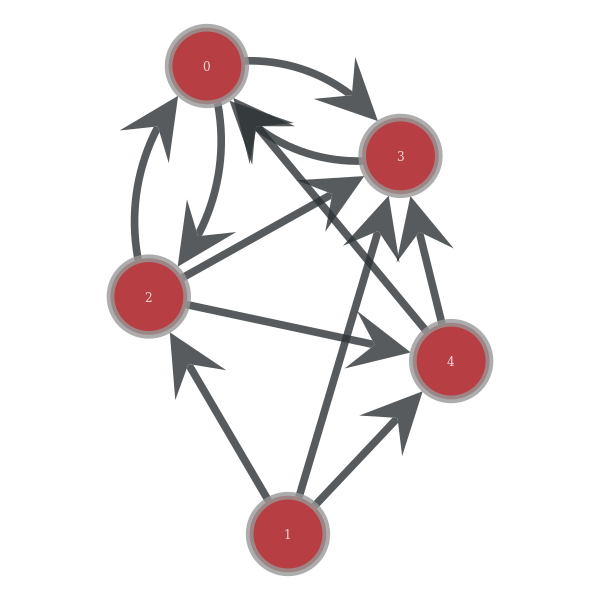

[set([0]), set([1]), set([2]), set([3]), set([4])]


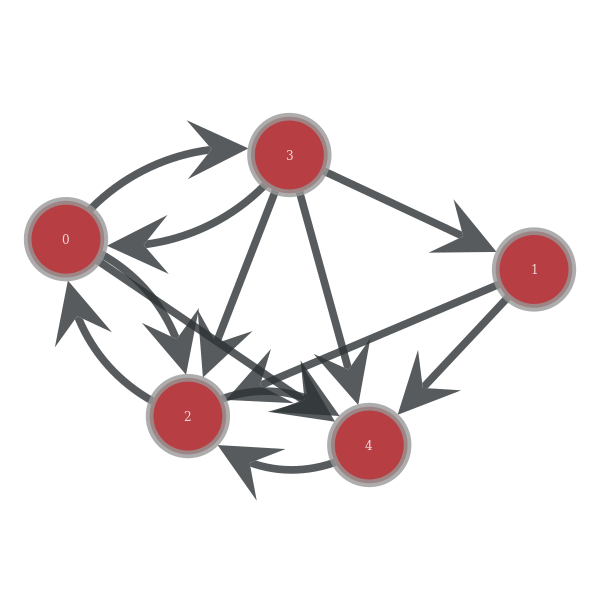

[set([0, 1]), set([2, 3]), set([4])]


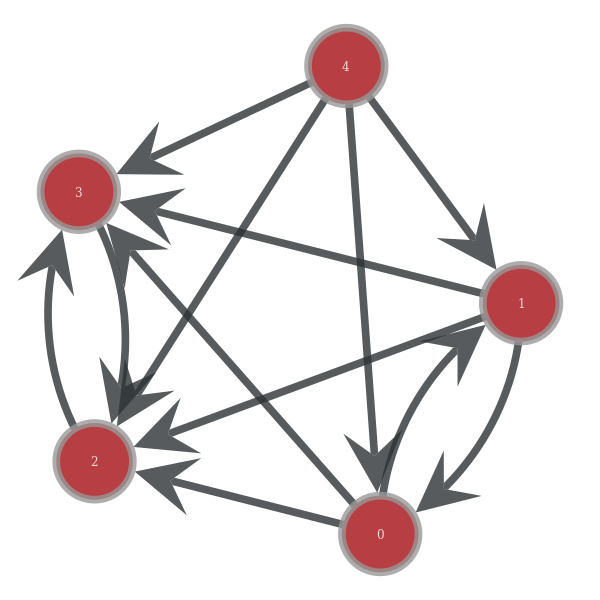

[set([0, 1]), set([2, 3, 4])]


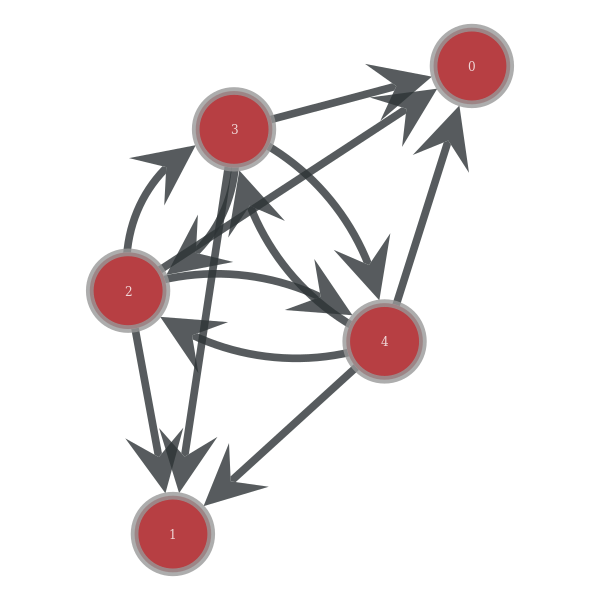

[set([0]), set([1]), set([2]), set([3]), set([4])]


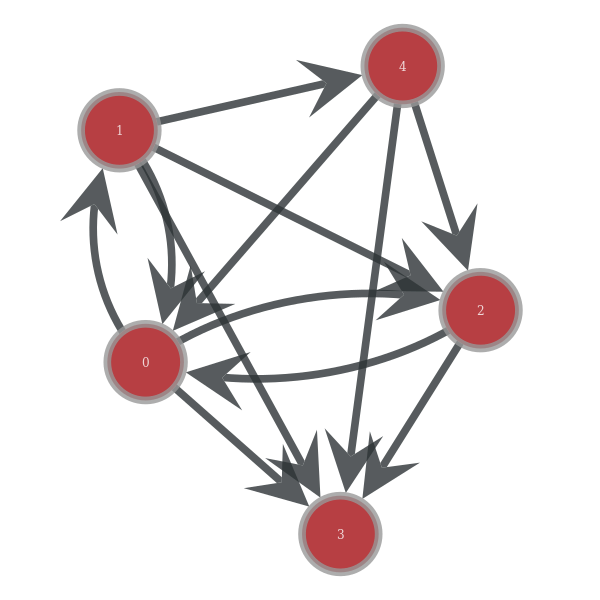

[set([0]), set([1]), set([2]), set([3]), set([4])]


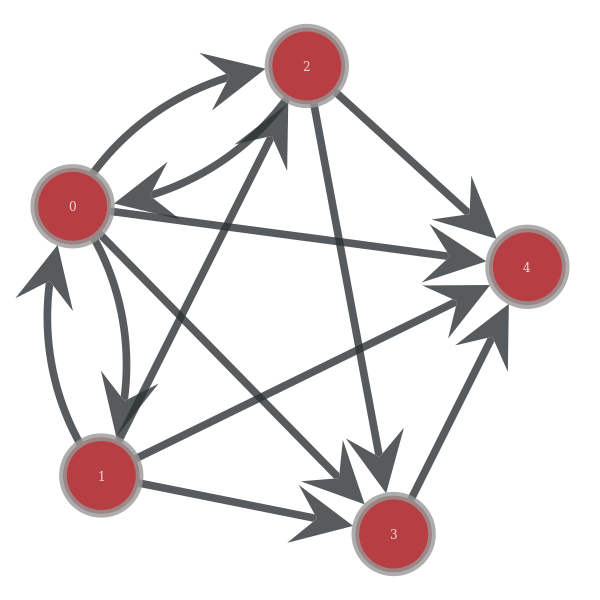

[set([0, 1]), set([2, 3]), set([4])]


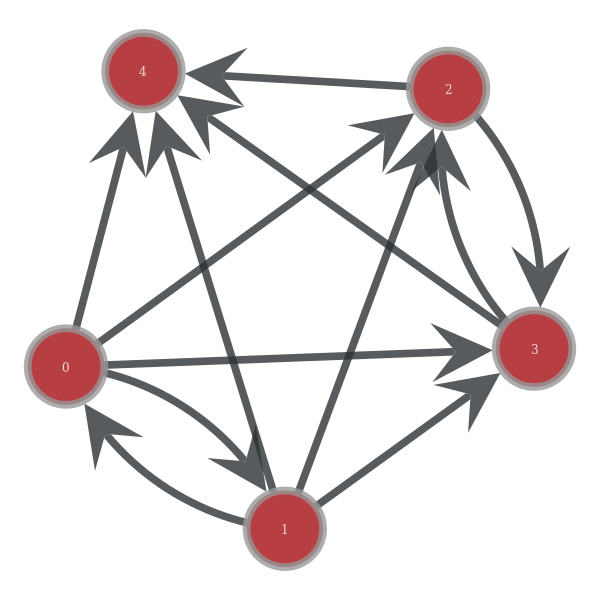

[set([0, 1]), set([2]), set([3]), set([4])]


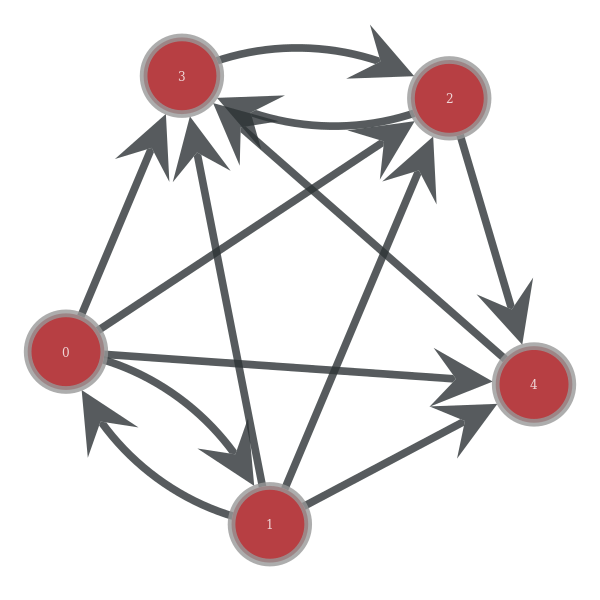

[set([0, 1, 2, 3]), set([4])]


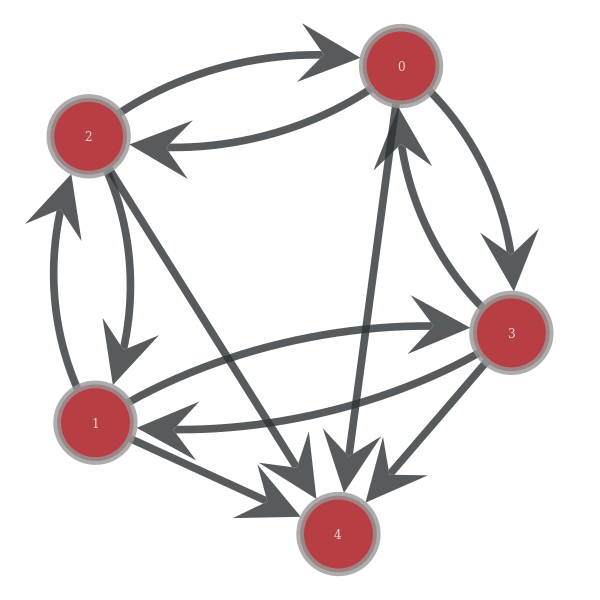

[set([0]), set([1]), set([2]), set([3]), set([4])]


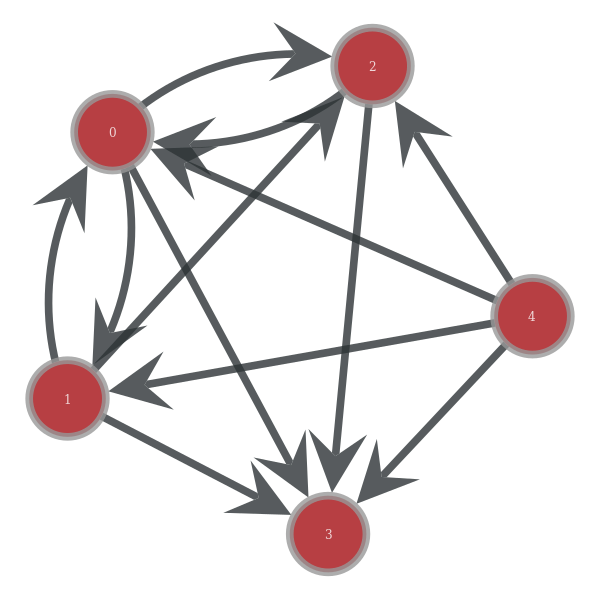

[set([0, 1]), set([2, 3, 4])]


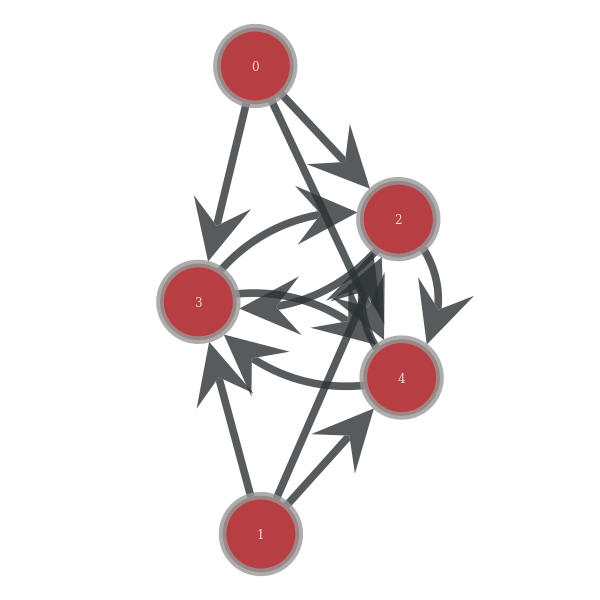

[set([0]), set([1]), set([2]), set([3]), set([4])]


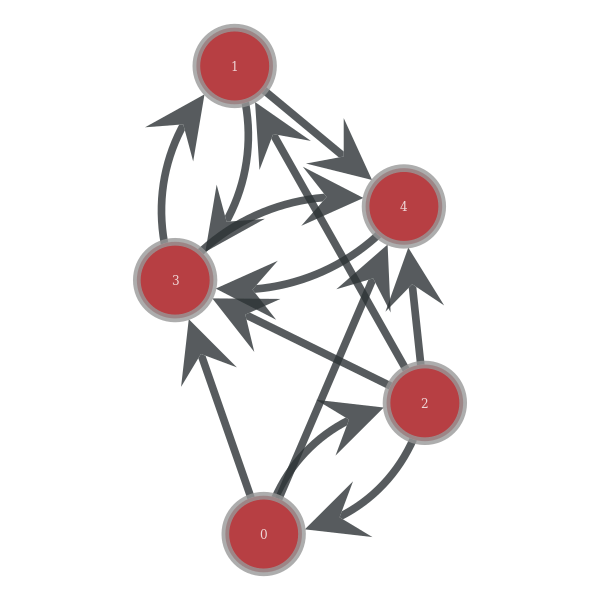

[set([0, 1, 2, 3]), set([4])]


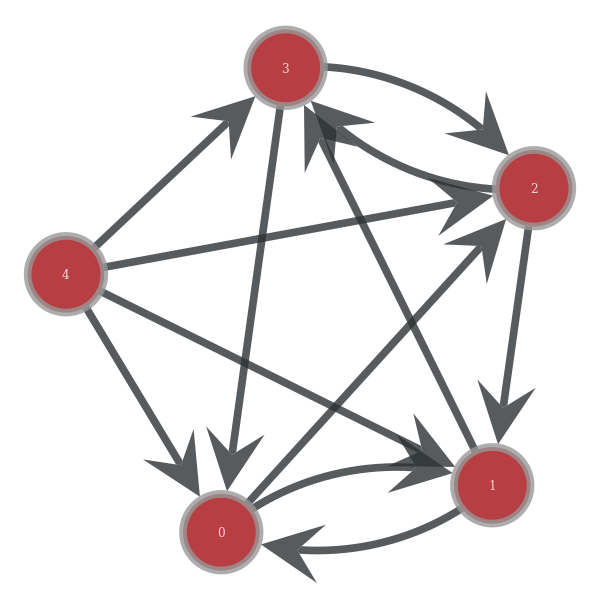

[set([0]), set([1]), set([2]), set([3]), set([4])]


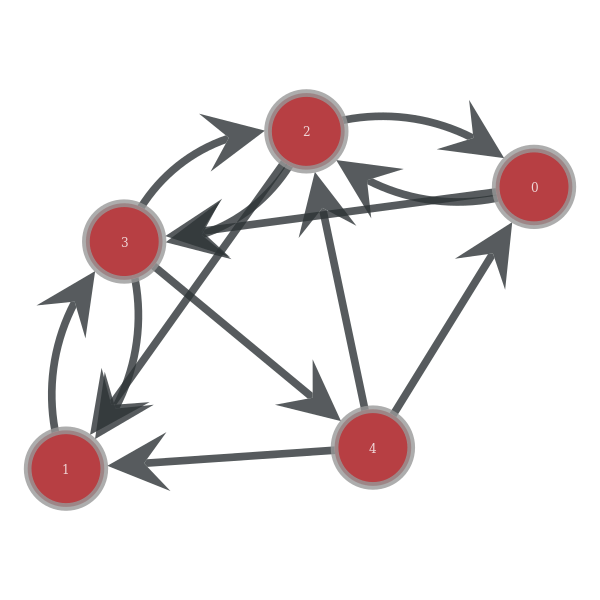

[set([0, 1, 2]), set([3]), set([4])]


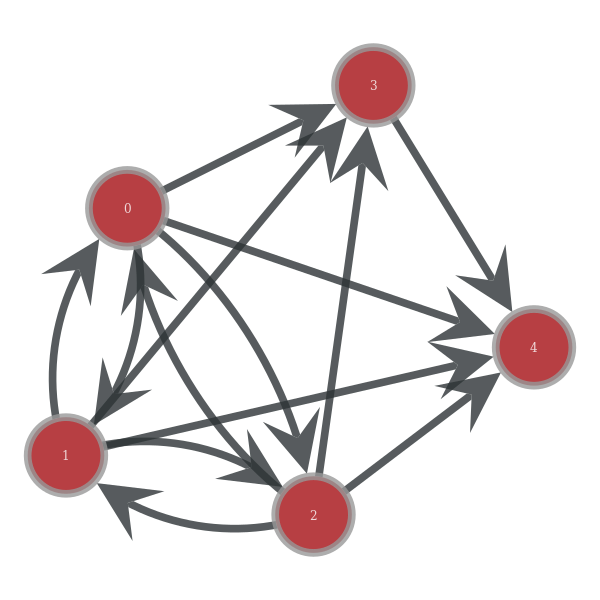

[set([0]), set([1]), set([2]), set([3]), set([4])]


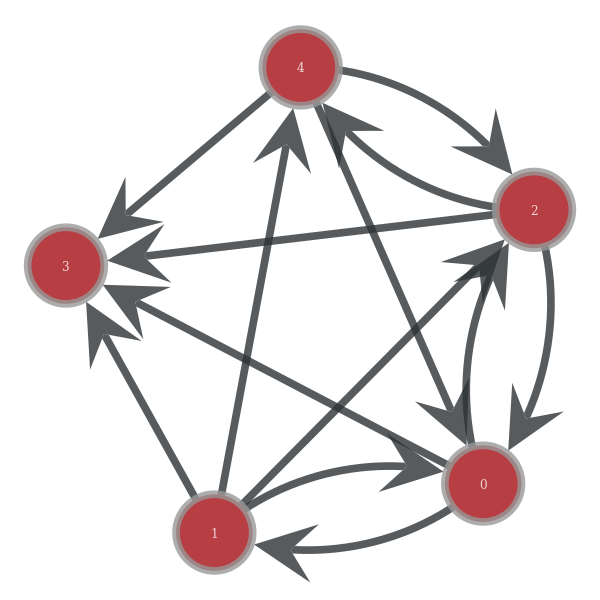

[set([0]), set([1]), set([2]), set([3, 4])]


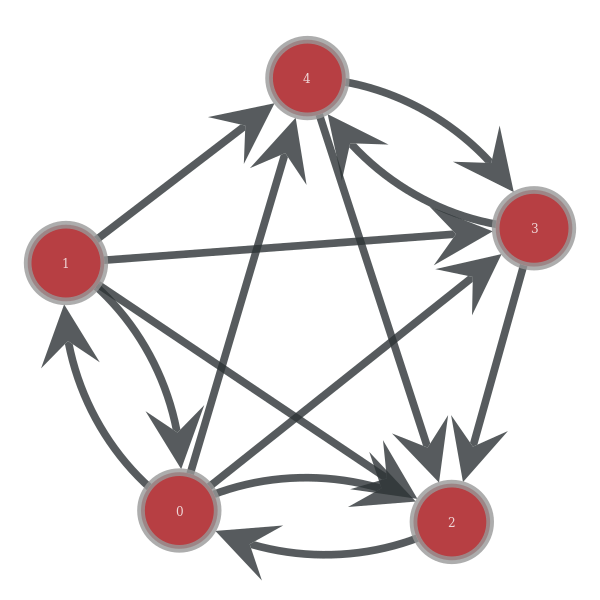

[set([0]), set([1]), set([2, 3]), set([4])]


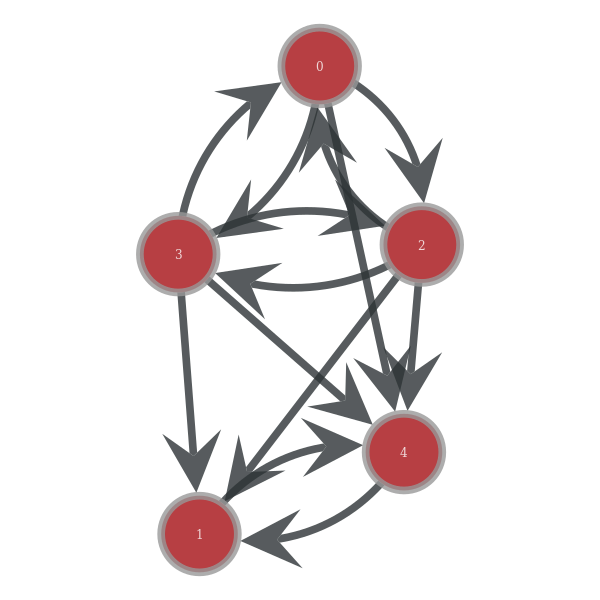

[set([0]), set([1]), set([2, 3]), set([4])]


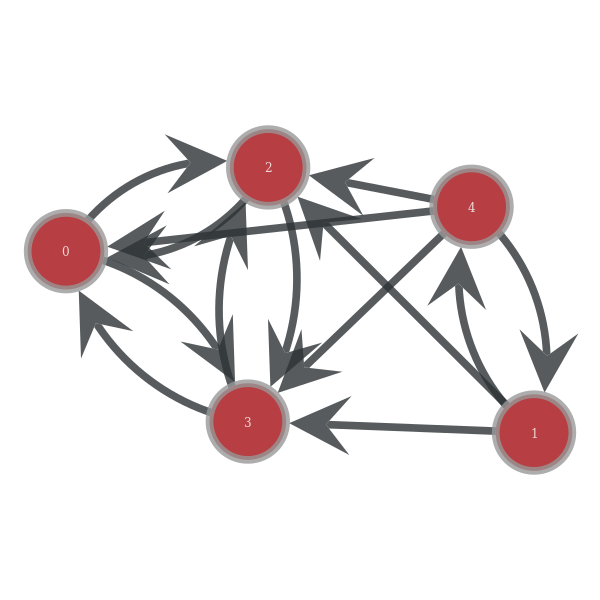

[set([0, 1, 2]), set([3]), set([4])]


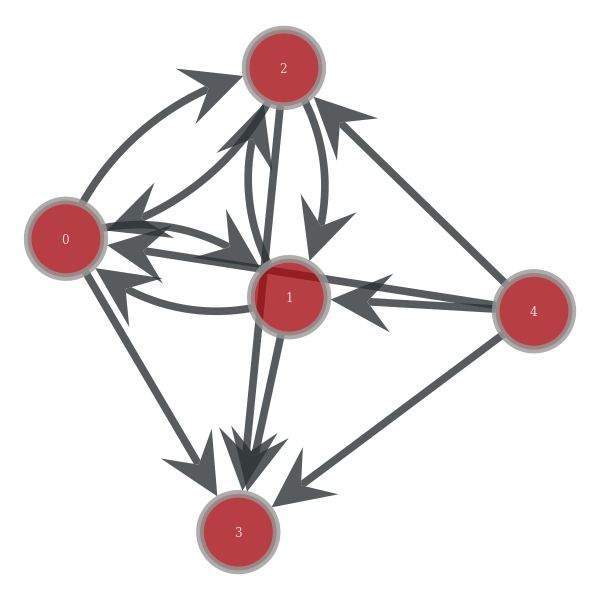

[set([0, 1, 2]), set([3]), set([4])]


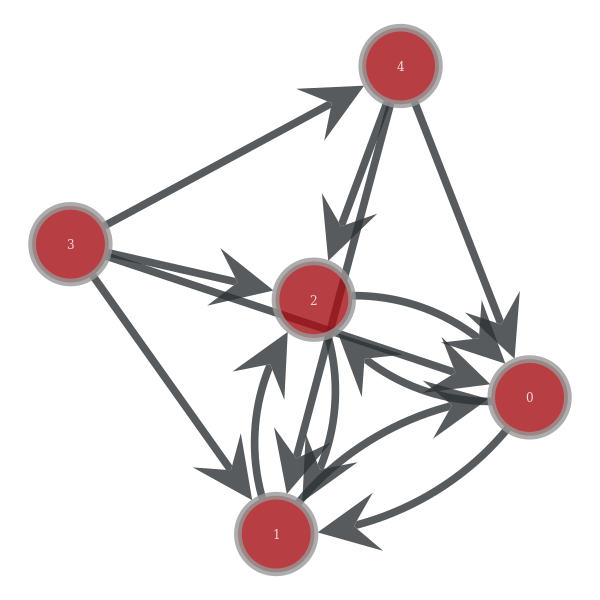

[set([0, 1]), set([2]), set([3]), set([4])]


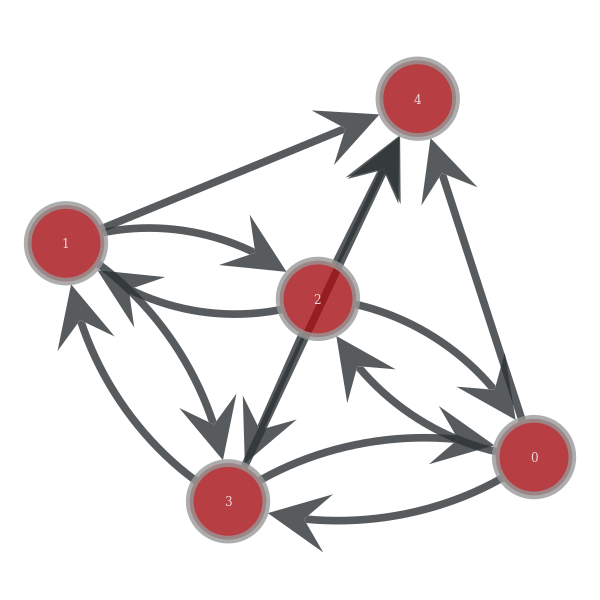

[set([0]), set([1]), set([2]), set([3]), set([4])]


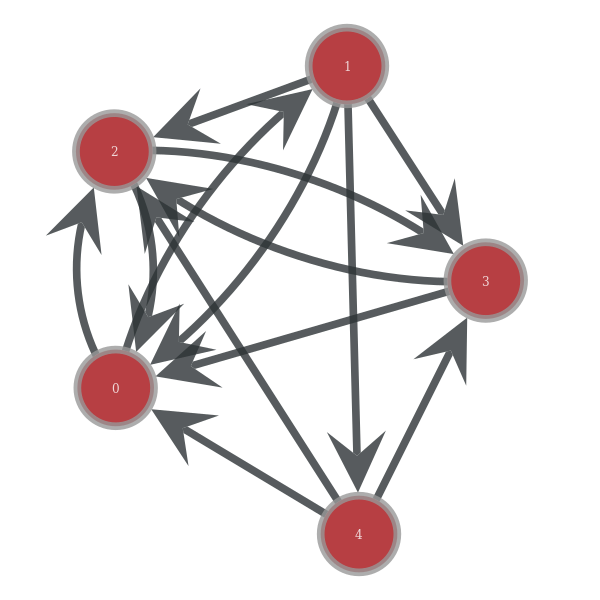

[set([0]), set([1]), set([2]), set([3, 4])]


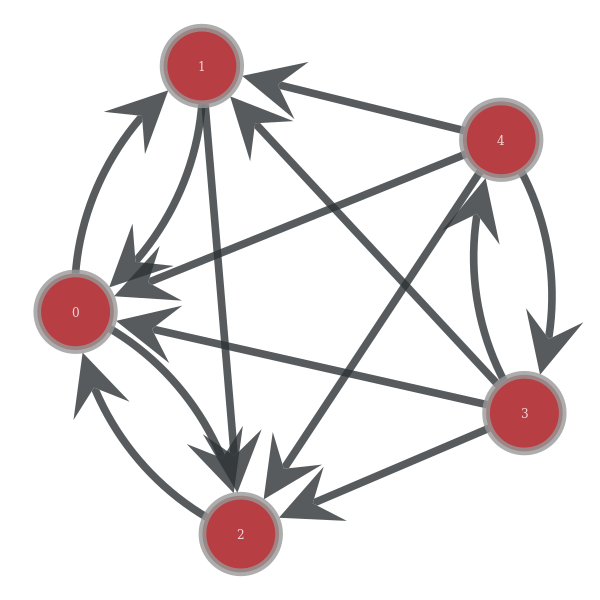

[set([0]), set([1]), set([2]), set([3]), set([4])]


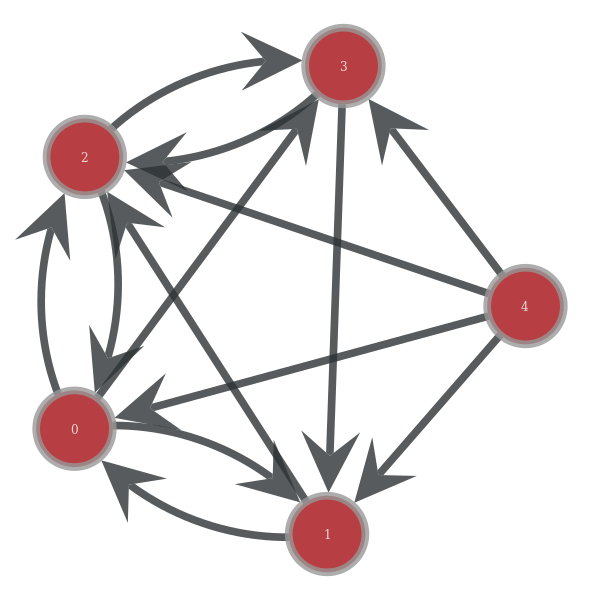

[set([0]), set([1]), set([2]), set([3]), set([4])]


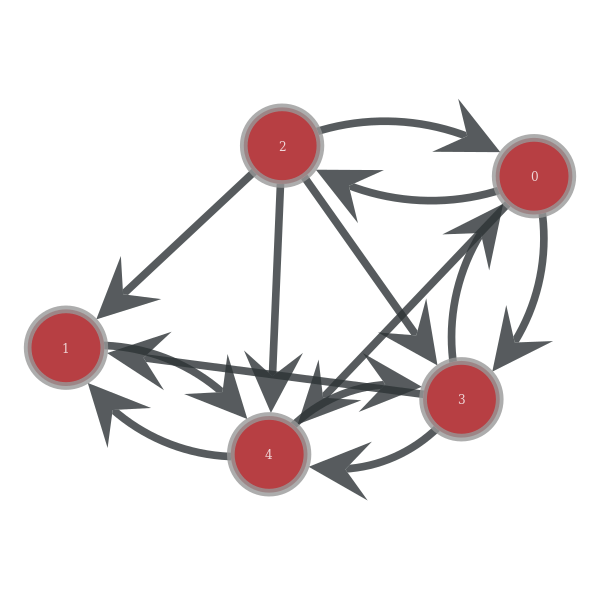

[set([0]), set([1]), set([2]), set([3]), set([4])]


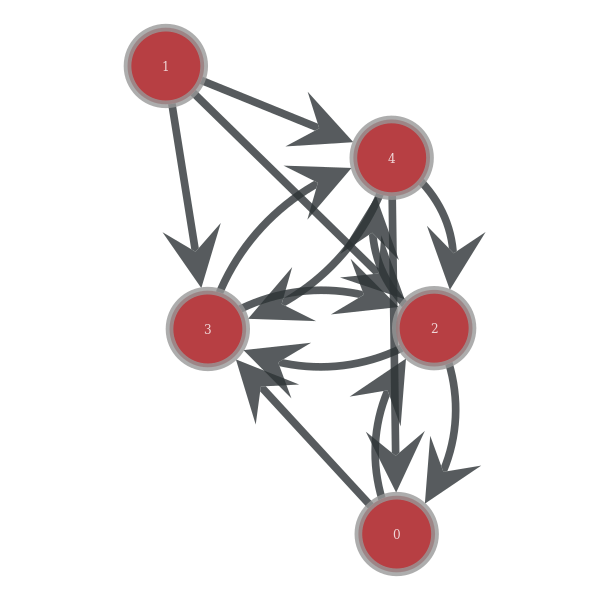

[set([0]), set([1]), set([2]), set([3]), set([4])]


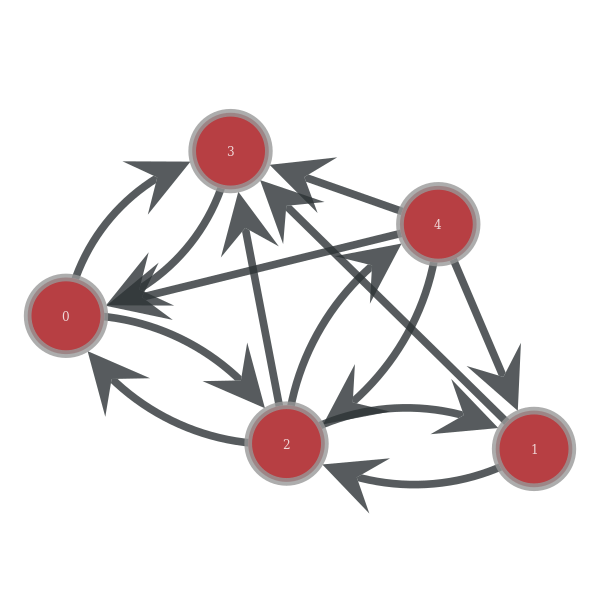

[set([0, 1, 2]), set([3, 4])]


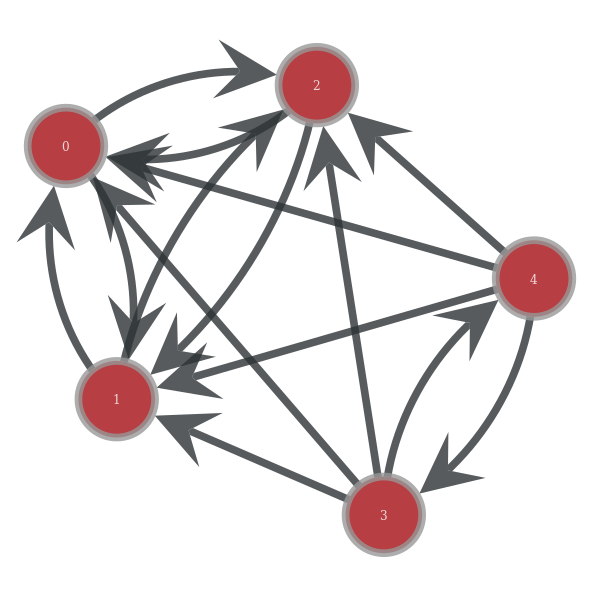

[set([0]), set([1]), set([2]), set([3]), set([4])]


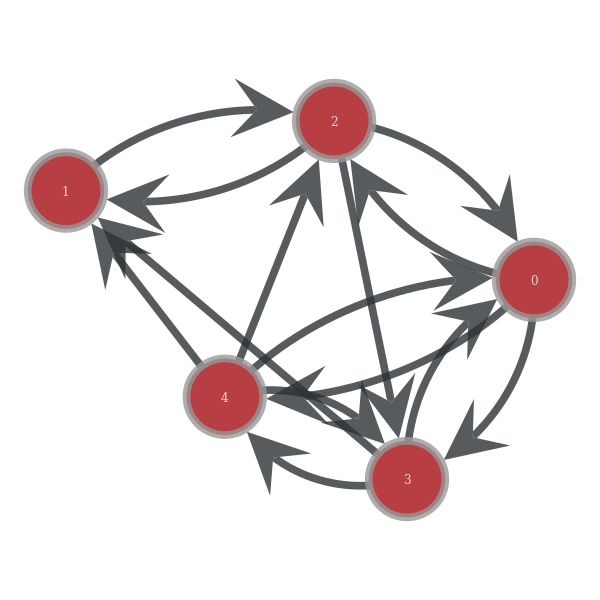

[set([0, 1]), set([2]), set([3, 4])]


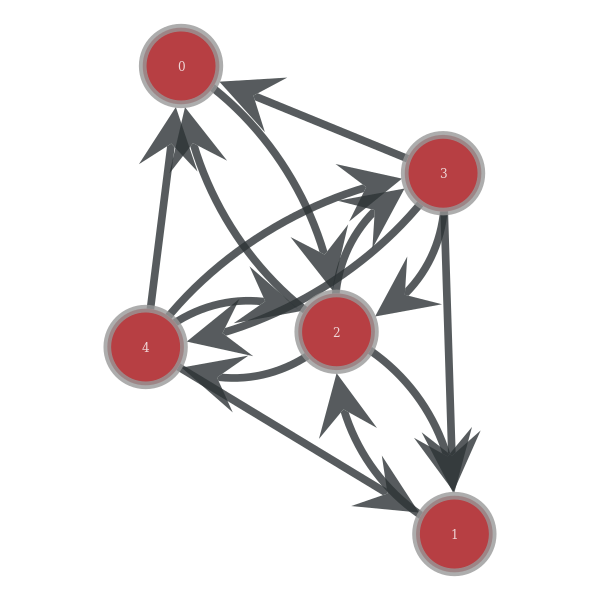

[set([0, 1, 2]), set([3, 4])]


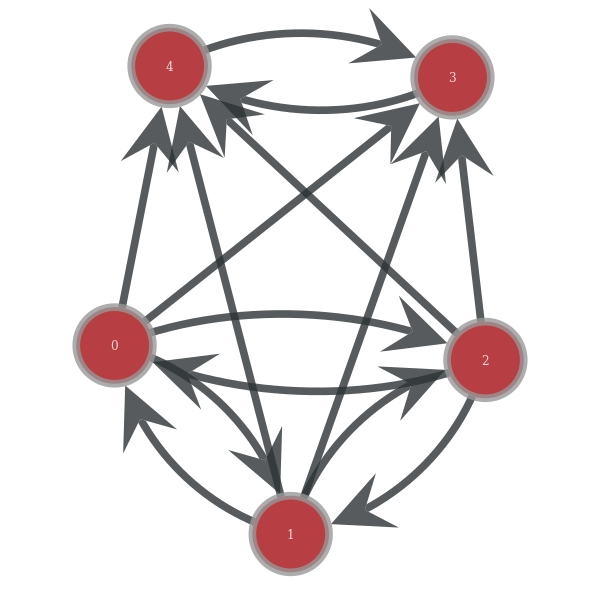

[set([0]), set([1, 2]), set([3]), set([4])]


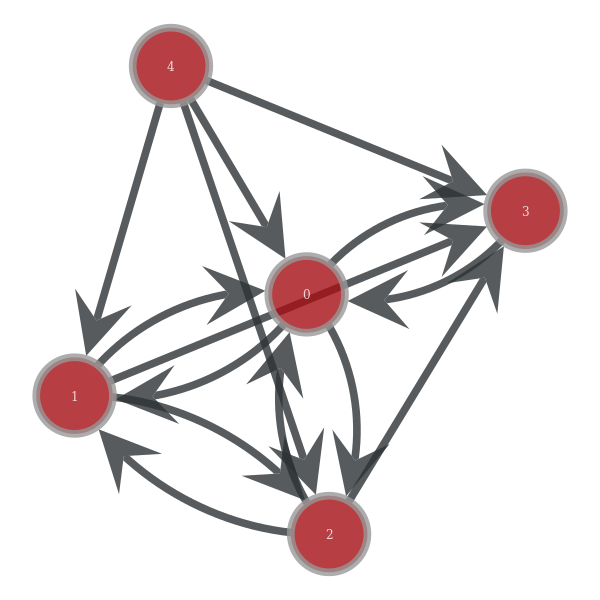

[set([0]), set([1]), set([2]), set([3]), set([4])]


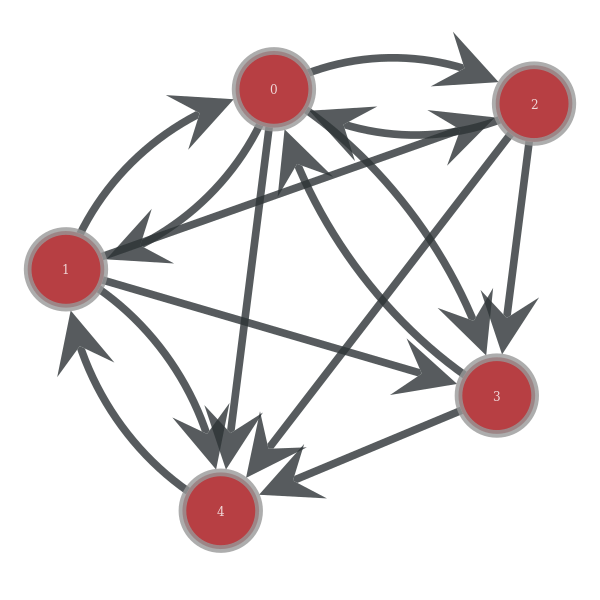

[set([0]), set([1]), set([2]), set([3]), set([4])]


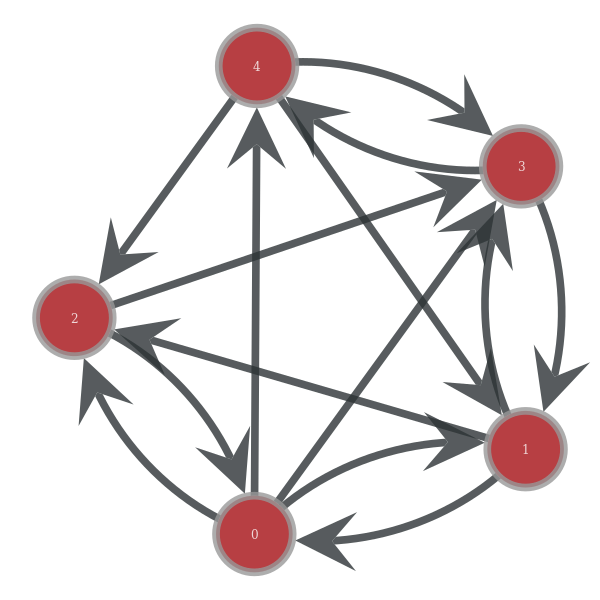

[set([0]), set([1]), set([2]), set([3]), set([4])]


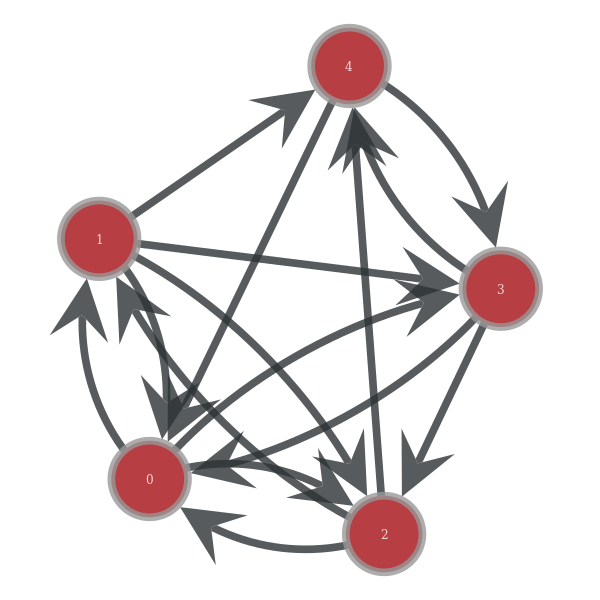

[set([0]), set([1]), set([2]), set([3]), set([4])]


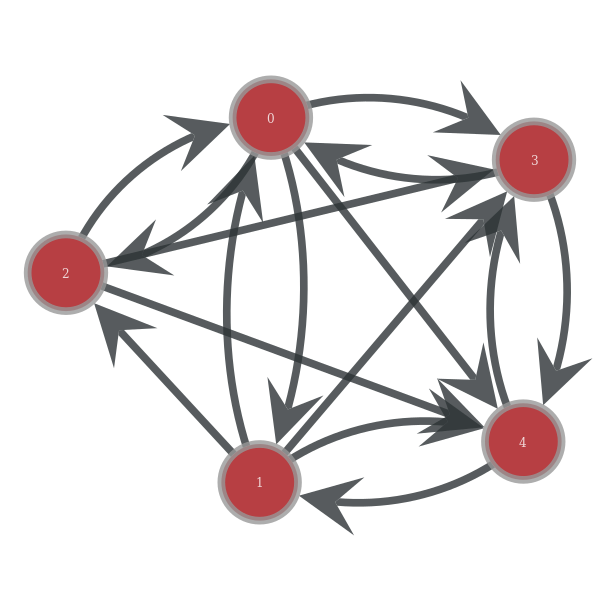

[set([0]), set([1]), set([2]), set([3]), set([4])]


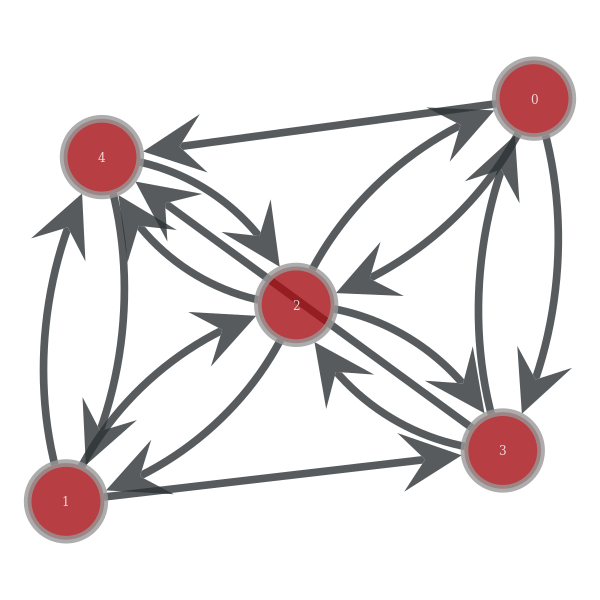

[set([0]), set([1, 2]), set([3]), set([4])]


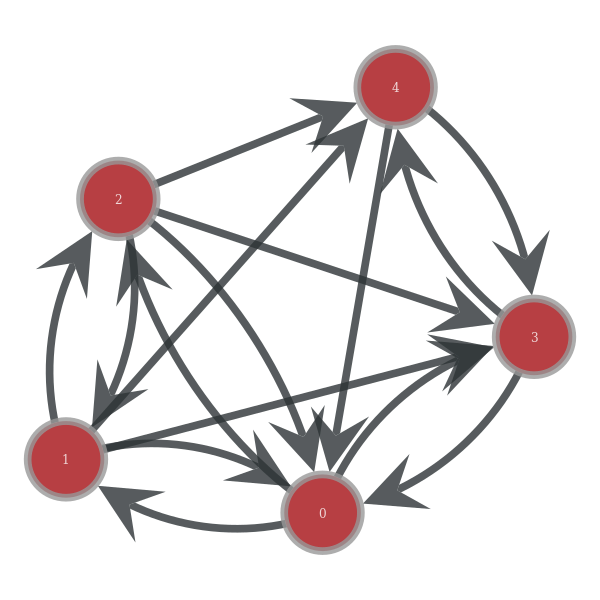

[set([0, 1]), set([2]), set([3]), set([4])]


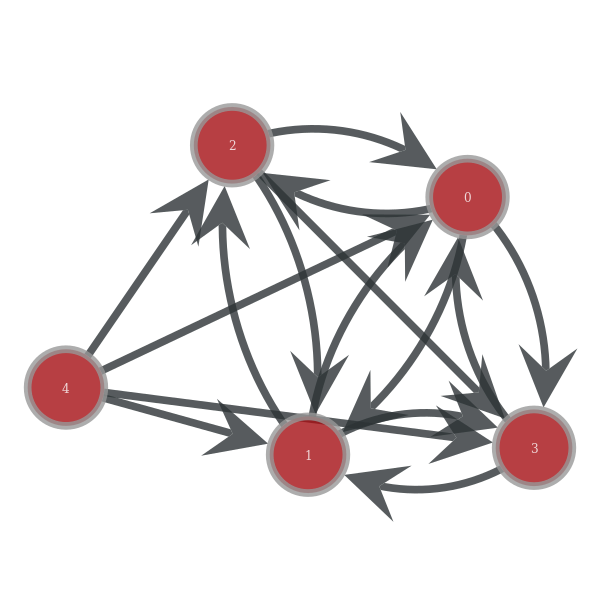

[set([0, 1]), set([2]), set([3]), set([4])]


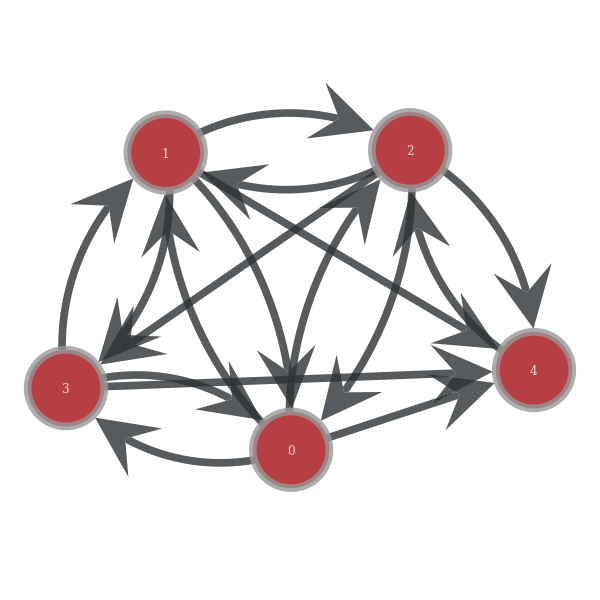

[set([0, 1]), set([2]), set([3]), set([4])]


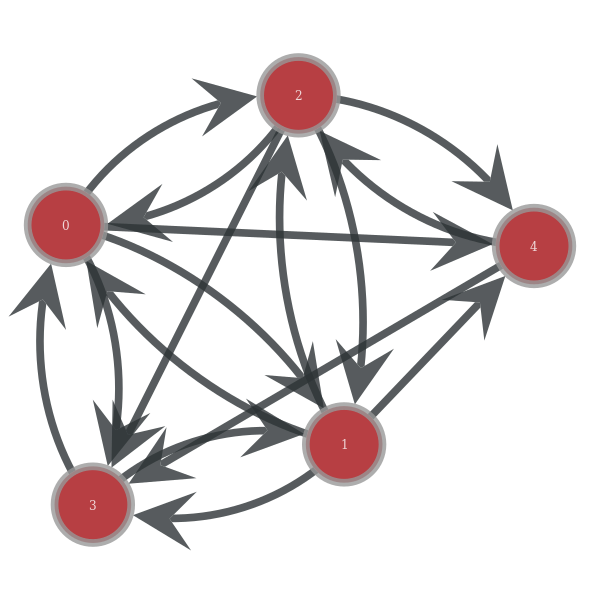

[set([0, 1, 2, 3]), set([4])]


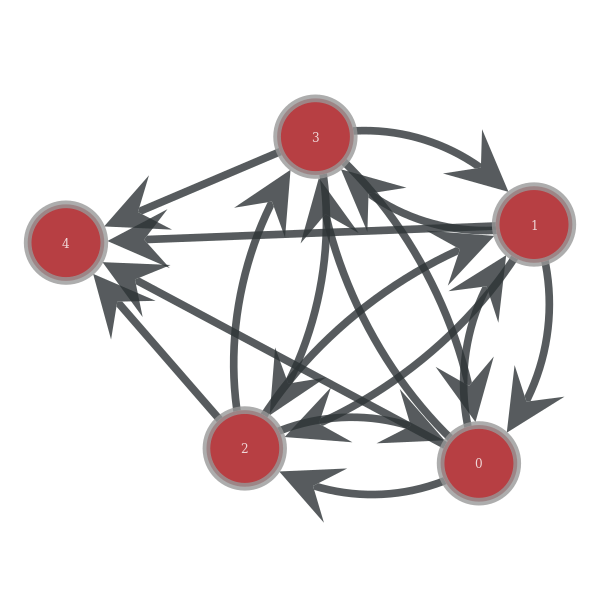

[set([0, 1, 2, 3]), set([4])]


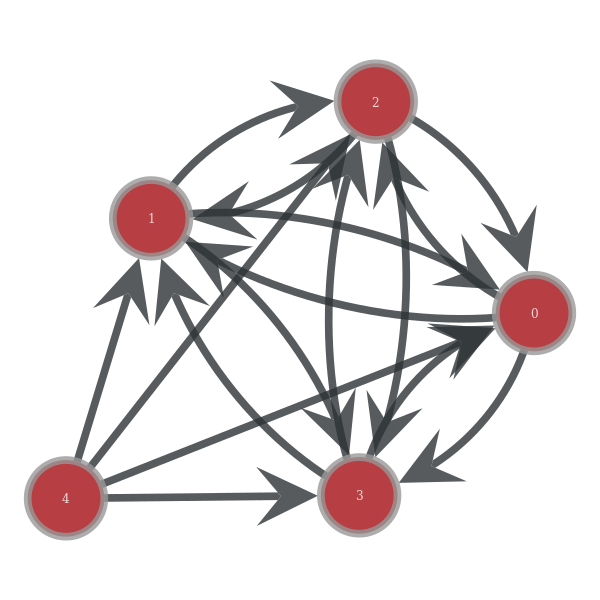

[set([0, 1]), set([2]), set([3]), set([4])]


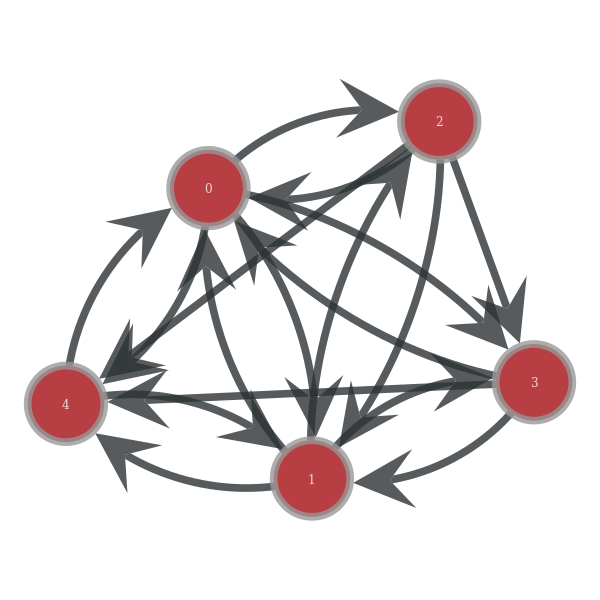

[set([0]), set([1, 2, 3]), set([4])]


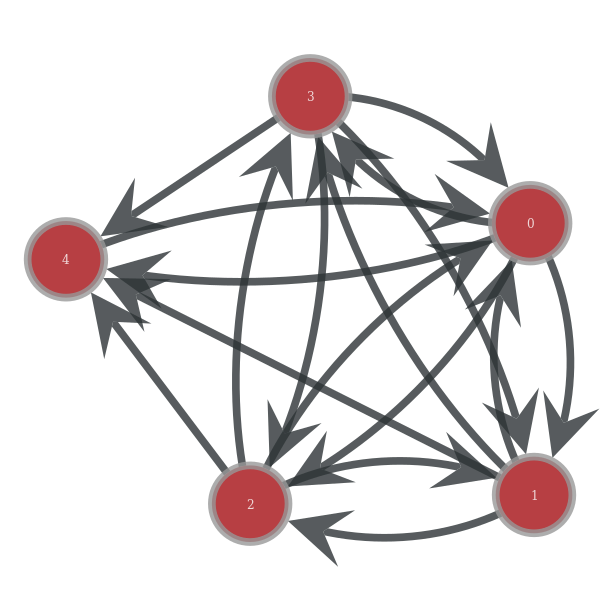

In [22]:
from graph_tool.draw import graph_draw
print len(MM)
for m in MM:
    ug = gt.GraphView(m)
    print m.gp.orbits
    graph_draw(ug,vertex_text=m.vertex_index.copy())

In [35]:
import cPickle as cp
th=open('celegans/celegansneural.gmlA_Dmotifs5ig','rb')
C=cp.load(th)
th.close()
VM=[c[0] for c in C]
M=[c[1] for c in C]
g=gt.collection.data['celegansneural']
gt.stats.remove_parallel_edges(g)
gt.stats.remove_self_loops(g)
#g=vmtoG(VM,M)
#g=load_graph('DiBrain/100307.gml')
#for v in ge.vertices():
 #   g.vp.pos[v]=[g.vp.pos[v][0]*5,g.vp.pos[v][1]]
#print g
#pos=arf_layout(g)
posxy=g.new_vertex_property('vector<float>')
g.vertex_properties['posxy']=posxy
for v in g.vertices():
    g.vp.posxy[v]=[g.vp.pos[v][1],g.vp.pos[v][0]]
G=ColorC(VM,M,g,g.vp.posxy,'celegansA.eps')
#G=ColorCS(VM,M,g,g.vp.posxy,range(len(M)-1))
G

<Graph object, directed, with 297 vertices and 2345 edges at 0x7f94429305d0>

In [30]:
f=open('DCconf/GDC1.gmlDC_Dmotifs5ig','rb')
fl='DCconfC-M'
os.mkdir(fl)
C=cp.load(f)
f.close()
C.sort(key=lambda d:d[1].num_edges())
from graph_tool.draw import graph_draw
print len(C)
i=0
for mm in C:
    colors=['r','b','c','g','m','y','k']
    m=mm[1]
    vh=m.new_vp('int',m.gp.orbmem)
    m.vp.vh=vh
    vc=m.new_vp('string')
    m.vp.vc=vc
    t=0
    for v in m.vertices():
        m.vp.vc[v]=colors[m.gp.orbmem[t]]
        t+=1  
    graph_draw(m,vertex_fill_color=m.vp.vc,inline=True,output=fl+'/M'+str(i)+'.pdf')
    print mm[1].gp.orbits,mm[1].gp.hom, len(mm[0])
    i+=1
    

6
[set([0]), set([1])] 1 500
[set([0, 1, 2])] 3 100
[set([0]), set([1]), set([2])] 1 100
[set([0, 1]), set([2, 3])] 4 100
[set([0, 1]), set([2, 3])] 2 100
[set([0, 1, 2, 3, 4])] 120 25


In [163]:
from graph_tool.collection import data
ge=data['celegansneural']
ge.list_properties()

description    (graph)   (type: string, val: Neural network: A directed,
                                             weighted network representing the
                                             neural network of C. Elegans. Data
                                             compiled by D. Watts and S.
                                             Strogatz and made available on the
                                             web `here <http://cdg.columbia.edu/
                                             cdg/datasets>`_. Please cite D. J.
                                             Watts and S. H. Strogatz, Nature
                                             393, 440-442 (1998). Original
                                             experimental data taken from J. G.
                                             White, E. Southgate, J. N.
                                             Thompson, and S. Brenner, Phil.
                                             Trans. R. Soc. London 314, 

In [97]:
list(plt.get_cmap('Set1')(0.4))

[0.67686276435852055, 0.34431373476982119, 0.51137256622314453, 1.0]

In [ ]:
cl=['b','r','c','g','violet','magenta','purple','pink','Orange','DarkOrange','b','c','g','violet','magenta','purple','cyan','gre','coral','r','b','c','g','violet','magenta','purple','pink','Orange','DarkOrange','b','c','g','violet','magenta','purple','cyan','gre','coral']
ecolor=G.new_edge_property('string')
G.edge_properties['color']=ecolor
wid=G.new_edge_property('float')
G.edge_properties['width']=wid
for e in G.edges():
    for i in range(len(M)-1):
        if G.edge_index[e] in cls[i]:
            ecolor[e]=cl[i]
            wid[e]=1
    if G.edge_index[e] in cls[len(M)-1]:
        ecolor[e]='LightGray'
        wid[e]=0.2
bl=G.new_edge_property('bool')
G.edge_properties['c']=bl
for e in G.edges():
    if ecolor[e]=='LightGray':
        bl[e]=False
    else:
        bl[e]=True
G.set_edge_filter(bl)

iso=G.new_vertex_property('bool')
sz=G.new_vertex_property('float')
for v in G.vertices():
    if v.in_degree()+v.out_degree():
        iso[v]=True
        sz[v]=5
    else:
        iso[v]=False
        sz[v]=2
G.set_vertex_filter(None)
pos = sfdp_layout(G,C=0.4,K=200)
G.set_edge_filter(None)
graph_draw(G,vertex_size=sz,edge_color=ecolor,edge_pen_width=wid,pos=pos, output_size=(600,600))
graph_draw(G,vertex_size=sz,edge_color=ecolor,edge_pen_width=wid,pos=pos, output_size=(600,600),output='/home/aew/Networks/'+name+'/'+folder+'/'+name+'1.pdf')
G.set_vertex_filter(iso)
G.set_edge_filter(None)
graph_draw(G,vertex_size=sz,edge_color=ecolor,edge_pen_width=wid,pos=pos, output_size=(600,600),output='/home/aew/Networks/'+name+'/'+folder+'/'+name+'2.pdf')

In [ ]:
for l in range(nr):
    for Gfile in q:
        start=time.time()
        M=list(M2)
        g=gt.load_graph(Gfile)
        g.clear_filters()
        gt.stats.remove_parallel_edges(g)
        gt.stats.remove_self_loops(g)
        print Gfile,g
        if Ctype not in ['DC','NO','H','A']:
            if Ctype=='F':
                break
            else:
                print 'Choose one of:',' DC,',' NO,',' H','F'
                break
        elif Ctype=='H':
            C=SIGoptCH(g,M,n)
        elif Ctype=='DC':
            C=SIGoptCFD(g,M,n)
        elif Ctype=='NO':
            C=SIGoptCFDNO(g,M,n)
        elif Ctype=='A':
            for m in M:
                m.gp.inf=-100
            C=SIGoptCFDA(g,M,n)

        th=open(Gfile+Ctype+'_'+Mfile+'igR'+str(l),'wb')
        cp.dump(C,th)
        th.close()
        end = time.time()
        print end-start

In [3]:
import pickle as cp
f=open('Dmotifs5','rb')
M=cp.load(f,encoding='binary')
f.close()
len(M)

LookupError: unknown encoding: binary

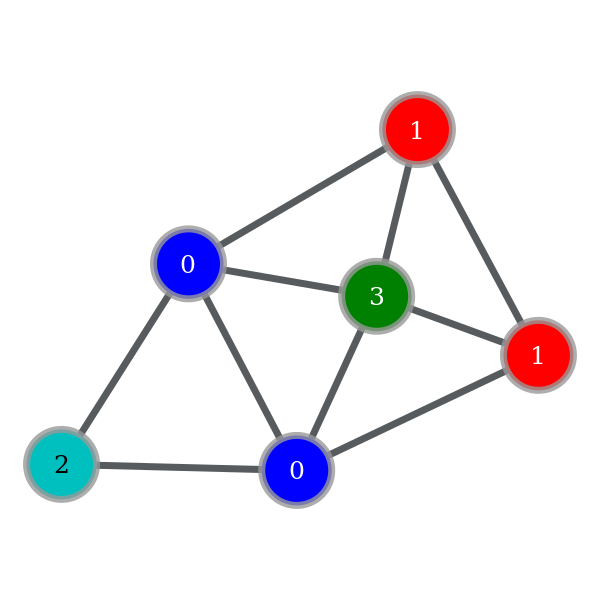

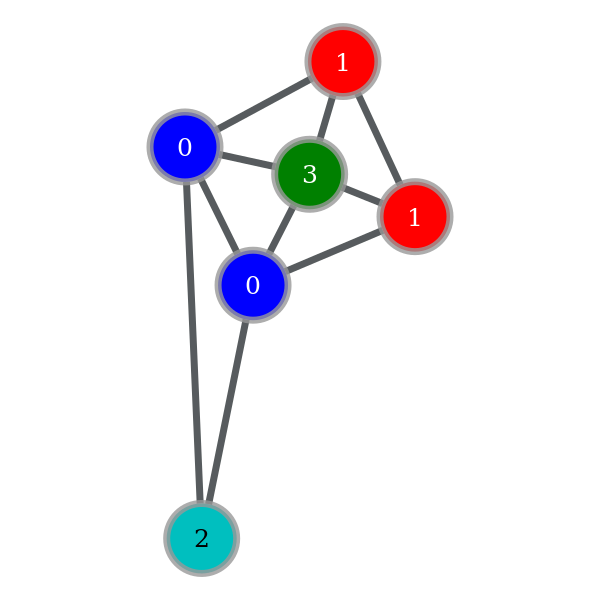

<PropertyMap object with key type 'Vertex' and value type 'vector<double>', for Graph 0x7fcfa41b4b10, at 0x7fd004480910>

In [45]:
colors=['b','r','c','g','m','y','k']
m=M[55]
vh=m.new_vp('int',m.gp.orbmem)
m.vp.vh=vh
vc=m.new_vp('string')
m.vp.vc=vc
t=0
for v in m.vertices():
    m.vp.vc[v]=colors[m.gp.orbmem[t]]
    t+=1  
    

    
graph_draw(m,vertex_fill_color=m.vp.vc,vertex_text=m.vp.vh,vertex_font_size=25,inline=True)
pos,r=interactive_window(m,vertex_fill_color=m.vp.vc,vertex_text=m.vp.vh,vertex_font_size=25,inline=True)

graph_draw(m,pos=pos,vertex_fill_color=m.vp.vc,vertex_text=m.vp.vh,vertex_font_size=25,inline=True)

In [5]:
M[5].list_properties()

P              (graph)   (type: double, val: 7.63181956218)
hom            (graph)   (type: int32_t, val: 2)
inG            (graph)   (type: bool, val: 1)
inf            (graph)   (type: double, val: 0.0)
orbits         (graph)   (type: python::object, val: [set([0, 2]), set([1]),
                                                     set([3])])
orbmem         (graph)   (type: vector<int32_t>, val: array([0, 1, 0, 2],
                                                      dtype=int32))


In [9]:
m.list_properties()
for v in m.vertices():
    print m.vp.vc[v]

P              (graph)   (type: double, val: 7.63181956218)
hom            (graph)   (type: int32_t, val: 2)
inG            (graph)   (type: bool, val: 1)
inf            (graph)   (type: double, val: 0.0)
orbits         (graph)   (type: python::object, val: [set([0, 2]), set([1]),
                                                     set([3])])
orbmem         (graph)   (type: vector<int32_t>, val: array([0, 1, 0, 2],
                                                      dtype=int32))
vc             (vertex)  (type: int32_t)
0
1
0
2


In [1]:
folder='c4year'
queries=get_queries(folder)
queries.sort()
MM=[]
ct=0
SNO={}
for q in queries:
    th=open(q+'H_Dmotifs3igH','rb')
    ct+=1
    C=cp.load(th)
    th.close()
    vm=[c[0] for c in C]
    m=[c[1] for c in C]
    g=vmtoG(vm,m)
    oivp = g.new_vertex_property("int",vals=g.vertex_index.copy())
    g.vp.OI=oivp
    cove=g.new_edge_property("bool",val=True)
    g.ep.covered=cove
    g.set_edge_filter(g.ep.covered)
    vorder = g.new_vertex_property("int")
    g.vp.vorder=vorder
    ed=g.new_graph_property("int",val=g.num_edges())
    g.gp.E=ed
    S0=SIGMAvmH(C,g)
    
    print S0
    SNO[q]=S0
    for m in C:
        if not sum([isomorphism(m[1],t) for t in MM]):
            MM.append(m[1])
            print len(MM),ct
print 'DONE'
MM.sort(key=lambda d: d.num_edges())
D={q:[0]*len(MM) for q in queries}
S={q:[0]*(len(MM)-1) for q in queries}
for q in queries:
    th=open(q+'H_Dmotifs3igH','rb')
    C=cp.load(th)
    th.close()
    s=sigproH(C)
    for i in range(len(MM)):
        for m in C:
            if isomorphism(m[1],MM[i]):
                D[q][i]=len(m[0])
        for l in range(len(s)):
            if isomorphism(s[l][0],MM[i]):
                S[q][i-1]=s[l][1]
        
from graph_tool.draw import graph_draw
print len(MM)
os.mkdir(folder+'-M3')
i=0
for m in MM:
    colors=['r','b','c','g','m','y','k']*10
    vh=m.new_vp('int',m.gp.orbmem)
    m.vp.vh=vh
    vc=m.new_vp('string')
    m.vp.vc=vc
    t=0
    for v in m.vertices():
        m.vp.vc[v]=colors[m.gp.orbmem[t]]
        t+=1  
    graph_draw(m,vertex_fill_color=m.vp.vc,inline=True,output=folder+'-M3/M'+str(i)+'.pdf')
    i+=1
import matplotlib.pyplot as plt
plt.axes().set_aspect('equal')
plt.close()
plt.clf()
plt.axis([1,len(MM)-1,0,1])
plt.ylabel(r'$\tilde{c}$',fontsize=20)
plt.xlabel('Motif id')
locs, labels = plt.xticks()
plt.xticks( range(1,(len(MM))) )
for k in queries:
    plt.plot(range(1,(len(MM))),S[k]/np.sqrt(sum([i**2 for i in S[k]])),label=k.split('/')[-1][:2])
plt.savefig(folder+'D3H.svg')

#plt.legend(loc=6)
#plt.show()
print SNO

NameError: name 'get_queries' is not defined

In [74]:
queries

['Honey/040900-201401.graphml',
 'Honey/040900-201402.graphml',
 'Honey/040900-201403.graphml',
 'Honey/040900-201404.graphml',
 'Honey/040900-201405.graphml',
 'Honey/040900-201406.graphml',
 'Honey/040900-201407.graphml',
 'Honey/040900-201408.graphml',
 'Honey/040900-201409.graphml',
 'Honey/040900-201410.graphml',
 'Honey/040900-201411.graphml',
 'Honey/040900-201412.graphml',
 'Honey/040900-201501.graphml',
 'Honey/040900-201502.graphml',
 'Honey/040900-201503.graphml',
 'Honey/040900-201504.graphml',
 'Honey/040900-201505.graphml',
 'Honey/040900-201506.graphml',
 'Honey/040900-201507.graphml',
 'Honey/040900-201508.graphml',
 'Honey/040900-201509.graphml',
 'Honey/040900-201510.graphml',
 'Honey/040900-201511.graphml',
 'Honey/040900-201512.graphml',
 'Honey/040900-201601.graphml',
 'Honey/040900-201602.graphml',
 'Honey/040900-201603.graphml',
 'Honey/040900-201604.graphml',
 'Honey/040900-201605.graphml',
 'Honey/040900-201606.graphml',
 'Honey/040900-201607.graphml',
 'Honey/

<IPython.core.display.Javascript object>


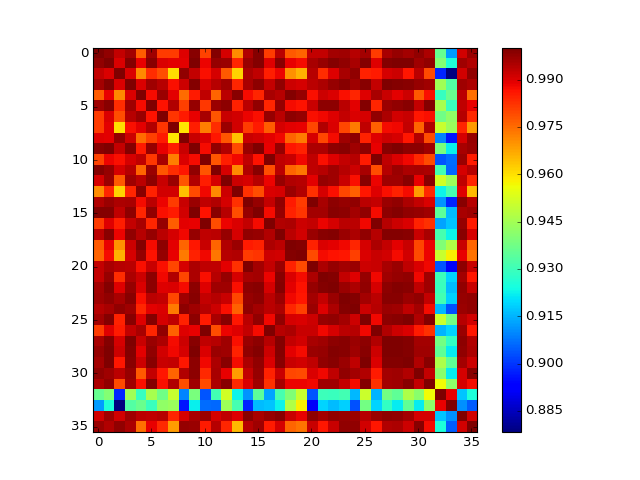

In [98]:
plt.close()
sim=np.zeros((len(queries),len(queries)))
for i in range(len(queries)):
    sim[i][i]=1
    for j in range(i,len(queries)):
        sim[i][j]=np.inner(norm(S[queries[i]]),norm(S[queries[j]]))
        sim[j][i]=sim[i][j]
plt.imshow(sim, interpolation='nearest')
plt.colorbar()
plt.show()

In [99]:
plt.savefig(folder+'D3Hheatmap.svg')


In [52]:
sim

array([[  36193.36657723,   82676.87659418,   70534.16414568, ...,
          44288.49463638,   52602.24989553,   52402.99196322],
       [  82676.87659418,  359599.99411889,  324123.40755912, ...,
         115020.28964126,  146578.34190002,  142880.29935274],
       [  70534.16414568,  324123.40755912,  297897.43681961, ...,
         100627.617763  ,  130083.37714935,  125173.60778238],
       ..., 
       [  44288.49463638,  115020.28964126,  100627.617763  , ...,
          55766.68579702,   67383.29313799,   66447.35373204],
       [  52602.24989553,  146578.34190002,  130083.37714935, ...,
          67383.29313799,   83088.69591874,   81520.15820185],
       [  52402.99196322,  142880.29935274,  125173.60778238, ...,
          66447.35373204,   81520.15820185,   80649.64827315]])

In [58]:
def norm(v):
    return v/np.sqrt(sum([i**2 for i in v]))

In [35]:
g=gt.load_graph('budapest_connectome_3.0_126_0_median.graphml')
g

<Graph object, undirected, with 1015 vertices and 3083 edges, 5 internal vertex properties, 2 internal edge properties, at 0x7fe4f2531898>

350.985966464
1 1
2 1
356.778440364
3 2
4 2
325.382330125
314.590798175
5 4
304.998520052
305.549305391
442.128752792
442.322552893
440.937453422
449.346057509
440.00495173
449.957991997
6 12
202.928934312
211.871796016
7 14
166.517504647
182.404355798
177.87662532
177.87662532
277.122154525
275.076593794
231.665263598
231.665263598
194.591427212
194.591427212
615.269237335
613.778555429
8 26
581.173813599
589.593816171
645.206614561
629.706830788
823.180732631
798.685790043
1023.09816182
1000.38279486
1057.93614835
956.370148572
475.558498844
451.306957745
532.719622824
502.27223158
496.919426447
495.568301339
516.542577342
513.02228616
572.296212899
575.541020058
572.296212899
565.690203467
619.287159393
609.41587147
605.819086355
587.254592456
592.619287378
587.758137825
422.450591286
427.042927724
395.507503543
399.259811938
377.633673945
380.956592798
204.203863005
210.509912337
235.926865466
247.071520998
214.402046372
220.814369909
572.719043902
576.129058406
542.290219769
535.7

<IPython.core.display.Javascript object>


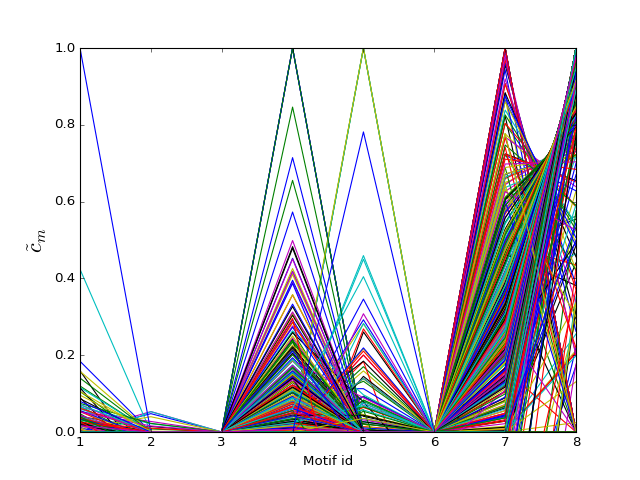

/usr/local/lib/python2.7/dist-packages/ipykernel/__main__.py:64: RuntimeWarning: invalid value encountered in divide


{'c4year/1803year/1803_2014.gmlH_BDmotifs3igH': 489.9492763046228, 'c4year/1003year/1003_2015.gmlA_BDmotifs3igH': 573.2720986911808, 'c4year/0814year/0814_2014.gmlH_BDmotifs3igH': 418.25752141478654, 'c4year/0807year/0807_2015.gmlH_BDmotifs3igH': 473.5759885735375, 'c4year/1515year/1515_2014.gmlA_BDmotifs3igH': 1229.9771285792629, 'c4year/0103year/0103_2015.gmlH_BDmotifs3igH': 182.4043557983694, 'c4year/0305year/0305_2014.gmlH_BDmotifs3igH': 747.5338718087539, 'c4year/0101year/0101_2015.gmlH_BDmotifs3igH': 314.5907981748363, 'c4year/2203year/2203_2014.gmlH_BDmotifs3igH': 947.9398791658041, 'c4year/0807year/0807_2014.gmlA_BDmotifs3igH': 459.12030015730477, 'c4year/0103year/0103_2016.gmlA_BDmotifs3igH': 177.87662532025962, 'c4year/1211year/1211_2014.gmlH_BDmotifs3igH': 1366.1999159687466, 'c4year/1104year/1104_2014.gmlA_BDmotifs3igH': 952.8181019588616, 'c4year/0306year/0306_2015.gmlA_BDmotifs3igH': 897.3730368758829, 'c4year/0910year/0910_2015.gmlA_BDmotifs3igH': 1588.4419987049264, 'c4

In [19]:
folder='c4year'
queries=get_queries_S(folder,'_BDmotifs3igH')
MM=[]
ct=0
SDC={}
for q in queries:
    th=open(q,'rb')
    ct+=1
    C=cp.load(th)
    th.close()
    vm=[c[0] for c in C]
    m=[c[1] for c in C]
    g=vmtoG(vm,m)
    oivp = g.new_vertex_property("int",vals=g.vertex_index.copy())
    g.vp.OI=oivp
    cove=g.new_edge_property("bool",val=True)
    g.ep.covered=cove
    g.set_edge_filter(g.ep.covered)
    vorder = g.new_vertex_property("int")
    g.vp.vorder=vorder
    ed=g.new_graph_property("int",val=g.num_edges())
    g.gp.E=ed
    S0=SIGMAvmH(C,g)
    
    print S0
    SDC[q]=S0
    for m in C:
        if not sum([isomorphism(m[1],t) for t in MM]):
            MM.append(m[1])
            print len(MM),ct
print 'DONE'
MM.sort(key=lambda d: d.num_edges())
D={q:[0]*len(MM) for q in queries}
S={q:[0]*(len(MM)-1) for q in queries}
for q in queries:
    th=open(q,'rb')
    C=cp.load(th)
    th.close()
    s=sigproH(C)
    for i in range(len(MM)):
        for m in C:
            if isomorphism(m[1],MM[i]):
                D[q][i]=len(m[0])
        for l in range(len(s)):
            if isomorphism(s[l][0],MM[i]):
                S[q][i-1]=s[l][1]
        
from graph_tool.draw import graph_draw
print len(MM)
Mfolder=folder+'HD3'
#os.mkdir(Mfolder)

for i in range(len(MM)):
    graph_draw(MM[i],vertex_text=MM[i].vertex_index.copy(),output=Mfolder+'/M'+str(i)+'.pdf')                   
import matplotlib.pyplot as plt
plt.close()
plt.clf()
plt.axis([1,len(MM)-1,0,1])
plt.ylabel(r'$\tilde{c}_m$',fontsize=20)
plt.xlabel('Motif id')
locs, labels = plt.xticks()
plt.xticks( range(1,(len(MM))) )
for k in queries:
    plt.plot(range(1,(len(MM))),S[k]/np.sqrt(sum([i**2 for i in S[k]])),label=k.split('/')[-1][:2])
plt.savefig(folder+'HD3.eps')

#plt.legend(loc=6)
plt.show()
print SDC
#print D

<IPython.core.display.Javascript object>


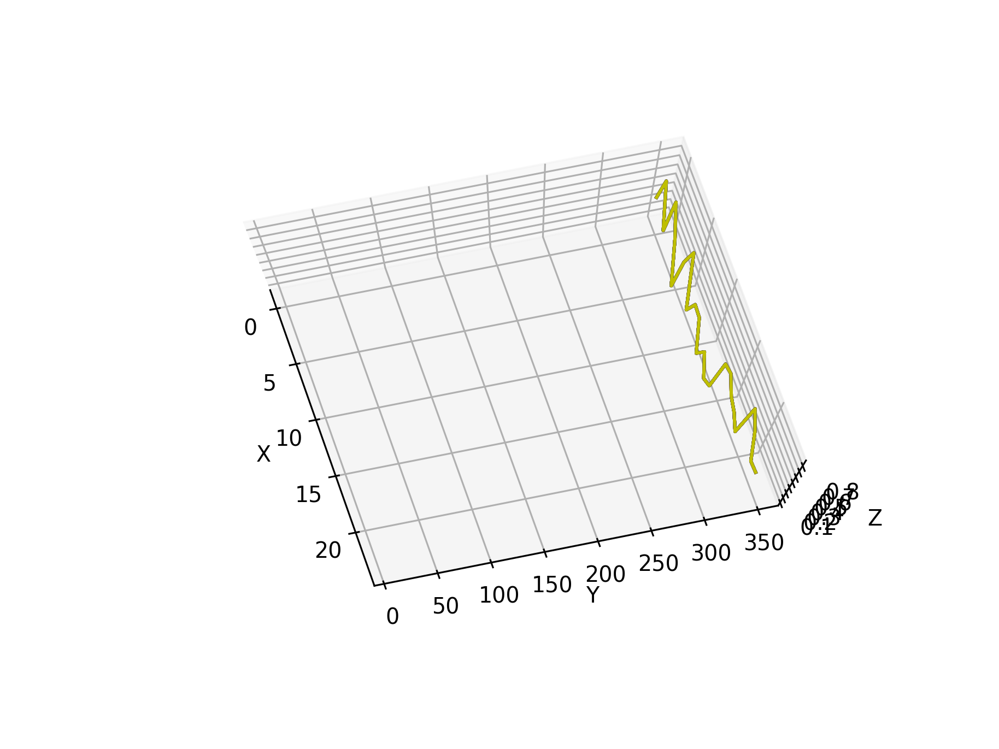

In [46]:
from mpl_toolkits.mplot3d.axes3d import Axes3D
import matplotlib.pyplot as plt
import numpy as np

# preamble
fig = plt.figure()
ax = fig.add_subplot(111, projection='3d')
cs = ['r','g','b','y','r','g','b','y','r','g','b','y']

# x axis
X = np.arange(24)

# y axis
y = np.array([15,45,75,105,135,165,195,225,255,285,315,345])
Y = np.zeros(24)

# data - plotted against z axis
Z = np.random.rand(24)

# populate figure
for step in range(0,12):
    Y[:] = y[step]
    ax.plot(X,Y,Z, color=cs[step])
#    ax.scatter(X,Y,Z, color=cs[step])

ax.set_xlabel('X')
ax.set_ylabel('Y')
ax.set_zlabel('Z')
# set initial view of plot
ax.view_init(elev=80., azim=345.)
plt.show()

In [67]:
import networkx as nx
g=nx.read_edgelist('Oregonas/oregon1_010331.txt.gz')

In [75]:
q=get_queries('DiBrain')
len(q)

423

In [71]:
nx.write_graphml(g,'Oregonas/oregon1_010331.graphml')

In [92]:
#folder='TRnets'
queries=['TRnets/Ec_Tr.graphml']#get_queries(folder)
MM=[]
ct=0
SNO={}
Mfile='Dmotifs5'
th=open(Mfile,'rb')
D5=pk.load(th,encoding='bytes')
th.close()
for m in D5:
        orbtype=m.new_vertex_property('int')
        m.vp.orbtype=orbtype
        orbtc=m.new_gp("vector<int>",val=[0,0,0])
        m.gp.orbtc=orbtc
        for v in m.vertices():
            if v.out_degree() and v.in_degree():
                m.gp.orbtc[2]+=1
                m.vp.orbtype[v]=2
            elif v.out_degree():
                m.vp.orbtype[v]=0
                m.gp.orbtc[0]+=1
            elif v.in_degree():
                m.vp.orbtype[v]=1
                m.gp.orbtc[1]+=1
for q in queries:
    th=open(q+'DAS_Dmotifs5ig','rb')
    C=cp.load(th)
    th.close()
    das=SIGMAvmDAS(C,D5)
    
    th=open(q+'A_Dmotifs5ig','rb')
    C=cp.load(th)
    th.close()
    a=SIGMAvmA(C,D5)
    g=vmtoG(C[0],C[1])
    print(g,len(C[0][-1]),len(C[0][-1])/g.num_edges())
    s=sigproA(C,D5)
    #print(s)
    th=open(q+'NO_Dmotifs5ig','rb')
    C=cp.load(th)
    th.close()
    no=SIGMAvmNO(C,D5)
    th=open(q+'DC_Dmotifs5ig','rb')
    C=cp.load(th)
    th.close()
    dc=SIGMAvmO(C,D5)
    th=open(q+'H_Dmotifs5ig','rb')
    C=cp.load(th)
    th.close()
    h=SIGMAvmH(C,D5)
    for m in C[1]:
        orbtype=m.new_vertex_property('int')
        m.vp.orbtype=orbtype
        orbtc=m.new_gp("vector<int>",val=[0,0,0])
        m.gp.orbtc=orbtc
        for v in m.vertices():
            if v.out_degree() and v.in_degree():
                m.gp.orbtc[2]+=1
                m.vp.orbtype[v]=2
            elif v.out_degree():
                m.vp.orbtype[v]=0
                m.gp.orbtc[0]+=1
            elif v.in_degree():
                m.vp.orbtype[v]=1
                m.gp.orbtc[1]+=1
    hdas=SIGMAvmDAS(C,D5)
    z=SIGMAvmZ(C,D5)
    ss=[dc,no,das,a,h,hdas,z]
    print(q,ss,ss.index(min(ss)))

<Graph object, directed, with 297 vertices and 2345 edges, at 0x7f199a78ee48> 691 0.29466950959488275
celegansneural.gml [9415.194342648147, 9574.221195301609, 9378.087381026424, 9459.955090961364, 9704.173653493875, 9499.041521140873, 9626.295389420067] 2


In [ ]:
<Graph object, directed, with 297 vertices and 2345 edges, at 0x7f1997566a20> 870 0.37100213219616207
celegansneural.gml [9425.980075738093, 9594.371656464265, 9360.647351163927, 9461.680460736312, 9707.713611452034, 9458.808627857454, 9626.295389420067] 2

A: 33720.73826219878 O: 33830.59381006288 DAS: 33806.97654939507 NO: 33752.34094057552 H: 36136.76174541056 37957.53168860501 33815.9933949517
<Graph object, directed, with 2275 vertices and 5763 edges, at 0x7f19b28b4e10> 161 0.027936838452195037


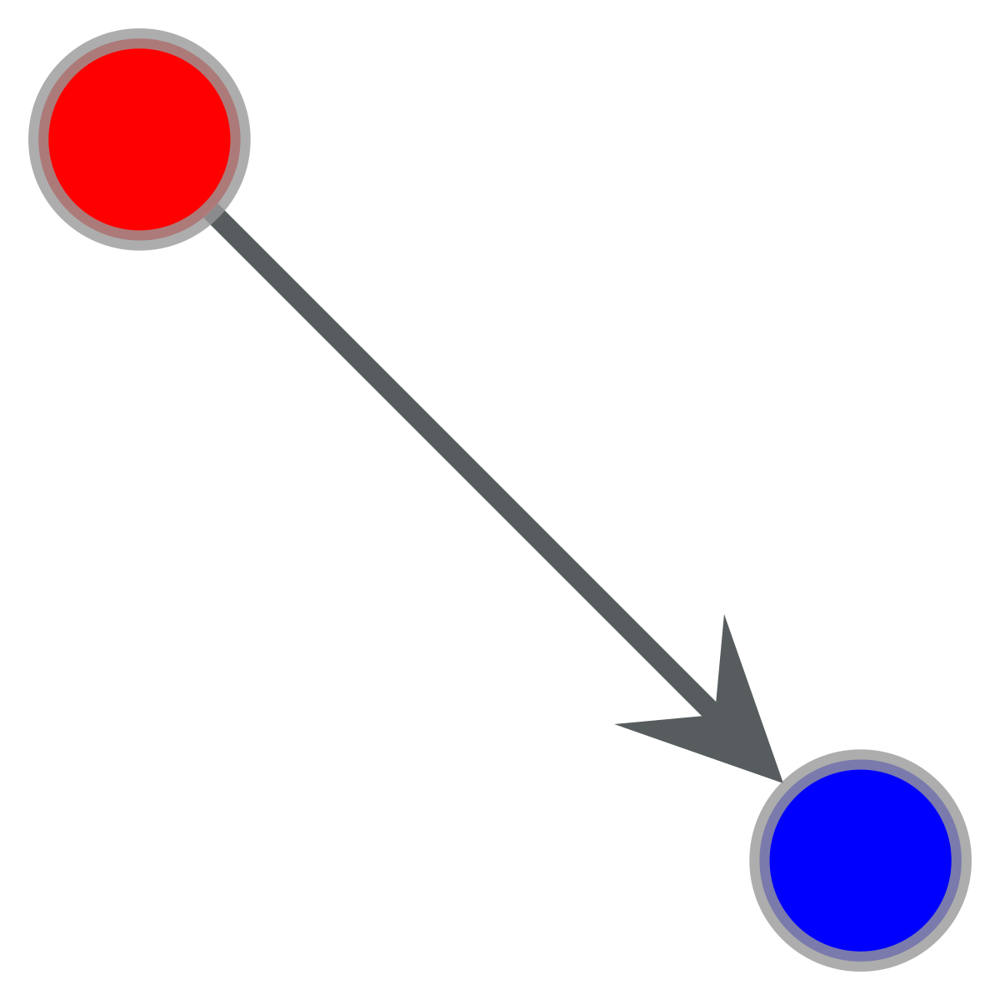

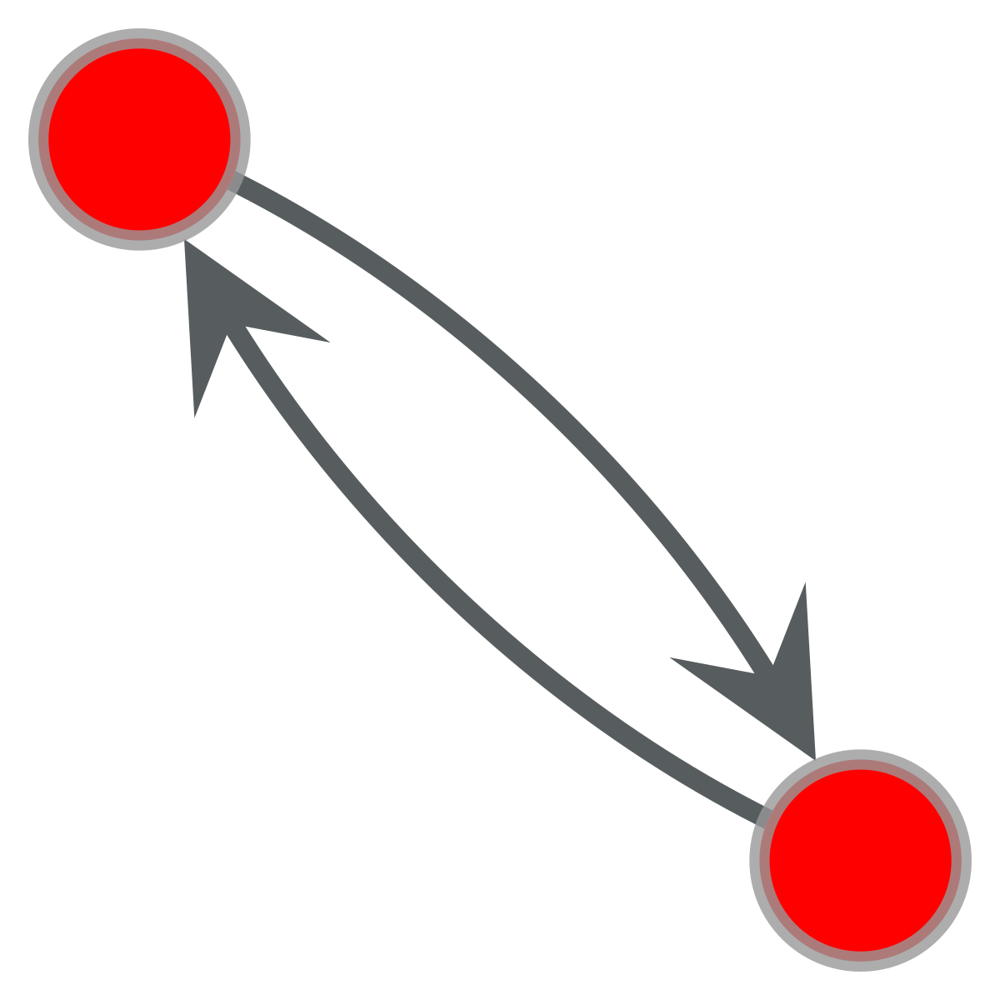

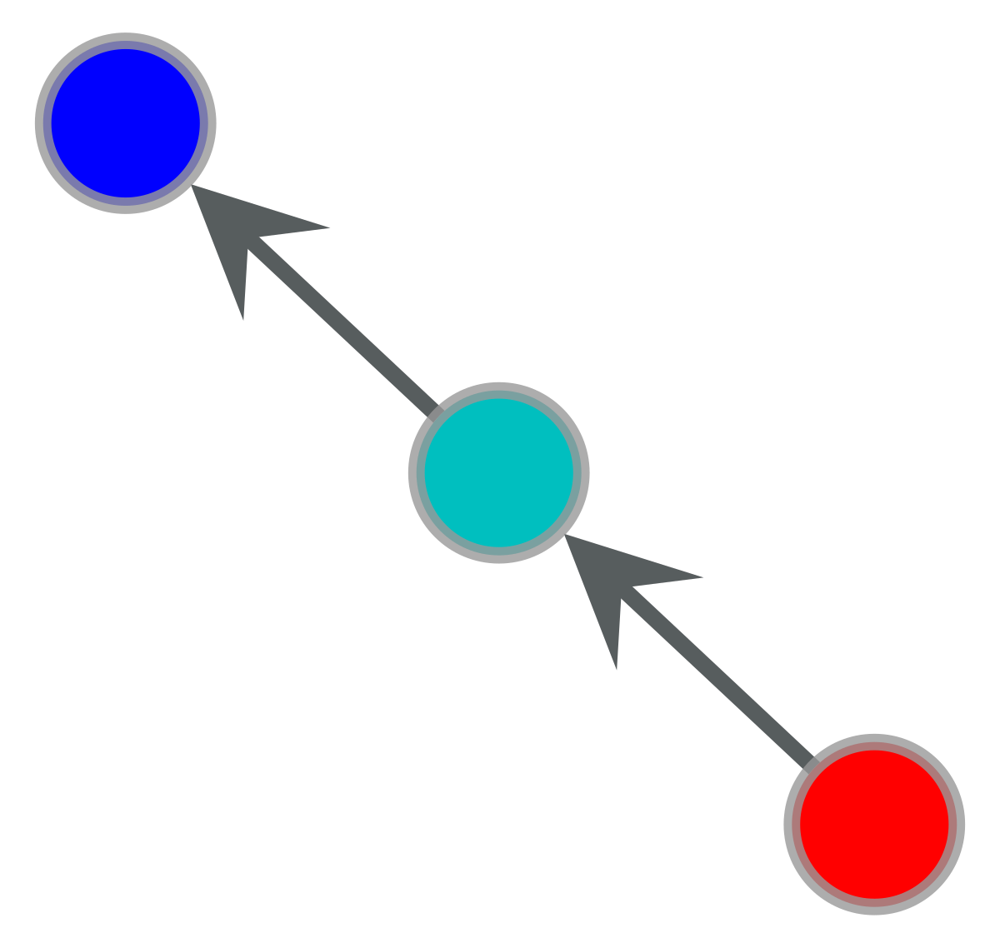

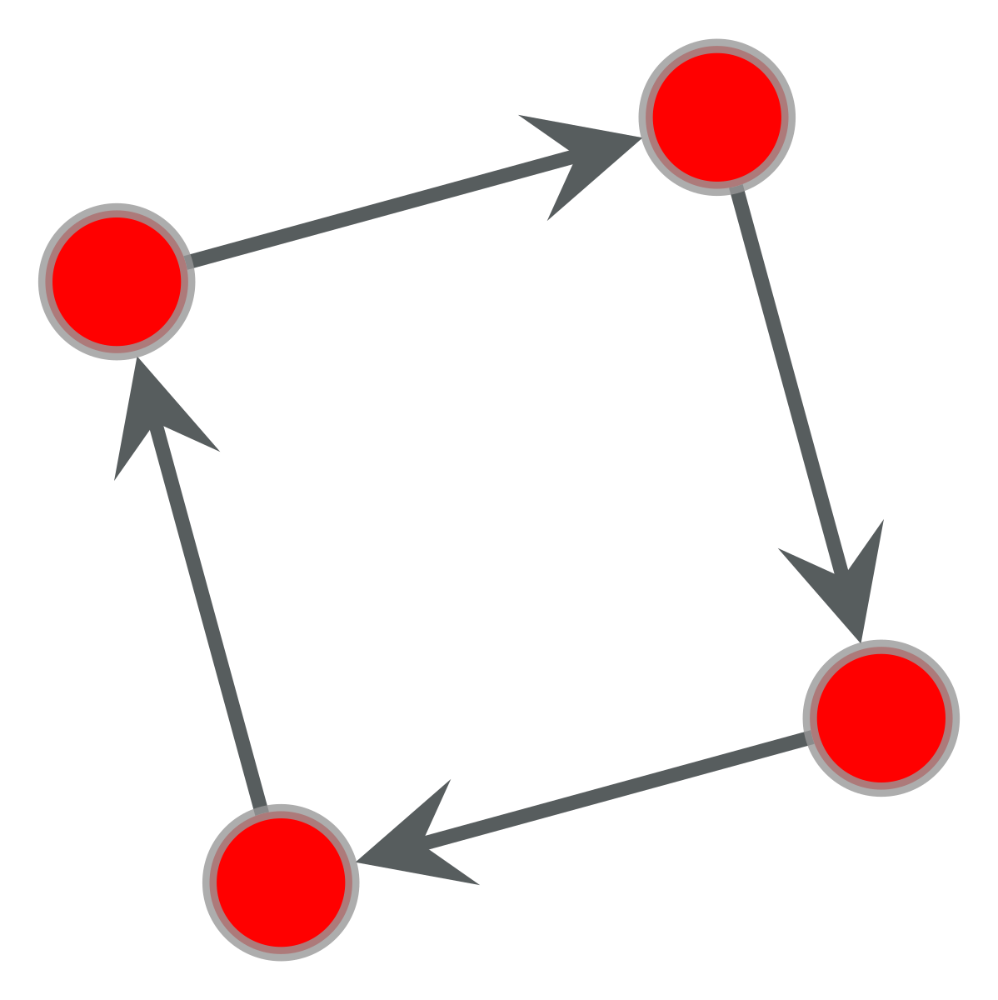

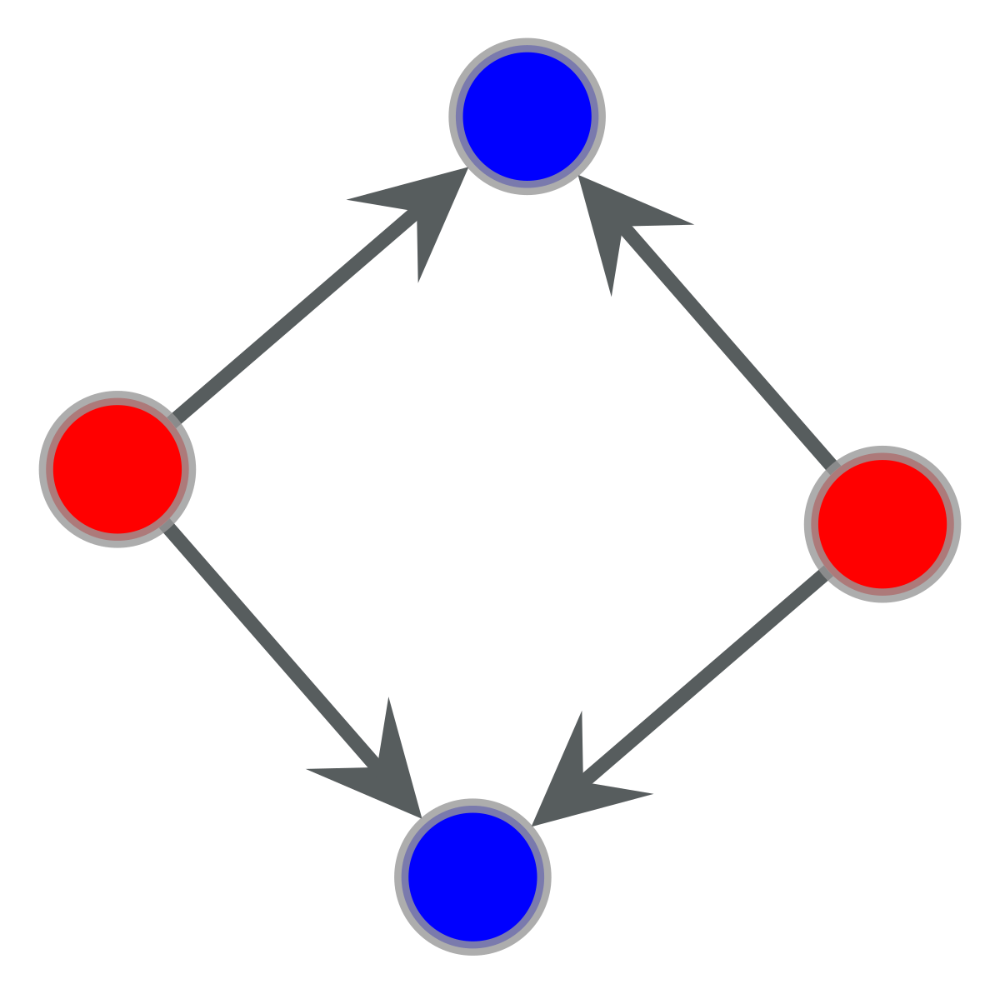

...

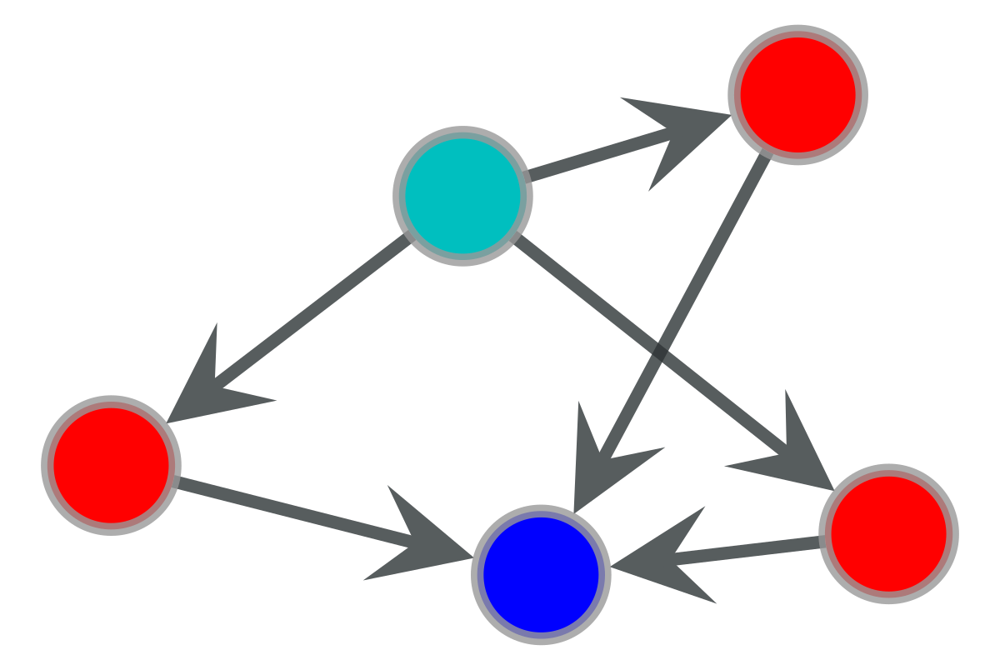

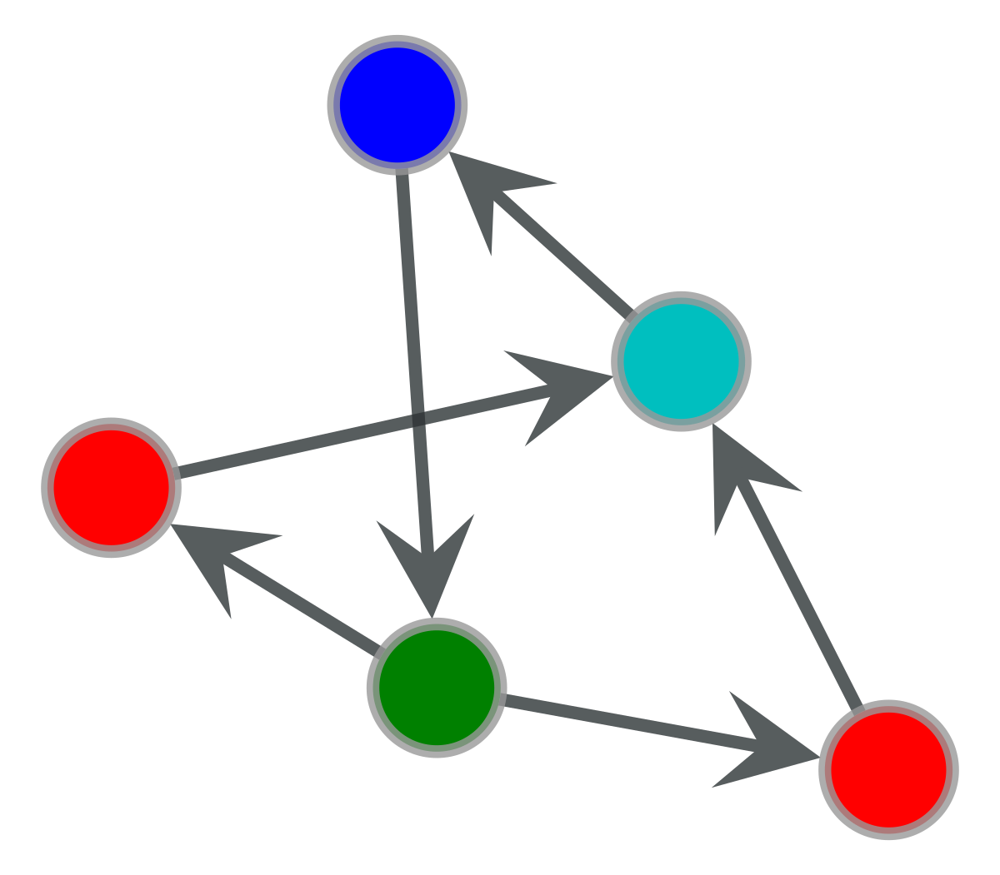

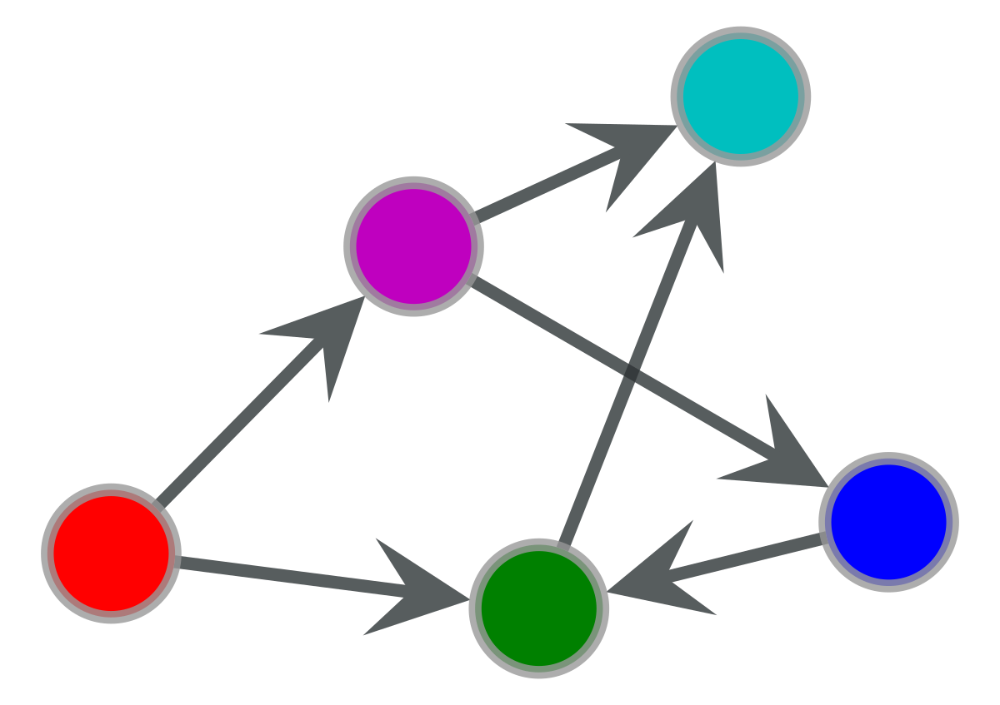

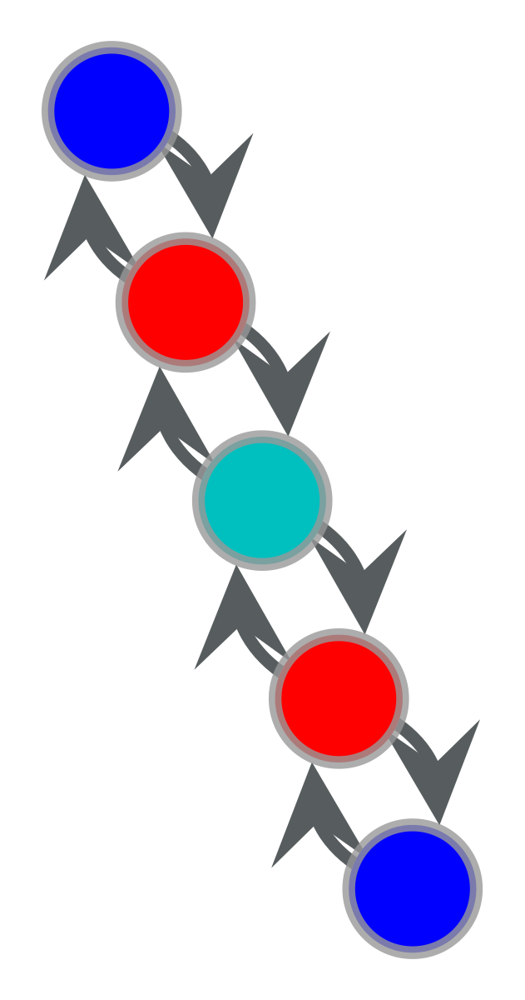

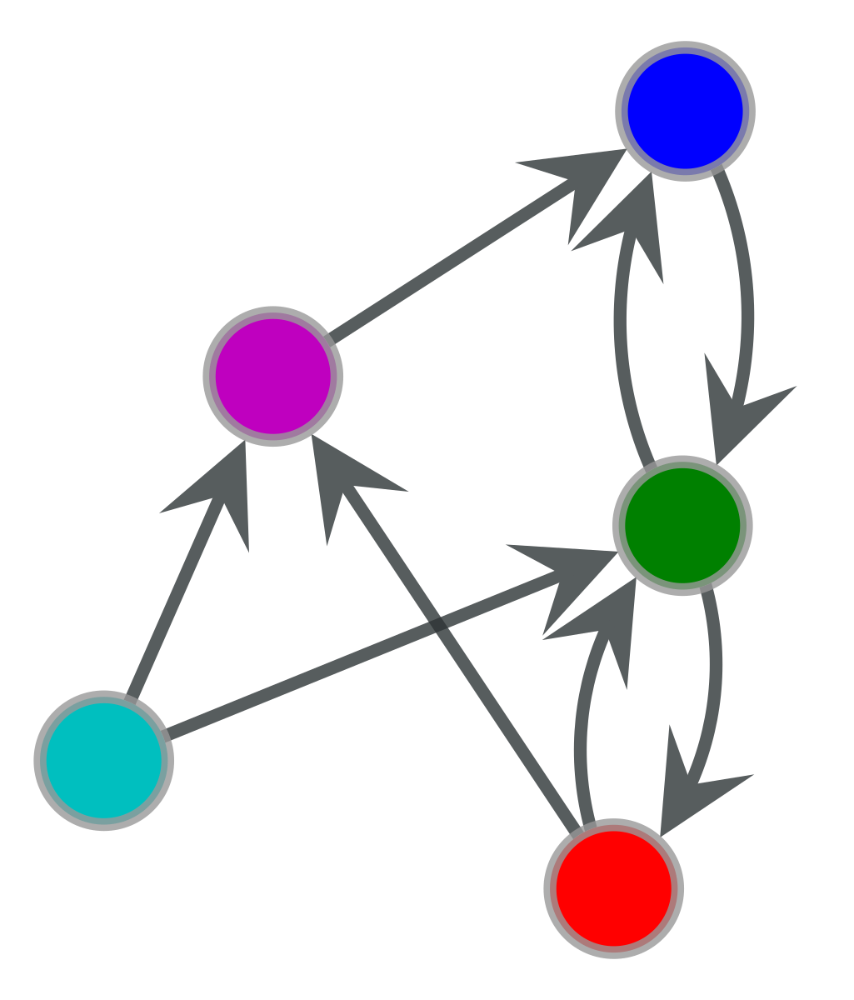

13 [161, 52, 176, 250, 6, 38, 7, 107, 364, 190, 5, 17, 3]


In [179]:
import pickle as cp
file='Meta/EC.dat.gz.gml'

th=open(file+'A_Dmotifs5ig','rb')
CA=cp.load(th)
th.close()
for m in CA[1]:
        orbtype=m.new_vertex_property('int')
        m.vp.orbtype=orbtype
        orbtc=m.new_gp("vector<int>",val=[0,0,0])
        m.gp.orbtc=orbtc
        for v in m.vertices():
            if v.out_degree() and v.in_degree():
                m.gp.orbtc[2]+=1
                m.vp.orbtype[v]=2
            elif v.out_degree():
                m.vp.orbtype[v]=0
                m.gp.orbtc[0]+=1
            elif v.in_degree():
                m.vp.orbtype[v]=1
                m.gp.orbtc[1]+=1
th=open(file+'DC_Dmotifs5ig','rb')
CO=cp.load(th)
th.close()
th=open(file+'DAS_Dmotifs5ig','rb')
CDAS=cp.load(th)
th.close()
th=open(file+'NO_Dmotifs5ig','rb')
CNO=cp.load(th)
th.close()
th=open(file+'H_Dmotifs5ig','rb')
CH=cp.load(th)
th.close()
f=open('Dmotifs5','rb')
Ms=pk.load(f,encoding='bytes')
f.close()
print('A:',SIGMAvmA(CA,Ms),'O:',SIGMAvmO(CO,Ms),'DAS:',SIGMAvmDAS(CDAS,Ms),'NO:',SIGMAvmNO(CNO,Ms),'H:',SIGMAvmH(CH,Ms),SIGMAvmZ(CA,Ms),SIGMAvmDAS(CA,Ms))
C=CA
g=vmtoG(C[0],C[1])
print(g,len(C[0][-1]),len(C[0][-1])/g.num_edges())
folder='Celegans-MD5ADS'
#os.mkdir(folder)

nm={C[1][i]:len(C[0][i]) for i in range(len(C[0]))}
C[1].sort(key=lambda d: d.num_edges())
i=0
for m in C[1]:
    colors=['r','b','c','g','m','y','k']
    vh=m.new_vp('int',m.gp.orbmem)
    m.vp.vh=vh
    vc=m.new_vp('string')
    m.vp.vc=vc
    t=0
    for v in m.vertices():
        m.vp.vc[v]=colors[m.gp.orbmem[t]]
        t+=1  
    graph_draw(m,vertex_fill_color=m.vp.vc,inline=True,output_size=(50,50),output=folder+'/M'+str(i)+'.pdf')
    graph_draw(m,vertex_fill_color=m.vp.vc,inline=True)
    i+=1
print(len(C[1]),[nm[m] for m in C[1]])

A: 11373.357111239377 O: 11710.994314822783 NO: 11449.77943584452 H: 11692.798201997084 18916.39257827709
<Graph object, undirected, with 1589 vertices and 2742 edges, at 0x7f19b304b080> 385 0.14040846097738877


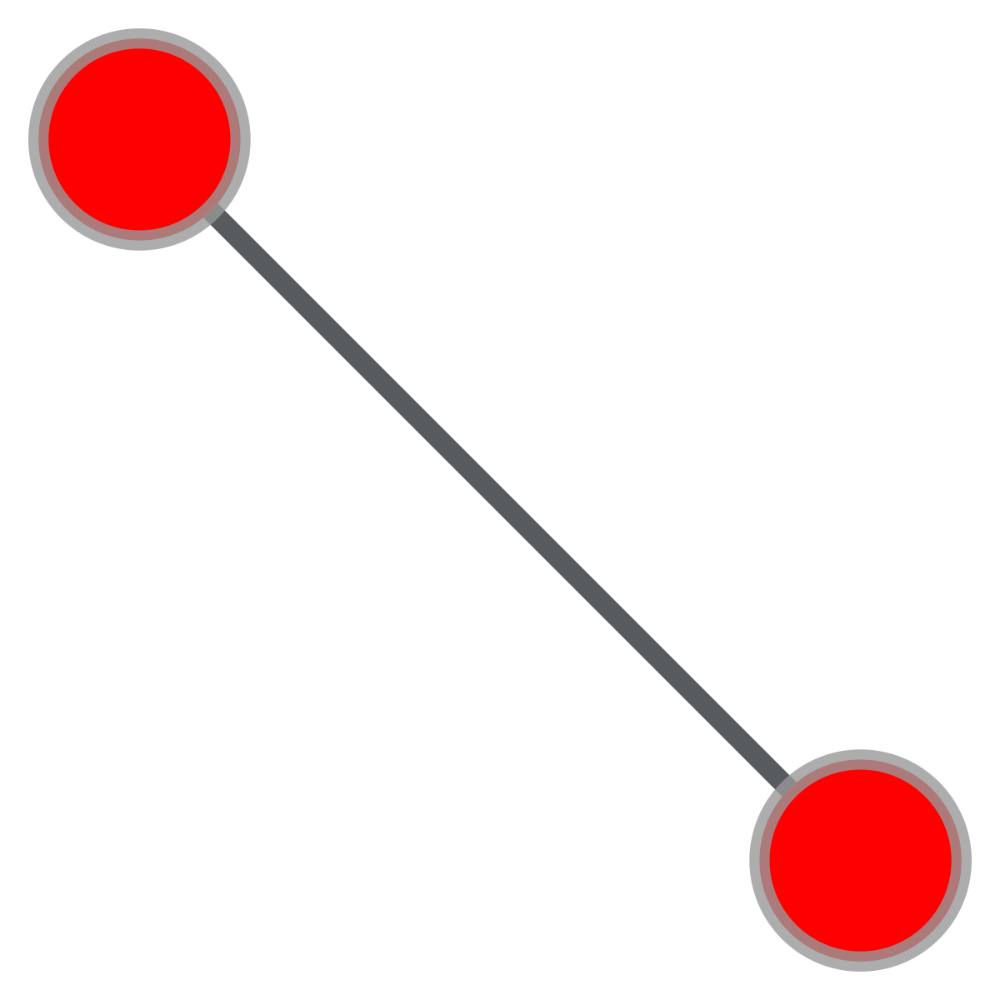

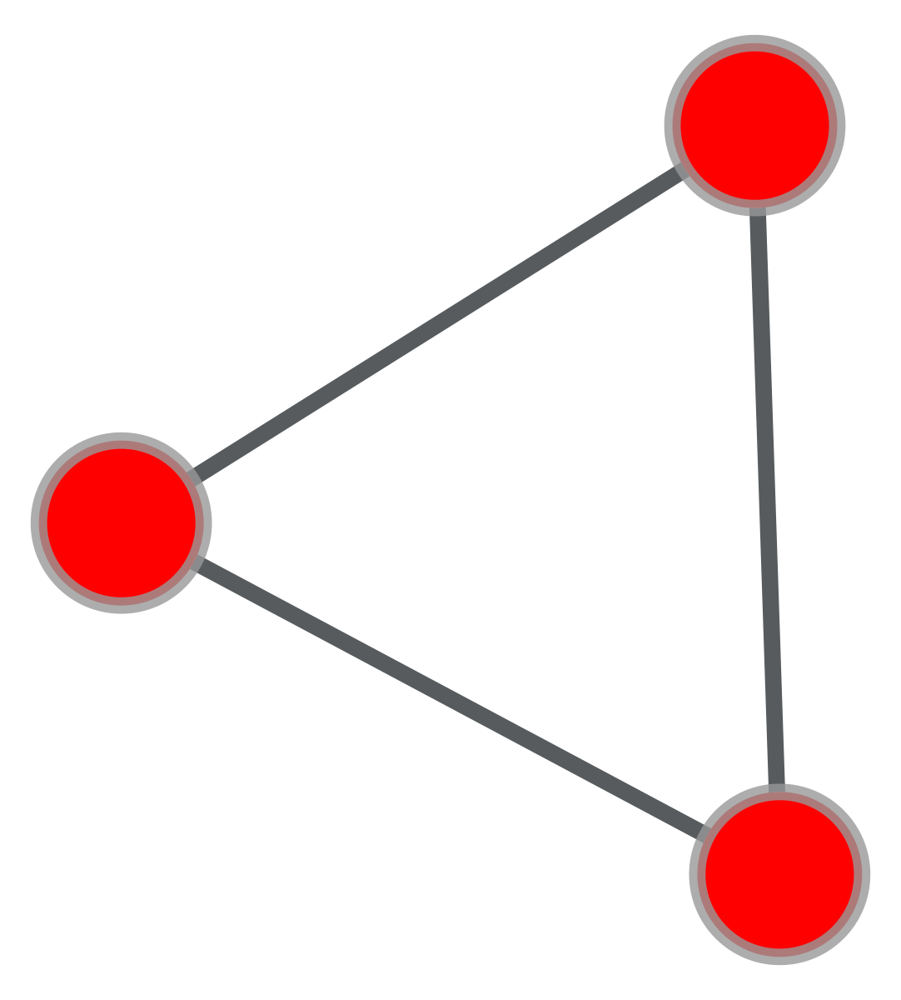

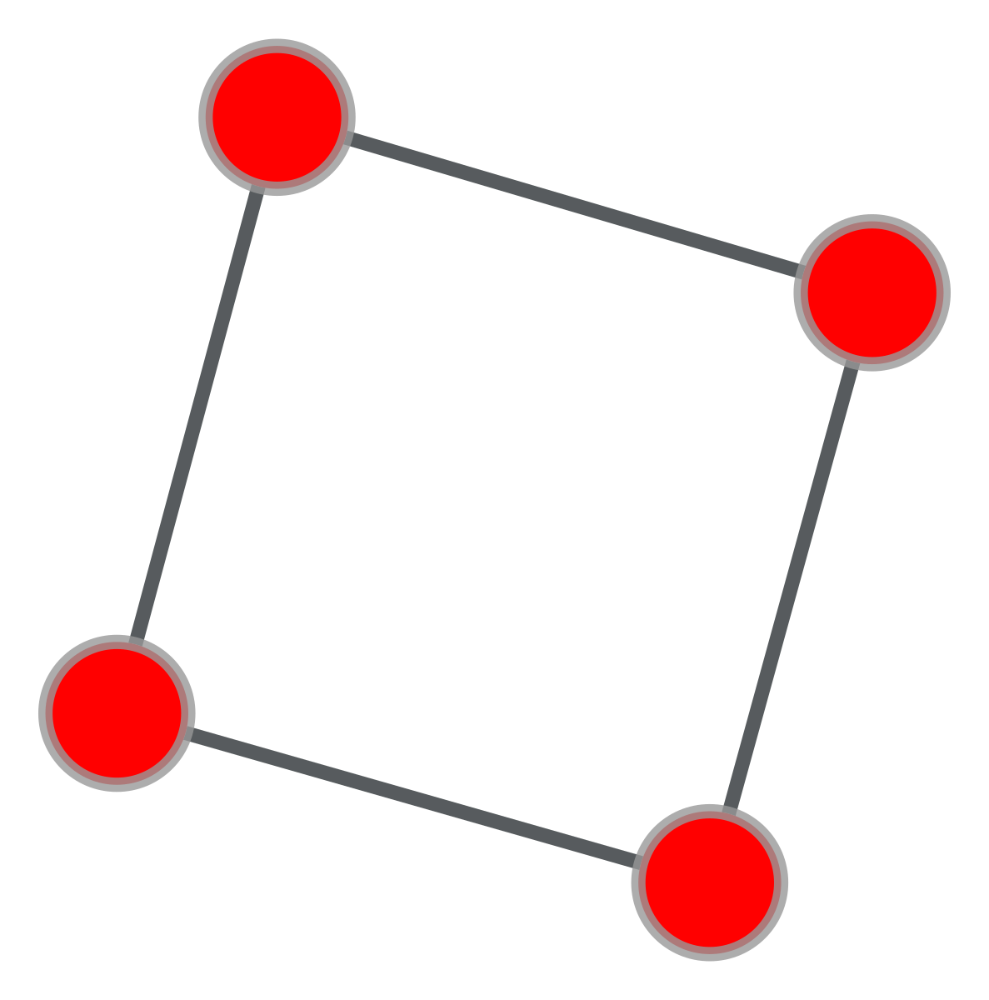

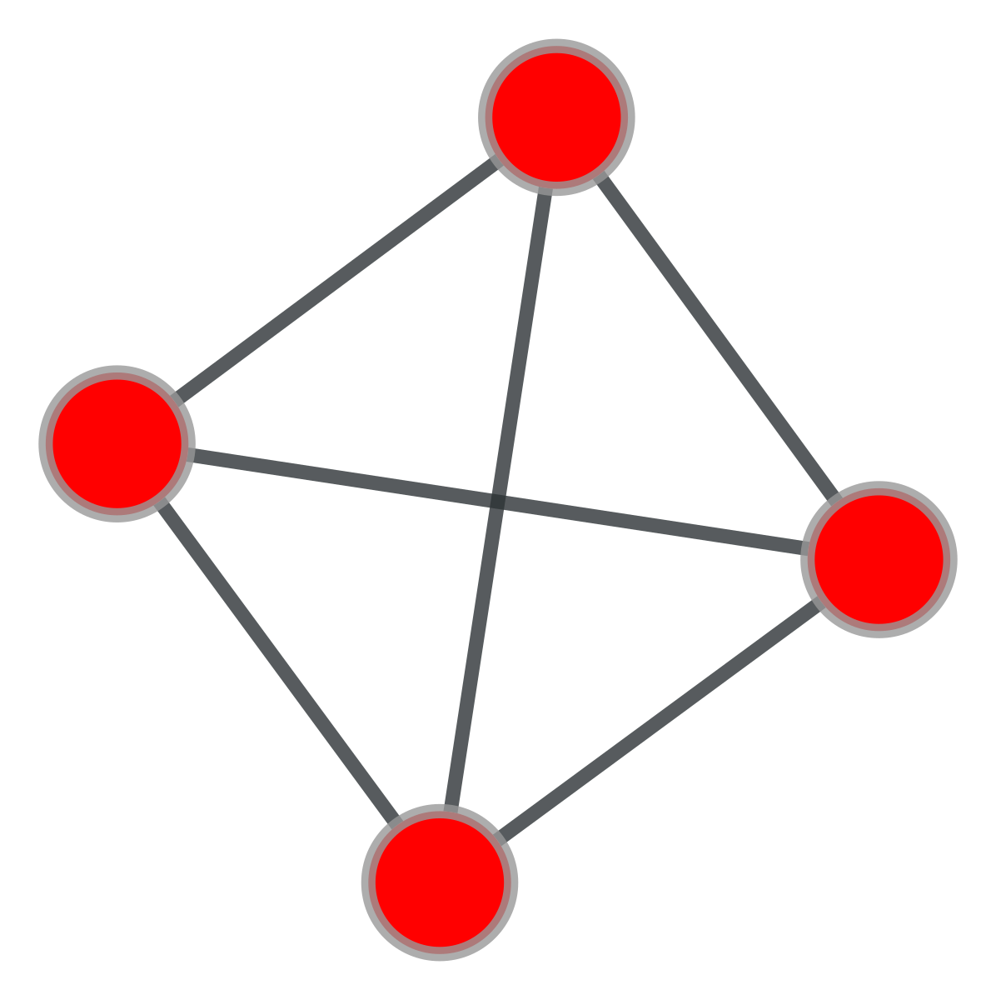

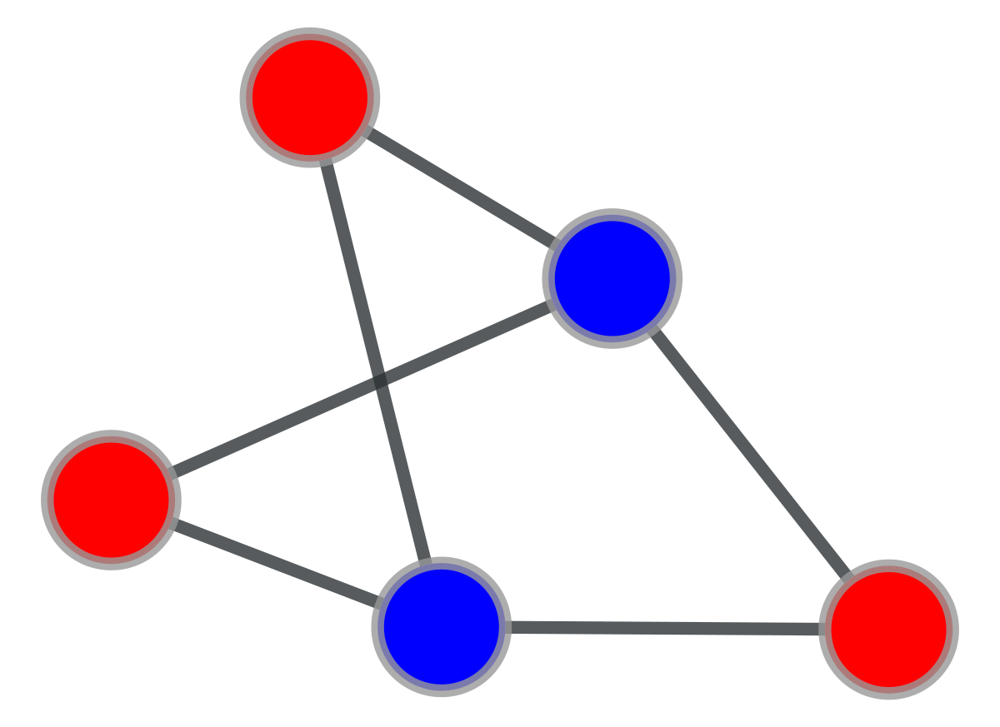

...

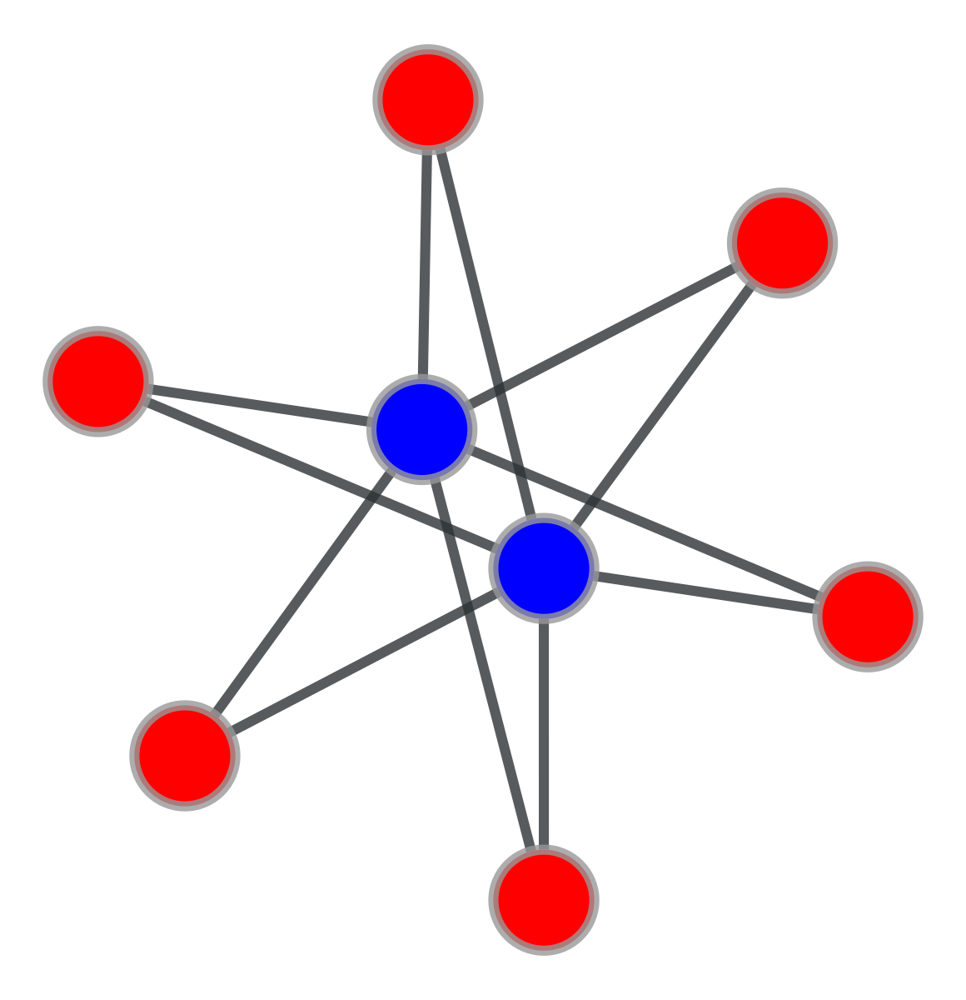

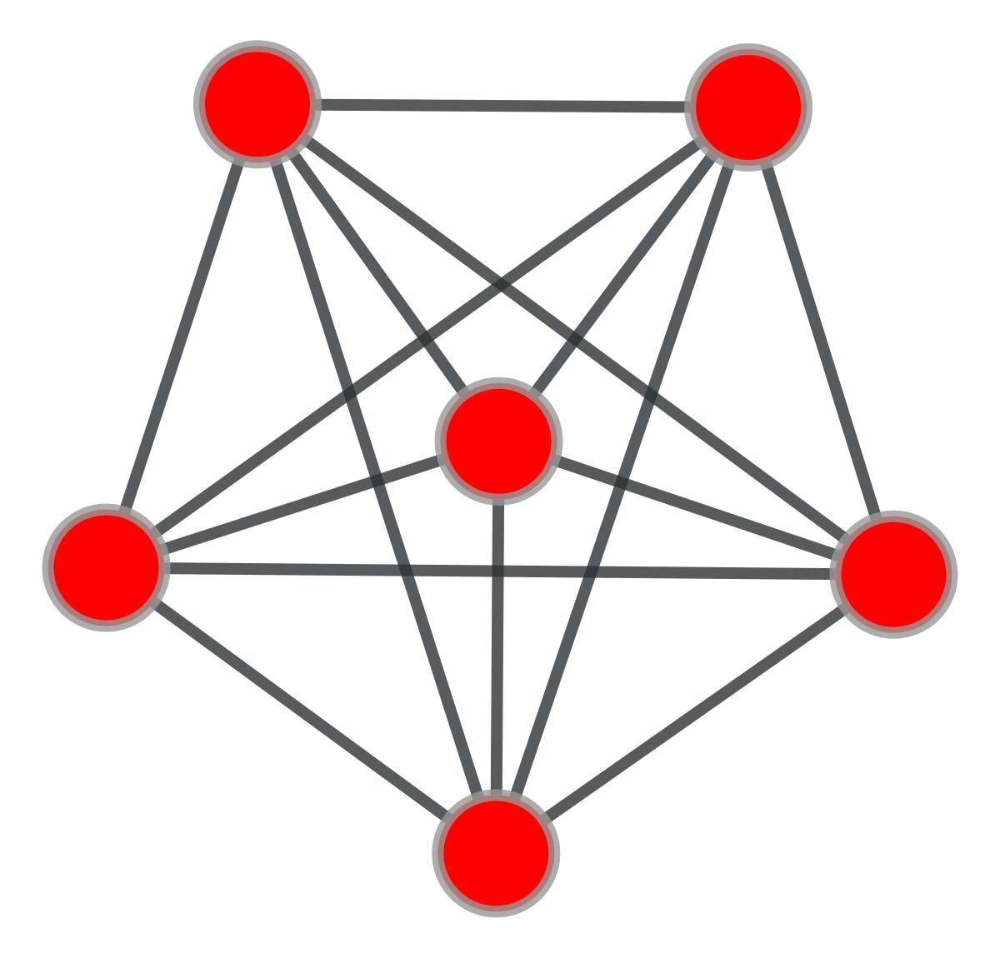

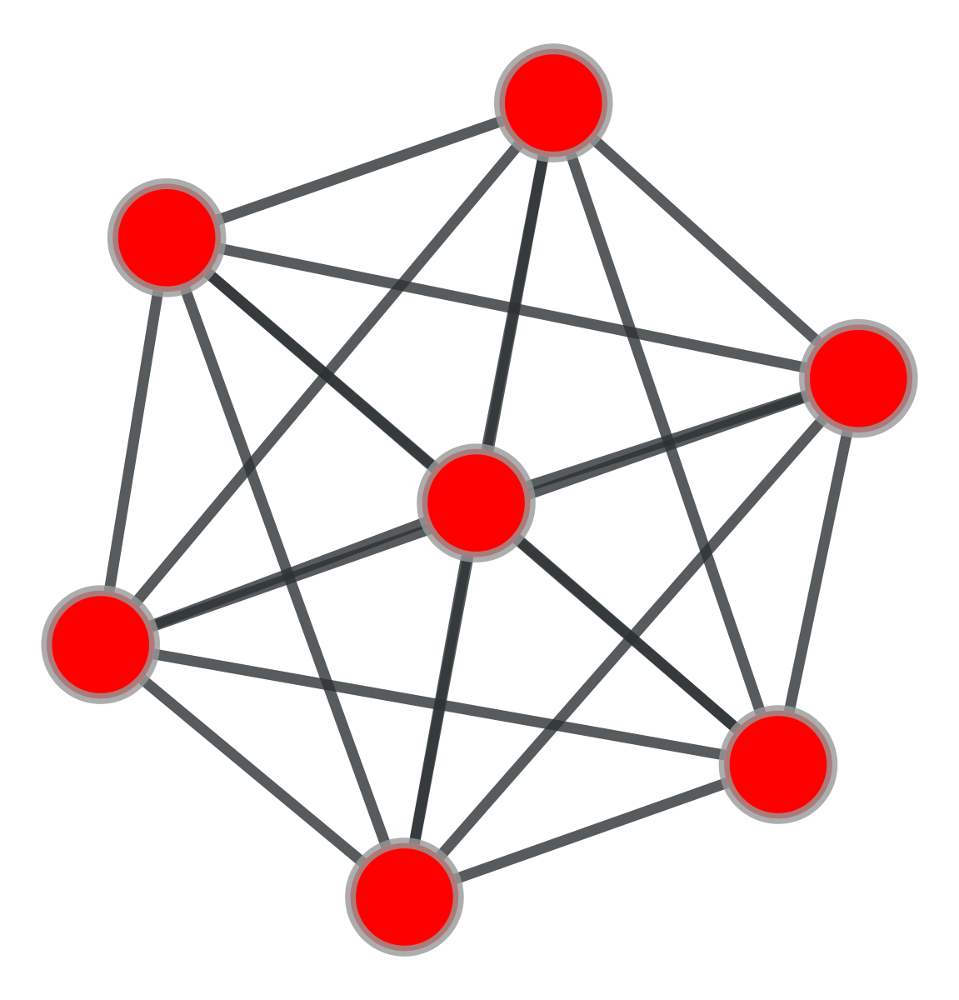

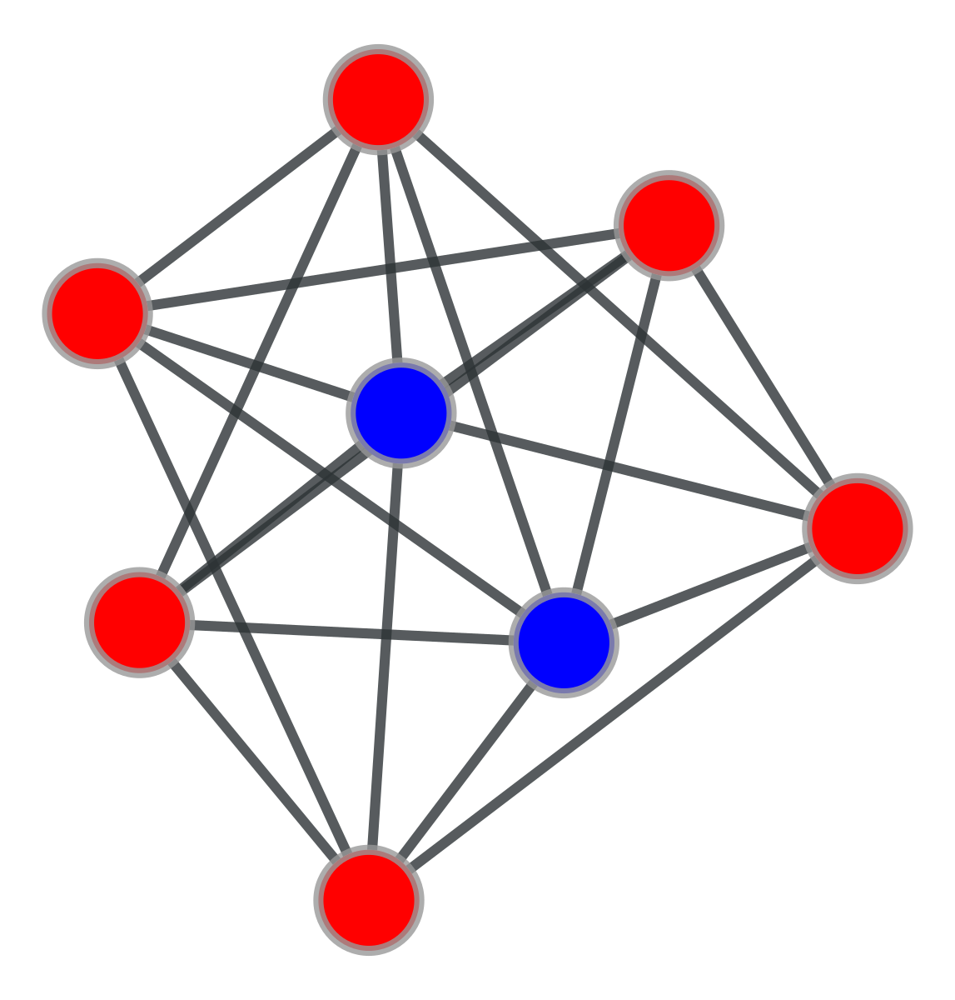

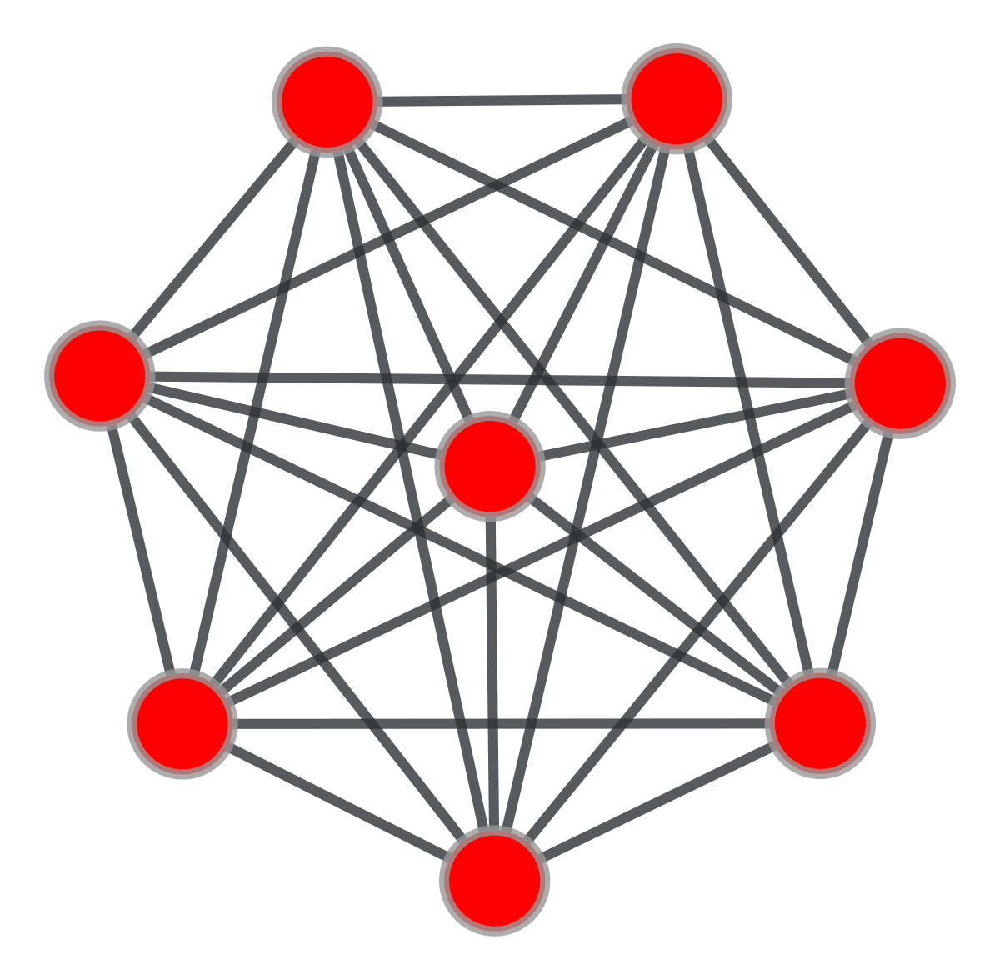

15 [385, 149, 5, 74, 4, 2, 44, 3, 5, 2, 5, 13, 4, 5, 15]


In [158]:
th=open('','rb')
C=cp.load(th)
th.close()
f=open('Umotifs8','rb')
Ms=pk.load(f,encoding='bytes')
f.close()
print('A:',SIGMAvmA(C,Ms),'O:',SIGMAvmO(C,Ms),'NO:',SIGMAvmNO(C,Ms),'H:',SIGMAvmH(C,Ms),SIGMAvmZ(C,Ms))

g=vmtoG(C[0],C[1])
print(g,len(C[0][-1]),len(C[0][-1])/g.num_edges())
folder='Netsci-U8A'
os.mkdir(folder)

nm={C[1][i]:len(C[0][i]) for i in range(len(C[0]))}
C[1].sort(key=lambda d: d.num_edges())
i=0
for m in C[1]:
    colors=['r','b','c','g','m','y','k']
    vh=m.new_vp('int',m.gp.orbmem)
    m.vp.vh=vh
    vc=m.new_vp('string')
    m.vp.vc=vc
    t=0
    for v in m.vertices():
        m.vp.vc[v]=colors[m.gp.orbmem[t]]
        t+=1  
    graph_draw(m,vertex_fill_color=m.vp.vc,inline=True,output_size=(50,50),output=folder+'/M'+str(i)+'.pdf')
    graph_draw(m,vertex_fill_color=m.vp.vc,inline=True)
    i+=1
print(len(C[1]),[nm[m] for m in C[1]])

In [159]:
385/2742


0.14040846097738877

A: 9461.680460736312 O: 9425.980075738093 DAS: 9348.630882532985 NO: 9594.371656464265 H: 9669.428118104493 9626.295389420067
<Graph object, directed, with 297 vertices and 2345 edges, at 0x7f1999ef7eb8> 1556 0.6635394456289979


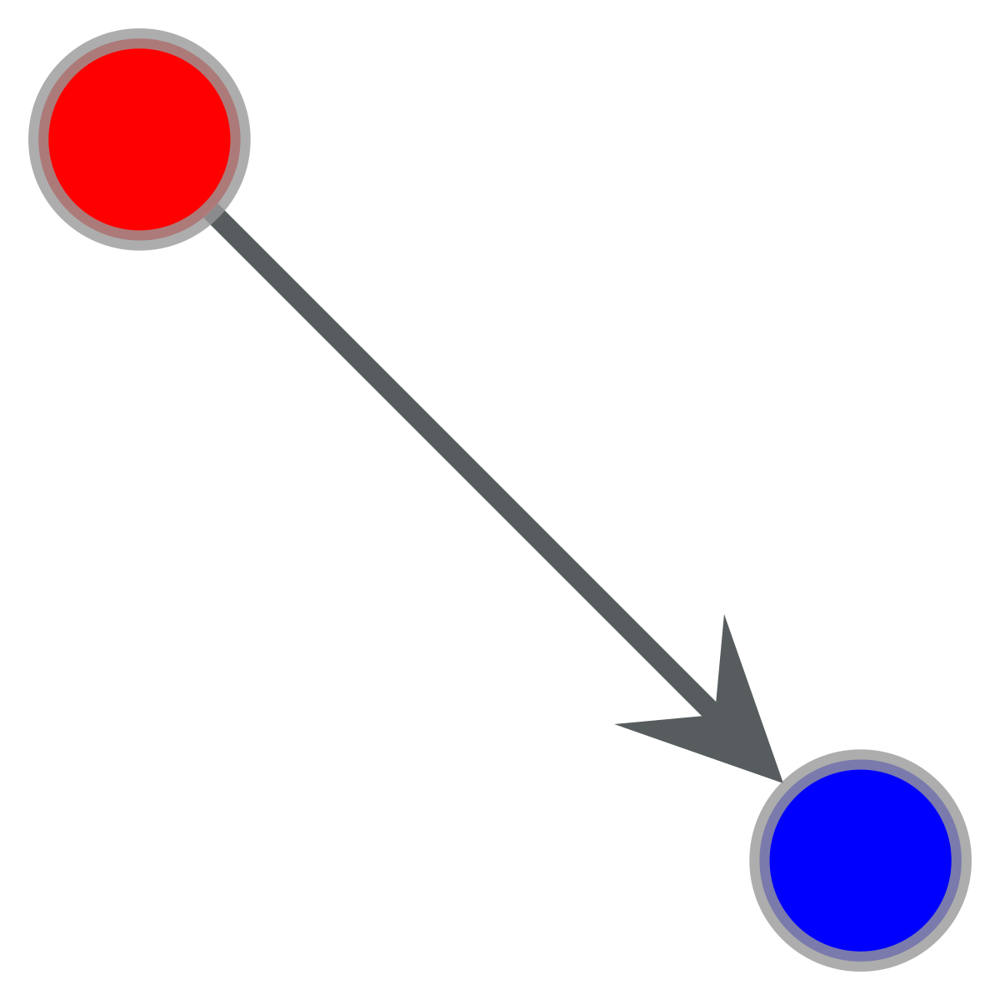

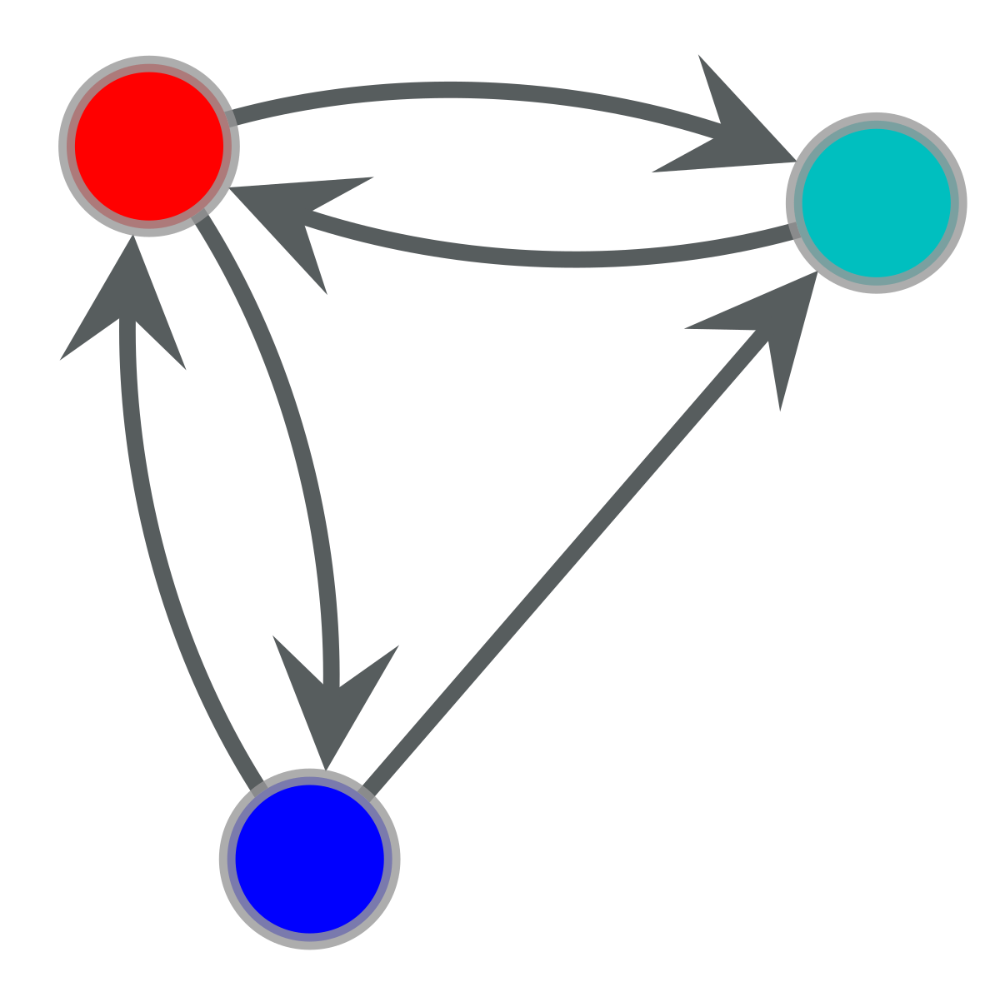

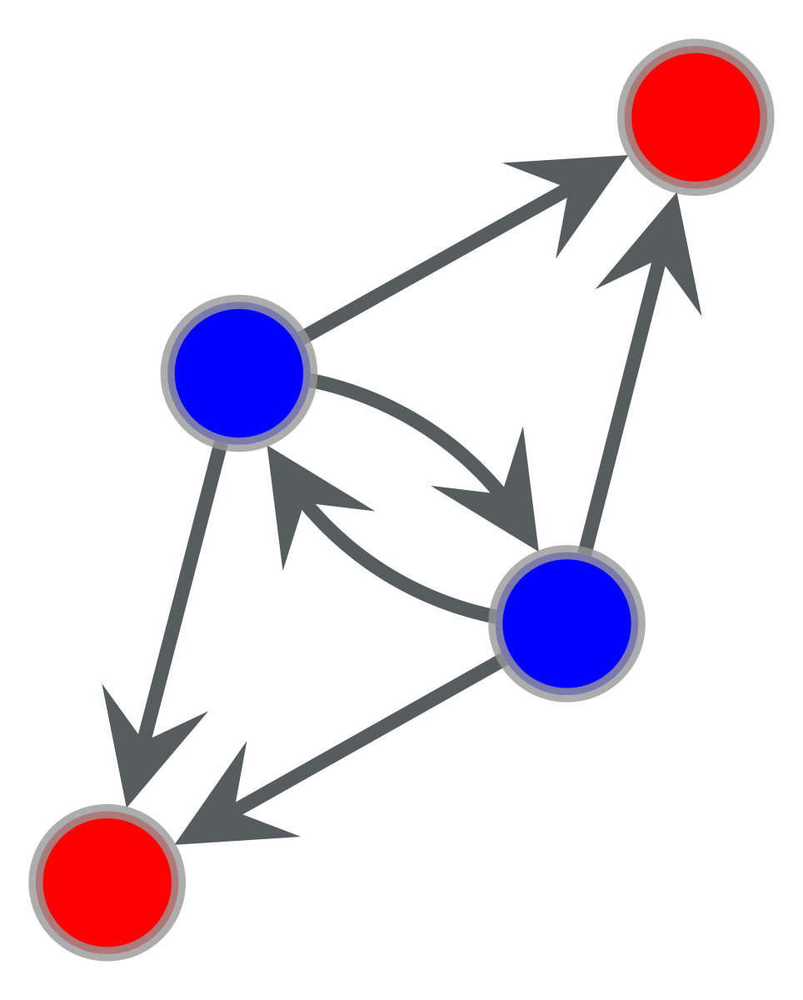

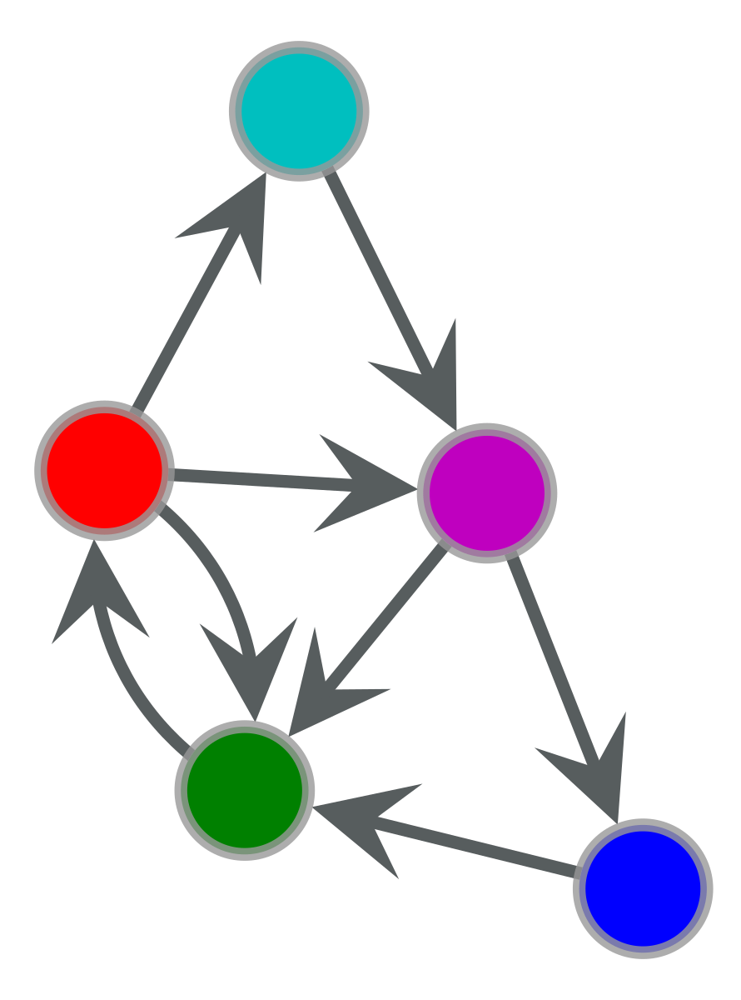

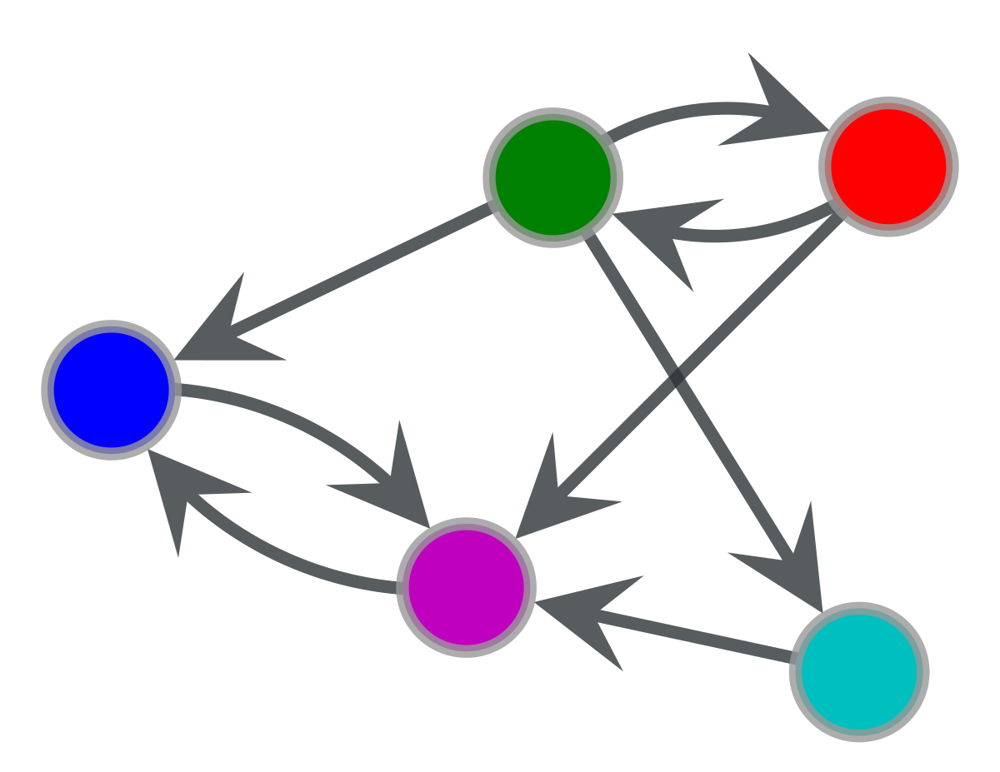

...

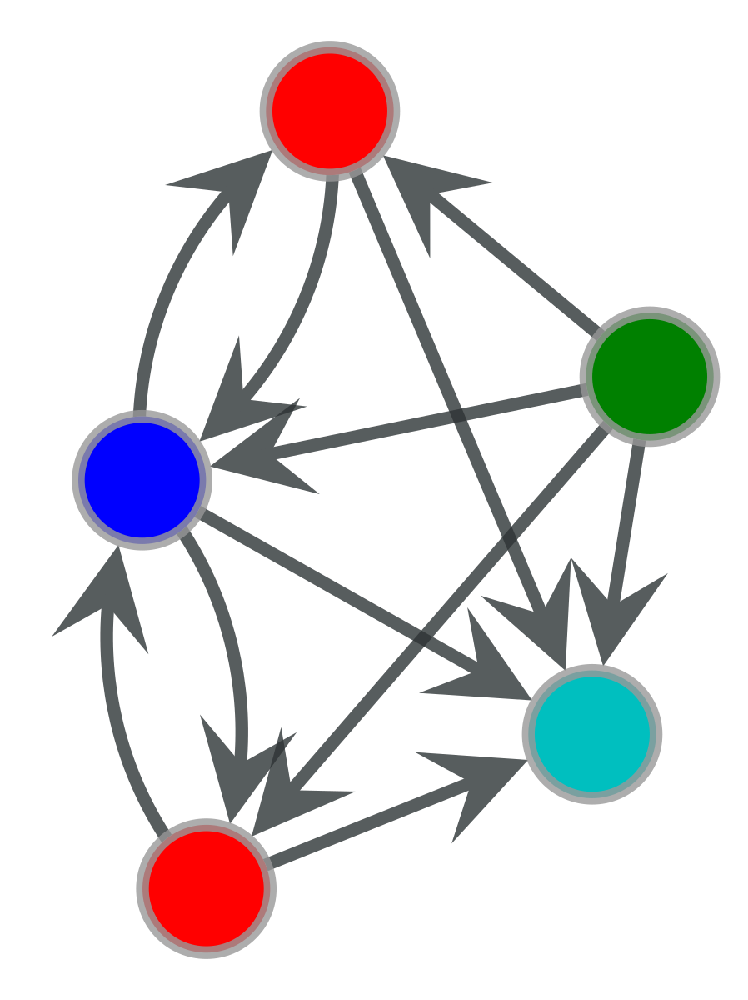

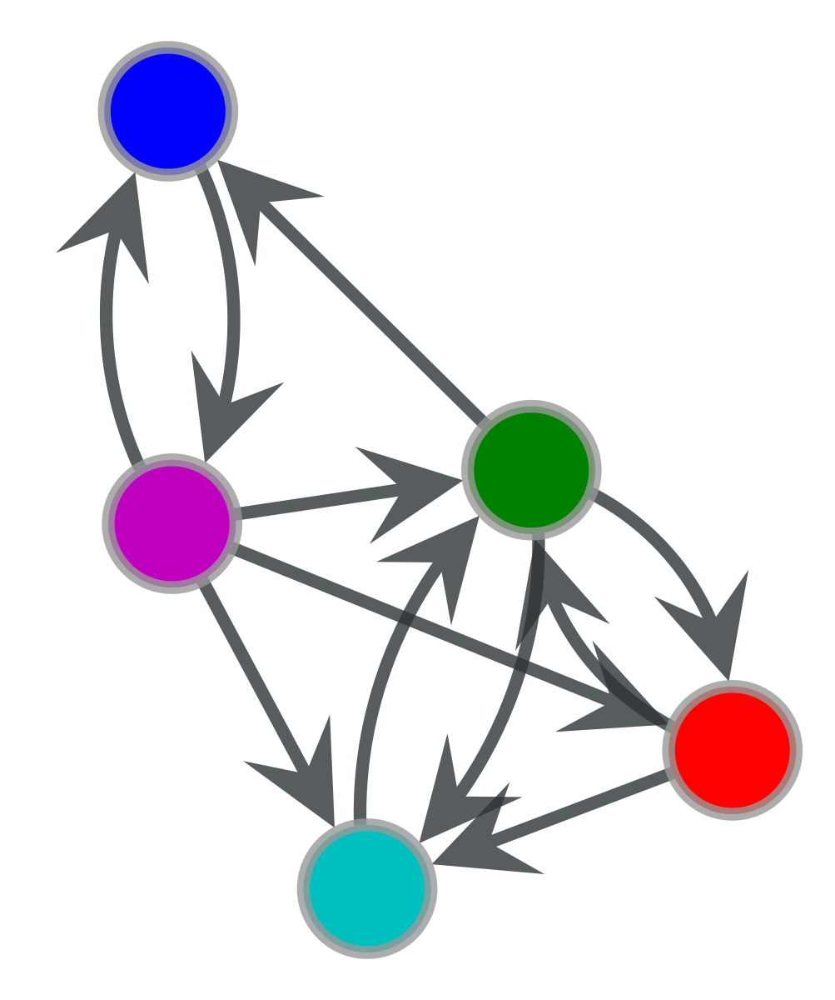

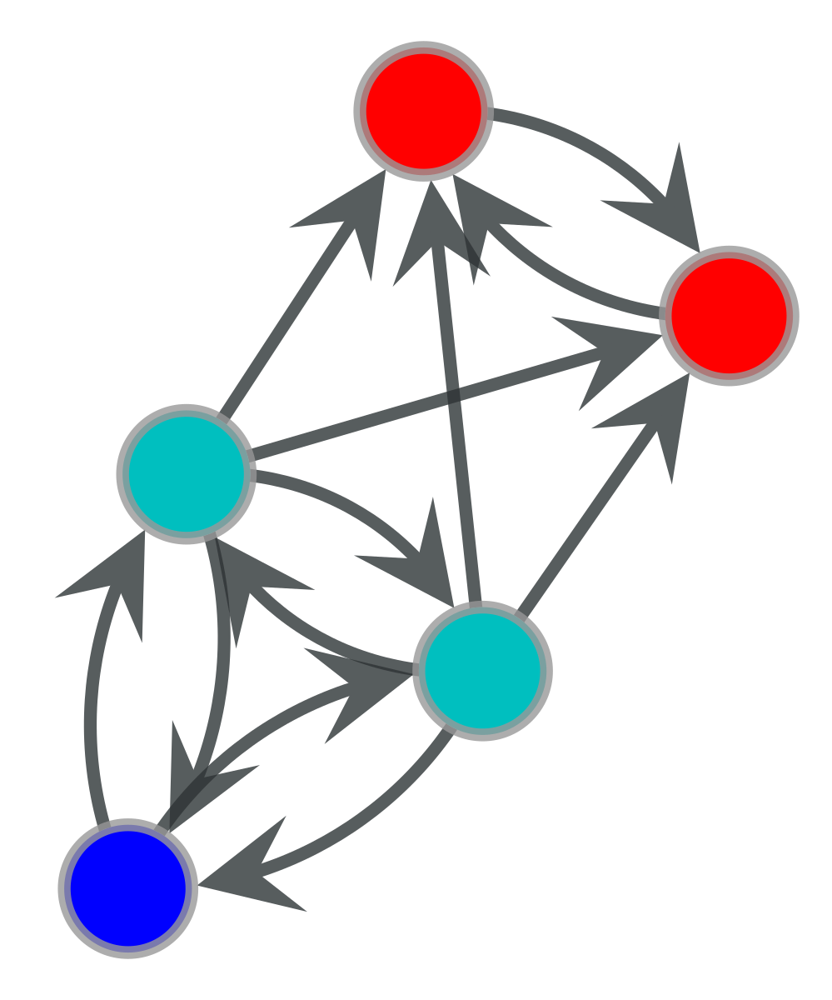

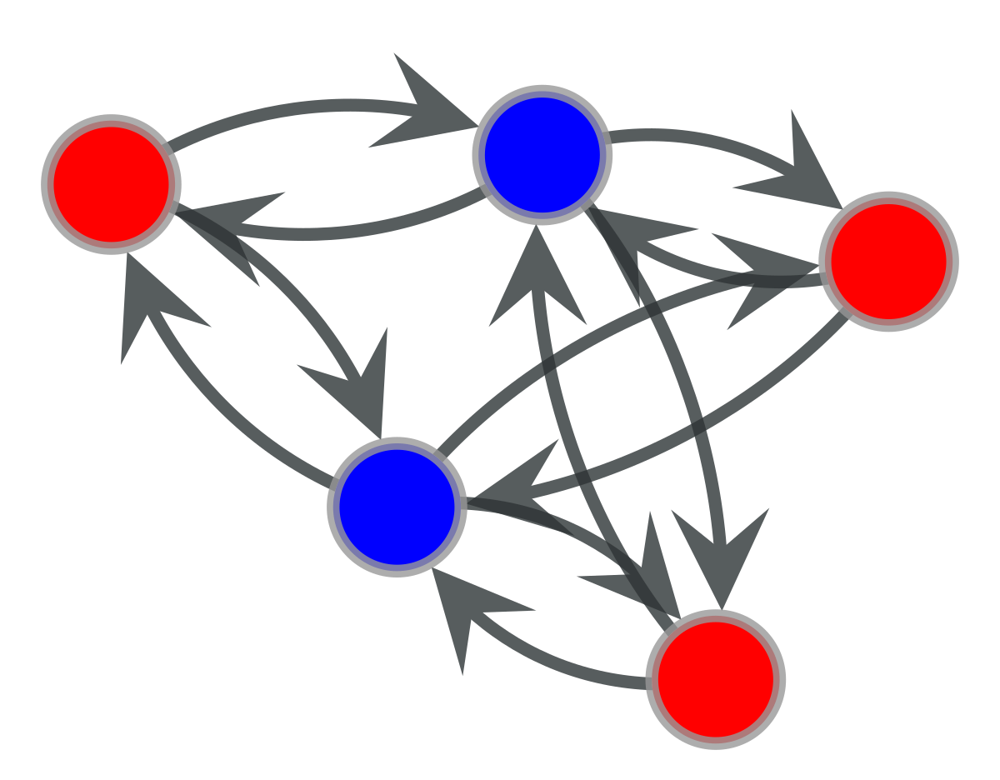

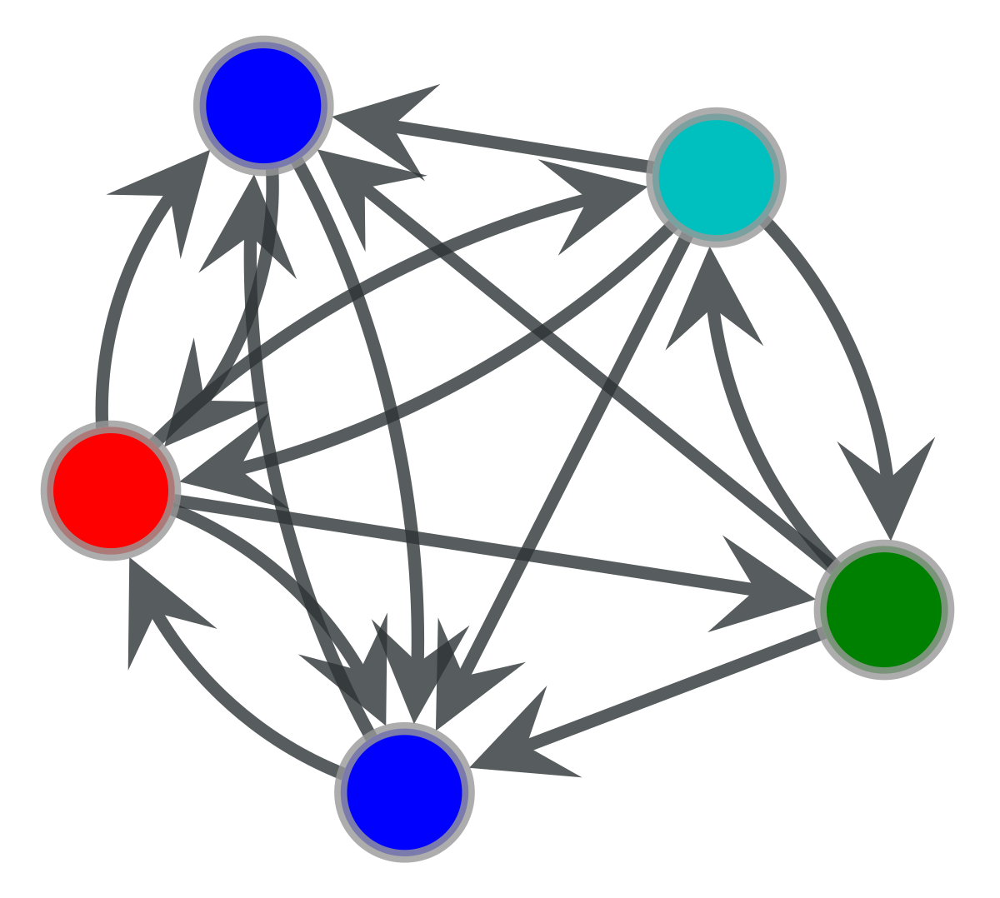

17 [1556, 6, 15, 5, 4, 3, 2, 9, 5, 2, 6, 12, 11, 2, 2, 2, 2]


In [164]:
import pickle as cp
file='celegansneural.gml'

th=open(file+'A_Dmotifs5DS','rb')
CA=cp.load(th)
th.close()
th=open(file+'DC_Dmotifs5DS','rb')
CO=cp.load(th)
th.close()
th=open(file+'DAS_BDmotifs5DS','rb')
CDAS=cp.load(th)
th.close()
th=open(file+'NO_Dmotifs5DS','rb')
CNO=cp.load(th)
th.close()
th=open(file+'H_Dmotifs5DS','rb')
CH=cp.load(th)
th.close()
f=open('Dmotifs5','rb')
Ms=pk.load(f,encoding='bytes')
f.close()
print('A:',SIGMAvmA(CA,Ms),'O:',SIGMAvmO(CO,Ms),'DAS:',SIGMAvmDAS(CDAS,Ms),'NO:',SIGMAvmNO(CNO,Ms),'H:',SIGMAvmH(CH,Ms),SIGMAvmZ(CA,Ms))
C=CDAS
g=vmtoG(C[0],C[1])
print(g,len(C[0][-1]),len(C[0][-1])/g.num_edges())
folder='Celegans-BD5DASDS'
os.mkdir(folder)

nm={C[1][i]:len(C[0][i]) for i in range(len(C[0]))}
C[1].sort(key=lambda d: d.num_edges())
i=0
for m in C[1]:
    colors=['r','b','c','g','m','y','k']
    vh=m.new_vp('int',m.gp.orbmem)
    m.vp.vh=vh
    vc=m.new_vp('string')
    m.vp.vc=vc
    t=0
    for v in m.vertices():
        m.vp.vc[v]=colors[m.gp.orbmem[t]]
        t+=1  
    graph_draw(m,vertex_fill_color=m.vp.vc,inline=True,output_size=(50,50),output=folder+'/M'+str(i)+'.pdf')
    graph_draw(m,vertex_fill_color=m.vp.vc,inline=True)
    i+=1
print(len(C[1]),[nm[m] for m in C[1]])